# Importing and Defining Common Functions

## Importing

In [1]:
"""
@author: Tan Nguyen & Matt Bezdek
"""

import pickle as pkl
import pandas as pd
import numpy as np
import scipy.stats as stats
from sklearn.metrics import adjusted_mutual_info_score

import glob
import os
import sys
from joblib import Parallel, delayed
import random
from glob import glob
from copy import deepcopy

from copy import deepcopy
from tqdm import tqdm
from random import shuffle
import traceback

import cv2
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly as py
import plotly.graph_objs as go
from plotly.subplots import make_subplots
py.offline.init_notebook_mode(connected = True)

from utils import get_point_biserial, get_binned_prediction, SegmentationVideo
from typing import List, Dict

## Global Variables

In [ ]:
# global variables
colors = ["lightseagreen", "mediumpurple", "goldenrod", 'yellowgreen', 
          'cornflowerblue', 'darkred', 'bisque', 'black', 'blanchedalmond',
         'aliceblue', 'antiquewhite', 'aqua', 'aquamarine',
          'blue', 'blueviolet', 'brown', 'burlywood', 'cadetblue',
          'chartreuse', 'chocolate', 'coral', 'cornflowerblue',
          'cornsilk', 'crimson', 'cyan', 'darkblue', 'darkcyan',
          'darkgoldenrod', 'darkgray', 'darkgrey', 'darkgreen',
          'darkkhaki', 'darkmagenta', 'darkolivegreen', 'darkorange',
          'darkorchid', 'darkred', 'darksalmon', 'darkseagreen',
          'darkslateblue', 'darkslategray', 'darkslategrey']
valid_runs = ['1.3.3', '2.2.10', '4.4.3', '6.1.8',
              '2.2.9', '1.1.6', '3.4.3', '1.3.6', '2.2.1', '6.3.4',
              '1.2.7', '4.4.2', '6.2.3', '4.3.5', '6.3.8', '2.4.9',
              '2.4.2', '3.1.3', '6.1.5', '1.1.8']

name_to_tags = dict()
update_tags_3m14 = [f'june_28_{x}_update_event_models_lmda1E+04' for x in range(1010, 1070, 10)]
name_to_tags['3m14'] = update_tags_3m14
update_tags_3m15 = [f'june_28_{x}_update_event_models' for x in range(1010, 1070, 10)]
name_to_tags['3m15'] = update_tags_3m15
update_tags_3m16 = [f'july_07_{x}_lr1E-03_alfa1E-01_lmda1E+06' for x in range(1010, 1070, 10)]
name_to_tags['3m16'] = update_tags_3m16
update_tags_3m17 = [f'july_07_{x}_lr1E-03_alfa1E-01_lmda1E+07' for x in range(1010, 1070, 10)]
name_to_tags['3m17'] = update_tags_3m17
update_tags_304 = [f'june_30_{x}_lr1E-03_alfa1E+00_lmda1E+04' for x in range(1010, 1070, 10)]
name_to_tags['304'] = update_tags_304
update_tags_305 = [f'june_30_{x}_lr1E-03_alfa1E+00_lmda1E+05' for x in range(1010, 1070, 10)]
name_to_tags['305'] = update_tags_305
update_tags_306 = [f'july_05_{x}_lr1E-03_alfa1E+00_lmda1E+06' for x in range(1010, 1070, 10)]
name_to_tags['306'] = update_tags_306
update_tags_307 = [f'july_05_{x}_lr1E-03_alfa1E+00_lmda1E+07' for x in range(1010, 1070, 10)]
name_to_tags['307'] = update_tags_307
update_tags_316 = [f'july_05_{x}_lr1E-03_alfa1E+01_lmda1E+06' for x in range(1010, 1070, 10)]
name_to_tags['316'] = update_tags_316
update_tags_317 = [f'july_05_{x}_lr1E-03_alfa1E+01_lmda1E+07' for x in range(1010, 1070, 10)]
name_to_tags['317'] = update_tags_317
update_tags_3m24 = [f'july_06_{x}_lr1E-03_alfa1E-02_lmda1E+04' for x in range(1010, 1070, 10)]
name_to_tags['3m24'] = update_tags_3m24
update_tags_3m26 = [f'july_06_{x}_lr1E-03_alfa1E-02_lmda1E+06' for x in range(1010, 1070, 10)]
name_to_tags['3m26'] = update_tags_3m24
update_tags_2m15 = [f'june_29_{x}_lr1E-02_alfa1E-01_lmda1E+05' for x in range(1010, 1070, 10)]
name_to_tags['2m15'] = update_tags_2m15
update_tags_205 = [f'july_01_{x}_lr1E-02_alfa1E+00_lmda1E+05' for x in range(1010, 1070, 10)]
name_to_tags['205'] = update_tags_205
update_tags_4m15 = [f'june_30_{x}_lr1E-04_alfa1E-01_lmda1E+05'  for x in range(1010, 1070, 10)]
name_to_tags['4m15'] = update_tags_4m15
update_tags_4m24 = [f'june_30_{x}_lr1E-04_alfa1E-02_lmda1E+04'  for x in range(1010, 1070, 10)]
name_to_tags['4m24'] = update_tags_4m24

update_tags_nomo_3m17_correct = [f'aug_17_no_skel_off_update_{x}_1E-03_1E-01_1E+07' for x in range(1010, 1170, 10)]
name_to_tags['nomo_3m17_correct'] = update_tags_nomo_3m17_correct
update_tags_nose_3m17_correct = [f'aug_18_no_semantics_off_update_{x}_1E-03_1E-01_1E+07' for x in range(1010, 1170, 10)]
name_to_tags['nose_3m17_correct'] = update_tags_nose_3m17_correct

update_tags_pristine_3m15 = [f'july_12_pristine_{x}_1E-03_1E-01_1E+05' for x in range(1010, 1170, 10)]
name_to_tags['pristine_3m15'] = update_tags_pristine_3m15
update_tags_wo_kappa_3m15 = [f'july_12_w_kappa_{x}_1E-03_1E-01_1E+05' for x in range(1010, 1170, 10)]
name_to_tags['sUP_3m15'] = update_tags_wo_kappa_3m15
update_tags_w_generic_3m15 = [f'july_12_w_generic_{x}_1E-03_1E-01_1E+05' for x in range(1010, 1170, 10)]
name_to_tags['generic_3m15'] = update_tags_w_generic_3m15
update_tags_wo_filler_3m15 = [f'july_12_wo_filler_{x}_1E-03_1E-01_1E+05' for x in range(1010, 1170, 10)]
name_to_tags['wo_filler_3m15'] = update_tags_wo_filler_3m15
update_tags_wo_kappa_wo_filler_3m15 = [f'july_14_wo_kappa_wo_filler_{x}_1E-03_1E-01_1E+05' for x in range(1010, 1170, 10)]
update_tags_w_generic_wo_filler_3m15 = [f'july_14_w_generic_wo_filler_{x}_1E-03_1E-01_1E+05' for x in range(1010, 1170, 10)]
update_tags_w_generic_wo_kappa_3m15 = [f'july_17_wo_kappa_w_generic_{x}_1E-03_1E-01_1E+05' for x in range(1010, 1170, 10)]
name_to_tags['generic_sUP_3m15'] = update_tags_w_generic_wo_kappa_3m15

update_tags_205_anneal = [f'july_02_anneal_{x}_lr1E-02_alfa1E+00_lmda1E+05'  for x in range(1010, 1070, 10)]
name_to_tags['205_anneal'] = update_tags_205_anneal
update_tags_204_anneal = [f'july_02_anneal_{x}_lr1E-02_alfa1E+00_lmda1E+04'  for x in range(1010, 1070, 10)]
name_to_tags['204_anneal'] = update_tags_204_anneal
update_tags_3305_anneal = [f'july_02_anneal_{x}_lr3E-03_alfa1E+00_lmda1E+05' for x in range(1010, 1070, 10)]
name_to_tags['3305'] = update_tags_3305_anneal
update_tags_305_anneal = [f'july_03_anneal_{x}_lr1E-03_alfa1E+00_lmda1E+05' for x in range(1010, 1070, 10)]
name_to_tags['305'] = update_tags_305_anneal

update_tags_3m17_more = [f'july_18_full_.8_.8_{x}_1E-03_1E-01_1E+07' for x in range(1010, 1170, 10)]
name_to_tags['3m17_more'] = update_tags_3m17_more
update_tags_3m17_h15 = [f'aug_05_n15_{x}_1E-03_1E-01_1E+07' for x in range(1010, 1170, 10)]
name_to_tags['3m17_h15'] = update_tags_3m17_h15


# for experiments
annotdf = pd.read_csv('./event_annotation_timing_average.csv')
sample_readout_dataframes = pkl.load(open('output/run_sem/july_18_full_.8_.8_1030_1E-03_1E-01_1E+07/2.2.1_kinect_trimjuly_18_full_.8_.8_1030_1E-03_1E-01_1E+07_diagnostic_31.pkl', 'rb'))

In [3]:
name_to_tags.keys()

dict_keys(['nomo_3m17_correct', 'nose_3m17_correct', 'pristine_3m15', 'sUP_3m15', 'generic_3m15', 'wo_filler_3m15', 'generic_sUP_3m15', '3m17_more', '3m17_h15'])

In [4]:
sample_readout_dataframes

{'post': array([[1.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.03234883, 0.03346925, 0.0406599 , ..., 0.04229248, 0.00685445,
         0.00611333],
        [0.03197713, 0.03336321, 0.04334507, ..., 0.04736811, 0.01242093,
         0.00626801],
        ...,
        [0.0280676 , 0.02455087, 0.02616209, ..., 0.04124534, 0.00396628,
         0.00631757],
        [0.03876347, 0.02930742, 0.02500831, ..., 0.0263859 , 0.0018556 ,
         0.00955298],
        [0.03722872, 0.02647952, 0.01940824, ..., 0.01504313, 0.00143985,
         0.00996862]]),
 'pe': array([0.        , 0.56912376, 0.63308766, ..., 0.78286104, 1.08679157,
        1.21198395]),
 'pe_w': array([0.        , 0.47816997, 0.60977986, ..., 0.60585726, 0.89891638,
        0.98038528]),
 'pe_w2': array([0.        , 0.49294707, 0.71885125, ..., 0.61082295, 0.77463652,
        0.63378594]),
 'pe_w3': array([0.        , 0.54483372, 0.67040417, ..., 0.71283182, 0.74847264,
        0.7

In [5]:
run_to_duration = pd.read_csv("run_to_duration.csv")
lengths = run_to_duration.duration.to_numpy()
sim = 15
epoch_to_duration = dict()
for i in range(1, 108, 1):
    epoch_to_duration[i] = np.average([np.sum(np.random.choice(lengths, i, replace=False)) 
                                       for _ in range(sim)])
epoch_to_duration[0] = 0

## Common Functions

In [6]:
def movie_boundary_from_run(df_run) -> np.ndarray:
    movie_boundaries = np.hstack([[0], np.array(df_run)[1:] != np.array(df_run)[:-1]])
    return movie_boundaries

def boundary_from_ehat(df_e_hat) -> np.ndarray:
    boundaries = np.hstack([[0], np.array(df_e_hat)[1:] != np.array(df_e_hat)[:-1]])
    
    return boundaries

def in_intervals(boundary, intervals):
    for interval in intervals:
        if interval[0] < boundary < interval[1]:
            return True
    return False


def fair_shuffle(df_e_hat, df_run):

    # identify no boundary intervals
    concatenated_boundaries = np.hstack([[0], np.array(df_e_hat)[1:] != np.array(df_e_hat)[:-1]])
    b_indices = np.where(concatenated_boundaries == 1)[0]
    no_boundary_intervals = []
    run_switch_indices = np.hstack([[0], np.array(df_run)[1:] != np.array(df_run)[:-1]])
    run_switch_indices = np.where(run_switch_indices == 1)[0]
    for si in run_switch_indices:
        right = b_indices > si
        left = b_indices < si
        try:
            no_boundary_intervals.append([si - (np.min(si - b_indices[left])), np.min(b_indices[right] - si) + si])
        except Exception as e:
            # print(e)
            pass
    # print(f"intervals={no_boundary_intervals}")

    # a list of event lengths and event labels
    prev_e = np.array(df_e_hat)[0]
    length = 0
    grouped_events = []
    for i, e in enumerate(np.array(df_e_hat)):
        if e != prev_e:
            grouped_events.append([length, [prev_e] * length])
            prev_e = e
            length = 1
        else:
            length += 1
    ## for the last event
    grouped_events.append([length, [prev_e] * length])

    # permute without violating no boundary intervals
    grouped_events_cp = deepcopy(grouped_events)
    random_grouped_events = []
    last_boundary = -1
    while len(grouped_events_cp):
        random_index = np.random.randint(0, len(grouped_events_cp))
        count = 0
        while(in_intervals(last_boundary + grouped_events_cp[random_index][0], no_boundary_intervals)):
            # print(f"{last_boundary} + {event_lengths[random_index]} in intervals={no_boundary_intervals}")
            count += 1
            if count > 100:
#                 print(f"Must violate at {last_boundary} + {grouped_events_cp[random_index][0]}")
                break
            random_index = np.random.randint(0, len(grouped_events_cp))
        last_boundary += grouped_events_cp[random_index][0]
        random_grouped_events.append(deepcopy(grouped_events_cp[random_index]))
        del grouped_events_cp[random_index]

    random_df_e_hat = pd.Series(sum([x[1] for x in random_grouped_events], []))
    random_df_e_hat.name = "e_hat"
    return random_df_e_hat


def shuffle_label_lengths(labels):
    x = list(labels)
    indexes = [0] + [index for index, _ in enumerate(x) if x[index] != x[index - 1]]
    indexes.append(len(x))
    groupedlist = [x[indexes[i]:indexes[i + 1]] for i, _ in enumerate(indexes) if i != len(indexes) - 1]
    shuffle(groupedlist)
    final = pd.Series(np.concatenate(groupedlist).flat)
    final.name = "e_hat"
    return final

def shuffle_lengths(labels):
    x = list(labels)
    indexes = [0] + [index for index, _ in enumerate(x) if x[index] != x[index - 1]]
    indexes.append(len(x))
    groupedlist = [x[indexes[i]:indexes[i + 1]] for i, _ in enumerate(indexes) if i != len(indexes) - 1]
    schemas = list(set(labels))
    lengths = [len(e) for e in groupedlist]
    shuffle(lengths)
    # shuffle(groupedlist)
    final = [[np.random.choice(schemas)] * l for l in lengths]
    final = pd.Series(np.concatenate(final).flat)
    final.name = "e_hat"
    return final

In [7]:
shuffle_lengths(sample_readout_dataframes['e_hat'])

0       12.0
1       12.0
2       12.0
3       12.0
4       12.0
        ... 
1704     2.0
1705    13.0
1706    13.0
1707    13.0
1708    13.0
Name: e_hat, Length: 1709, dtype: float64

In [8]:
sample_readout_dataframes['e_hat']

array([ 0,  6,  6, ..., 12, 12, 12])

## Plotly General Configs

In [9]:
import plotly.io as pio
pio.templates.default = "simple_white"

layout = dict(showlegend=True, margin=dict(autoexpand=True), title_font=dict(size=22), title_x=0.5)
x_axis = dict(title=dict(font=dict(size=20)), tickfont=dict(size=18))
y_axis = dict(title=dict(font=dict(size=20)), tickfont=dict(size=18))

# Scratch

In [8]:
from sklearn.metrics.cluster import adjusted_mutual_info_score
from sklearn.metrics.cluster import mutual_info_score
import numpy as np
a = np.zeros(shape=(100,))
a[:50] = 1
a[50:60] = 2
a[60:80] = 3
a[80:] = 4
b = np.zeros(shape=(100,))
b[:10] = 1
b[10:80] = 2
b[80:] = 3
c = np.zeros(shape=(100,))
c[:50] = 1
c[50:60] = 2
c[60:80] = 1
c[80:] = 4

In [10]:
adjusted_mutual_info_score(a, b), adjusted_mutual_info_score(c, b)

(0.529779504504227, 0.6315177276414353)

In [9]:
mutual_info_score(a, b), mutual_info_score(c, b)

(0.551617340774244, 0.5147371297414509)

In [49]:
current_post = np.ones(shape=(len(sample_readout_dataframes['e_hat'])))
post_wo_current = deepcopy(sample_readout_dataframes['post'])
indices = list(zip(range(1, len(sample_readout_dataframes['e_hat'])), sample_readout_dataframes['e_hat'][:-1]))
indices
for ie in indices:
    post_wo_current[ie] = 0
    current_post[ie[0]] = sample_readout_dataframes['post'][ie]


In [50]:
current_post, post_wo_current, sample_readout_dataframes['post'].max(axis=1)

(array([1.        , 0.00802481, 0.05357454, ..., 0.05268749, 0.04935094,
        0.05349055]),
 array([[1.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.02201138, 0.01973734, ..., 0.01763382, 0.        ,
         0.        ],
        [0.00669848, 0.02392609, 0.02262719, ..., 0.01678347, 0.        ,
         0.        ],
        ...,
        [0.01152151, 0.01094064, 0.0166793 , ..., 0.03198266, 0.02169051,
         0.0153423 ],
        [0.01242793, 0.00966827, 0.01650633, ..., 0.0314222 , 0.02430893,
         0.01741631],
        [0.01123038, 0.0092438 , 0.01637895, ..., 0.03151423, 0.02232158,
         0.01549115]]),
 array([1.        , 0.05416065, 0.05357454, ..., 0.05268749, 0.04935094,
        0.05349055]))

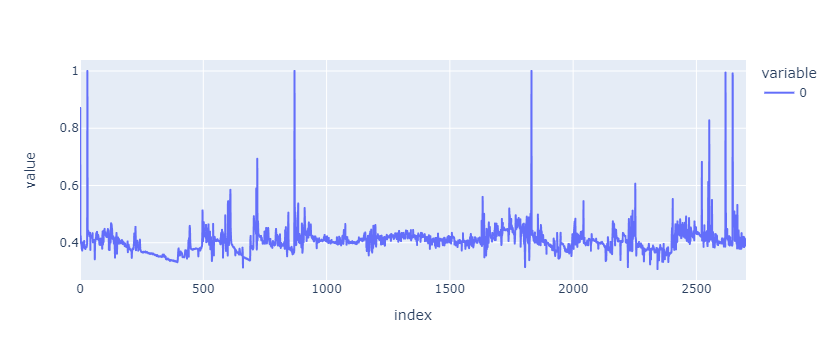

In [51]:
boundary_prob = np.max(post_wo_current, axis=1) / (np.max(post_wo_current, axis=1) + current_post)
# boundary_prob[0] = boundary_prob[1]
# boundary_prob = (boundary_prob - min(boundary_prob)) / (max(boundary_prob) - min(boundary_prob))
fig = px.line(boundary_prob)
fig

In [52]:
annotdf

,run,evnum,evname,startsec,endsec
0,1.1.1,1,prepare_tea,5.903,174.580
1,1.1.1,2,prepare_milk,174.581,206.114
2,1.1.1,3,look_at_text_message,206.115,239.608
3,1.1.1,4,prepare_a_bagel,239.609,552.440
4,1.1.1,5,prepare_cereal,552.441,627.264
...,...,...,...,...,...
1008,6.3.9,3,take_objects_out_of_drawers,282.096,302.850
1009,6.3.9,4,use_vacuum_attachment,302.851,437.733
1010,6.3.9,5,use_hand_duster,437.734,527.323
1011,6.3.9,6,put_on_bed_sheets,527.324,630.426


# Prepare a Master Dataframe

In [10]:
# fps = 25  #kinect
# high-level event annotations
grain = "coarse"

# for each epoch
def compute_schemadf(e_files):
    # build a dataframe of active SEM models and high-level event annotations
    schemadf = pd.DataFrame()
    last_sec = 0
    for dfile in tqdm(e_files):
        try:
            run = dfile.split('/')[-1].split('_')[0]
            epoch = dfile.split('/')[-1].split('_')[-1].split('.')[0]
            video_path = run + '_kinect_trim.mp4'
            capture = cv2.VideoCapture(os.path.join('data/small_videos/', f'{video_path}'))
            fps = capture.get(cv2.CAP_PROP_FPS)

            readout_dataframes = pkl.load(open(dfile, 'rb'))
            e_hat = readout_dataframes['e_hat']  # SEM active events
            boundaries = readout_dataframes['boundaries']
            pe = readout_dataframes['pe']
            pe_w = readout_dataframes['pe_w']
            pe_w2 = readout_dataframes['pe_w2']
            pe_w3 = readout_dataframes['pe_w3']
            # find frame index from input df:
            input_file = dfile.replace('diagnostic', 'inputdf')
            input_dataframes = pkl.load(open(input_file, 'rb'))
            sec = input_dataframes.x_train.index / fps

            tempdf = pd.DataFrame({'run': run, 'epoch': epoch, 'e_hat': e_hat, 'sec': sec,
                                   'pe': pe, 'pe_w': pe_w, 'pe_w2': pe_w2, 'pe_w3': pe_w3, 'tag': dfile.split('/')[-2],
                                   'gt_freqs': None, 
                                   # 'boundary_prob': None,
                                   'eb_pe_rs': 0, 'eb_pe_w_rs': 0, 'eb_pe_w2_rs': 0, 'eb_pe_w3_rs': 0,
                                   'eb_pe': 0, 'eb_pe_w': 0, 'eb_pe_w2': 0, 'eb_pe_w3': 0})
            tempdf['ev'] = 'none'
            rundf = annotdf[annotdf['run'] == run]
            for i in range(len(rundf)):
                ev = rundf.iloc[i]
                start = ev['startsec']
                end = ev['endsec']
                tempdf.loc[(tempdf['sec'] >= start) & (tempdf['sec'] <= end), 'ev'] = ev['evname']

            # get human segmentation with the same interval
            seg_data = pd.read_csv('seg_data_analysis_clean.csv')
            seg_video = SegmentationVideo(data_frame=seg_data, video_path=video_path)
            seg_video.get_human_segments(n_annotators=100, condition=grain, second_interval=1)
            first_second = tempdf.sec[0]
            last_second = tempdf.sec[len(tempdf) - 1]
            # add 1 to have larger range of gt_freqs, avoid out of bound interpolation
            seg_video.get_gt_freqs(second_interval=1, end_second=np.ceil(last_second) + 1)
            import scipy.interpolate as interp
            arr1_interp = interp.interp1d(np.arange(len(seg_video.gt_freqs)), seg_video.gt_freqs)
            # add 0.1 to include the last time-point
            # the formula in np.arange ensure that gt_freqs_stretch and tempdf have the same length
            gt_freqs_stretch = arr1_interp(np.arange(first_second, last_second + 0.1, (last_second - first_second)/(len(tempdf) - 1)))
            tempdf['gt_freqs'] = gt_freqs_stretch

            # add last_sec for concatenation purpose
            tempdf['sec'] = tempdf['sec'] + last_sec
            last_sec += last_second
            
            # for validation purpose of sketching gt_freqs
            # plt.figure()
            # plt.plot(seg_video.gt_freqs, label='Original')
            # plt.plot(np.arange(first_second, last_second + 0.1, (last_second - first_second)/(len(tempdf) - 1)),
            #          gt_freqs_stretch, label='Interpolate')
            # plt.xlabel('Time (seconds)')
            # plt.ylabel('Boundary Probability')
            # plt.title(f"{video_path}.png")
            # plt.legend()
            # plt.savefig(f"check_interpolation_{video_path}.png")
            # plt.close()
            
                    
            # boundary probability
            # current_post = np.ones(shape=(len(readout_dataframes['e_hat'])))
            # post_wo_current = deepcopy(readout_dataframes['post'])
            # # get index and e_hat from previous frame
            # indices = list(zip(range(1, len(readout_dataframes['e_hat'])), readout_dataframes['e_hat'][:-1]))
            # for ie in indices:
            #     post_wo_current[ie] = 0 # set current event to 0
            #     current_post[ie[0]] = readout_dataframes['post'][ie] # get posterior for current event
            # # boundary_prob = np.average(post_wo_current, axis=1) / (np.average(post_wo_current, axis=1) + current_post)
            # boundary_prob = np.sum(post_wo_current, axis=1) / (np.sum(post_wo_current, axis=1) + current_post)
            # # boundary_prob = np.max(post_wo_current, axis=1) / (np.max(post_wo_current, axis=1) + current_post)
            # boundary_prob[0] = boundary_prob[1]
            # tempdf['boundary_prob'] = boundary_prob
            
            # boundary_prob = (boundary_prob - min(boundary_prob)) / (max(boundary_prob) - min(boundary_prob))
            # tempdf['boundary_prob_norm'] = boundary_prob
            
            # boundaries from PEs
            tempdf['event_boundary'] = boundary_from_ehat(tempdf['e_hat'])
            tempdf['movie_boundary'] = movie_boundary_from_run(tempdf['run'])
            n_b = int(tempdf.event_boundary.sum())
            tempdf.loc[tempdf.nlargest(n_b, f'pe').index, f'eb_pe'] = 1
            tempdf.loc[tempdf.nlargest(n_b, f'pe_w2').index, f'eb_pe_w2'] = 1
            tempdf.loc[tempdf.nlargest(n_b, f'pe_w3').index, f'eb_pe_w3'] = 1
            tempdf.loc[tempdf.nlargest(n_b, f'pe_w').index, f'eb_pe_w'] = 1
            tempdf['event_boundary_rs'] = boundaries.astype(bool)
            n_b = int(tempdf.event_boundary_rs.sum())
            tempdf.loc[tempdf.nlargest(n_b, f'pe').index, f'eb_pe_rs'] = 1
            tempdf.loc[tempdf.nlargest(n_b, f'pe_w2').index, f'eb_pe_w2_rs'] = 1
            tempdf.loc[tempdf.nlargest(n_b, f'pe_w3').index, f'eb_pe_w3_rs'] = 1
            tempdf.loc[tempdf.nlargest(n_b, f'pe_w').index, f'eb_pe_w_rs'] = 1
            
            
            schemadf = pd.concat([schemadf, tempdf])

        except Exception as e:
            print(traceback.format_exc())
            print('error', dfile)
            return pd.DataFrame()
    #factorize event labels for numeric analyses:
    # print(schemadf)
    schemadf['ev_fact'] = pd.factorize(schemadf['ev'])[0]
    schemadf['epoch'] = schemadf['epoch'].astype(int)
    return schemadf


In [11]:
from joblib import Parallel, delayed
def compute_schemadf_epoch(epoch):
    # select only runs at validation point (both train and valid)
    if int(epoch) > 108 or int(epoch) % 10 != 1:
        return pd.DataFrame()
    e_files = [dfile for dfile in diagfiles if dfile.split('/')[-1].split('_')[-1].split('.')[0] == epoch]
    if len(e_files) == 0:
        return pd.DataFrame()
    e_schemadf = compute_schemadf(e_files)
    return e_schemadf

In [346]:
for key, cache_tags in name_to_tags.items():
    if os.path.exists(f'schemadf_{key}.csv'):
        print(f"schemadf_{key}.csv exists, continue..")
        continue
    print(f"Processing {key}")
    diagfiles = []
    for cache_tag in cache_tags:
        tag_files = glob(f'output/run_sem/{cache_tag}/*_diagnostic*.pkl')
        tag_files = [x.replace("\\", "/") for x in tag_files]
        diagfiles.extend(tag_files)
    epochs = list(set([dfile.split('/')[-1].split('_')[-1].split('.')[0] for dfile in diagfiles]))

    e_schemadfs = Parallel(n_jobs=8)(delayed(compute_schemadf_epoch)(epoch)
                                                    for epoch in epochs)
    schemadf = pd.concat(e_schemadfs)
    schemadf = schemadf.reset_index(drop=True)
    schemadf['epoch'] = schemadf['epoch'].astype(int)
    # schemadf.head(5)
    schemadf.to_csv(f'schemadf_{key}.csv', index_label=False)
    print(f"Saved schemadf_{key}.csv")

Processing 3m17_h15


100%|██████████| 147/147 [01:09<00:00,  2.13it/s]

Saved schemadf_3m17_h15.csv


In [12]:
schemadf = pd.DataFrame()
for key in name_to_tags.keys():
    try:
        df = pd.read_csv(f'schemadf_{key}.csv')
        schemadf = pd.concat([schemadf, df])
    except Exception as e:
        print(e)

In [13]:
schemadf.tag.unique()

array(['aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1020_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1050_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1060_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1070_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1080_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1010_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1020_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1030_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1040_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1050_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1070_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1080_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1090_1E-03_1E-01_1E+07',
       'aug_18_n

## Boundary Prob DataFrame

In [53]:
schemadf_reindex = schemadf.reset_index()
r_i = schemadf_reindex[schemadf_reindex.event_boundary == 1].index.to_numpy()
l_i = np.concatenate([[0], r_i[:-1]])
print(l_i, r_i)
for i, p in enumerate(zip(l_i, r_i)):
    c_index = schemadf_reindex.columns.get_indexer(['e_hat_reset'])
    schemadf_reindex.iloc[p[0]:p[1], c_index] = i


[      0       1      13 ... 1174003 1174008 1174014] [      1      13      14 ... 1174008 1174014 1174019]


In [55]:
c_index = schemadf_reindex.columns.get_indexer(['e_hat_reset'])
schemadf_reindex.iloc[r_i[-1]:, c_index] = i + 1

In [56]:
schemadf_reindex[['e_hat', 'e_hat_reset']]

,e_hat,e_hat_reset
0,0,0.0
1,8,1.0
2,8,1.0
3,8,1.0
4,8,1.0
...,...,...
1174016,12,33788.0
1174017,12,33788.0
1174018,12,33788.0
1174019,20,33789.0


In [30]:
schemadf[['e_hat', 'e_hat_reset']]

,e_hat,e_hat_reset
0,0,0.0
1,8,1.0
2,8,153.0
3,8,859.0
4,8,609.0
...,...,...
1704,12,NaN
1705,12,NaN
1706,12,NaN
1707,20,991.0


In [6]:
schemadf.loc[schemadf.epoch == '1', 'boundary_prob'].reset_index(drop=True)

0        0.373294
1        0.373294
2        0.380734
3        0.493766
4        0.485468
           ...   
38919    0.330501
38920    0.331716
38921    0.411441
38922    0.385015
38923    0.372910
Name: boundary_prob, Length: 38924, dtype: float64

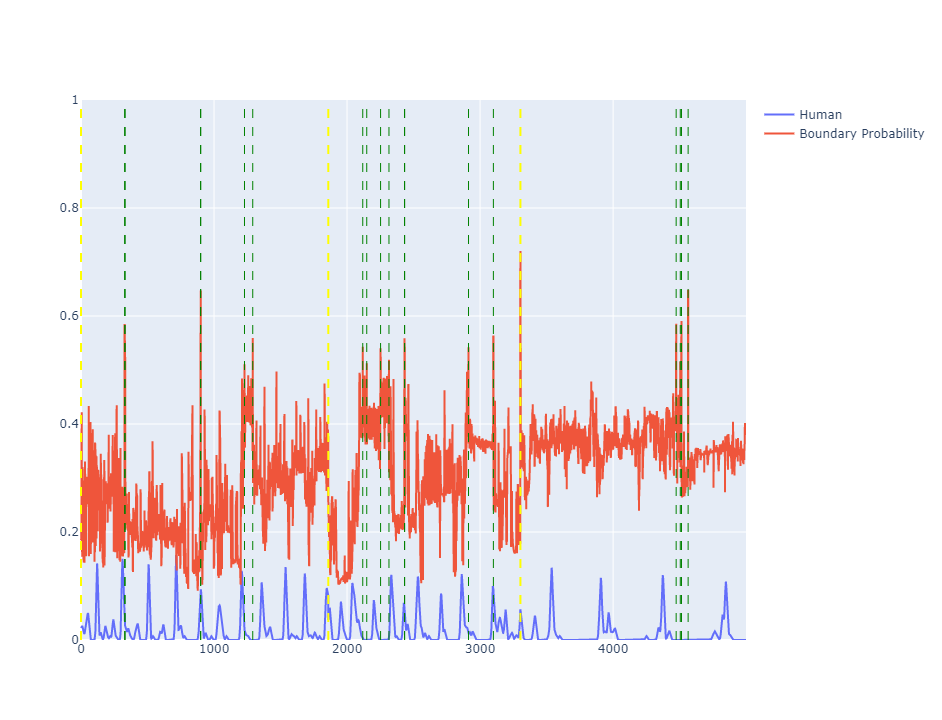

In [119]:
fig = go.Figure()
cutoff = 5000
df = schemadf.loc[schemadf.epoch == '1', :].reset_index(drop=True)
fig.add_trace(
    go.Scatter(x=df.index, y=df['gt_freqs'][:cutoff], mode='lines', name='Human'),
)
fig.add_trace(
    go.Scatter(x=df.index[:cutoff], y=df['boundary_prob'][:cutoff], mode='lines', name='Boundary Probability')
)
fig.update_layout(yaxis_range=[0,1])
for i, b in df['event_boundary'].iteritems():
    if i >= cutoff:
        break
    if b == 1:
        fig.add_vline(x=i, line_width=1, line_dash="dash", line_color="green")
for i, b in df['movie_boundary'].iteritems():
    if i >= cutoff:
        break
    if b == 1:
        fig.add_vline(x=i, line_width=2, line_dash="dash", line_color="yellow")
fig

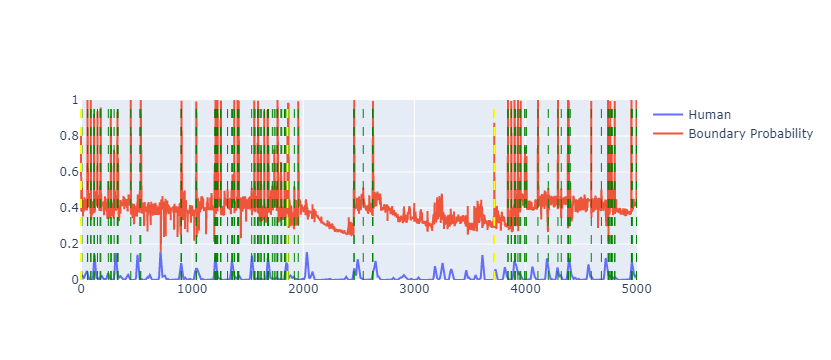

In [118]:
fig = go.Figure()
cutoff = 5000
df = schemadf.loc[schemadf.epoch == '6', :].reset_index(drop=True)
fig.add_trace(
    go.Scatter(x=df.index, y=df['gt_freqs'][:cutoff], mode='lines', name='Human'),
)
fig.add_trace(
    go.Scatter(x=df.index[:cutoff], y=df['boundary_prob'][:cutoff], mode='lines', name='Boundary Probability')
)
fig.update_layout(yaxis_range=[0,1])
for i, b in df['event_boundary'].iteritems():
    if i >= cutoff:
        break
    if b == 1:
        fig.add_vline(x=i, line_width=1, line_dash="dash", line_color="green")
for i, b in df['movie_boundary'].iteritems():
    if i >= cutoff:
        break
    if b == 1:
        fig.add_vline(x=i, line_width=2, line_dash="dash", line_color="yellow")
fig

# Segmentation

## Analyze Human Segmentation

In [256]:
grain = 'fine'
# get human segmentation with the same interval
seg_data = pd.read_csv('seg_data_analysis_clean.csv')
def pool_boundaries(run):
    video_path = run + "_kinect_trim.mp4"
    seg_video = SegmentationVideo(data_frame=seg_data, video_path=video_path)
    segments = seg_video.get_human_segments(n_annotators=100, condition=grain, second_interval=1)
    return segments

In [257]:
segments = Parallel(n_jobs=12)(delayed(pool_boundaries)(run) for run in schemadf.run.unique())

In [258]:
counts = []
distances = []
for x in segments:
    for boundaries in x:
        counts.append(len(boundaries))
        distances.extend(boundaries[1:] - boundaries[:-1])

In [259]:
distances = np.array(distances) * 3

In [260]:
np.mean(counts)

26.90280629705681

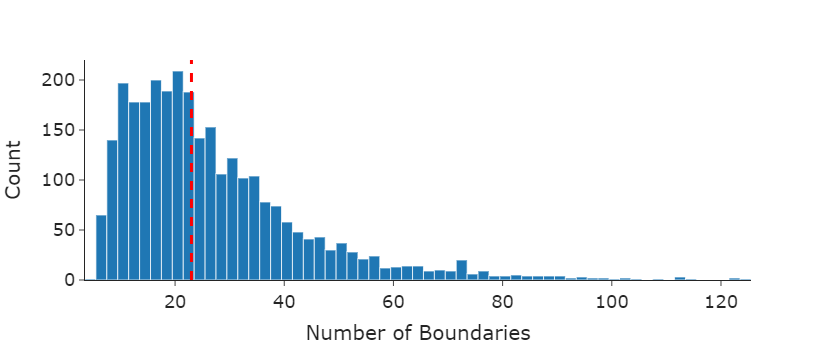

In [261]:
fig = px.histogram(counts)
fig.update_layout(layout)
fig.update_layout(#title_text=f"Human's Number of Boundaries (Fine-grain)", 
                  showlegend=False)
fig.update_xaxes(x_axis)
fig.update_xaxes(title_text="Number of Boundaries")
fig.update_yaxes(y_axis)
fig.update_yaxes(title_text="Count")
fig.add_vline(x=23, line_width=3, line_dash="dash", line_color="red", opacity=1)
# fig.add_annotation(dict(font=dict(color='black',size=15),
#                                         x=.16,
#                                         y=.85,
#                                         showarrow=False,
#                                         text="SEM's average adjusted number of boundaries",
#                                         textangle=0,
#                                         xanchor='left',
#                                         xref="paper",
#                                         yref="paper"))
fig.show()

In [289]:
np.median(distances)

40.307575499999984

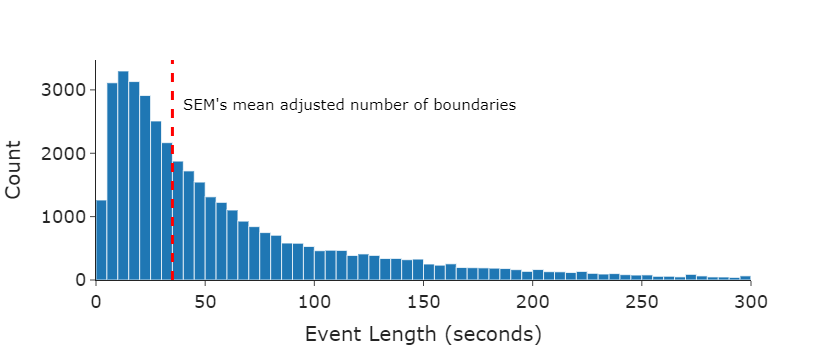

In [290]:
fig = px.histogram(distances, range_x=(0, 300))
fig.update_layout(layout)
fig.update_layout(#title_text=f"Human's Number of Boundaries (Fine-grain)", 
                  showlegend=False)
fig.update_xaxes(x_axis)
fig.update_xaxes(title_text="Event Length (seconds)")
fig.update_yaxes(y_axis)
fig.update_yaxes(title_text="Count")
fig.add_vline(x=35, line_width=3, line_dash="dash", line_color="red", opacity=1)
fig.add_annotation(dict(font=dict(color='black',size=15),
                                        x=.13,
                                        y=.85,
                                        showarrow=False,
                                        text="SEM's mean adjusted number of boundaries",
                                        textangle=0,
                                        xanchor='left',
                                        xref="paper",
                                        yref="paper"))

In [371]:
np.percentile(distances, 35)

25.799266799999973

## Adjusting Flurry for #Boundaries

In [354]:
tags_to_analyze = update_tags_3m17_more
boundaries = schemadf[(schemadf.epoch == 61) & (schemadf.tag.isin(tags_to_analyze))]['event_boundary']
boundaries.head(5)

9440452    0
9440453    1
9440454    0
9440455    0
9440456    0
Name: event_boundary, dtype: int64

In [355]:
def adjust_n_boundaries(boundaries, k=0):
    flag = 0
    count = 0
    # count only the "end" boundary in a flurry
    for b in boundaries:
        if b == 1:
            flag = 1
            offset = -1
        if flag:
            offset += 1
            if offset >= k:
                count += 1
                offset = -1
                flag = 0
    return count

In [356]:
adjusted_boundaries = []
ori = adjust_n_boundaries(boundaries, 0)
for k in range(0, 50, 2):
    r = adjust_n_boundaries(boundaries, k)
    adjusted_boundaries.append(r)
ratio_to_k = [x / ori for x in adjusted_boundaries]

In [357]:
adjusted_boundaries[3] / len(valid_runs) / len(tags_to_analyze)

19.75625

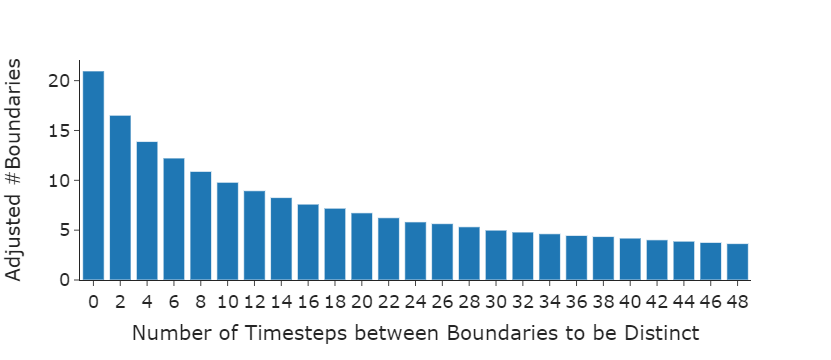

In [449]:
fig = px.bar(np.array(adjusted_boundaries) / len(valid_runs) / len(tags_to_analyze))
fig.update_layout(layout)
fig.update_layout(showlegend=False)
fig.update_xaxes(x_axis)
fig.update_xaxes(title_text="Number of Timesteps between Boundaries to be Distinct")
fig.update_xaxes(tickmode='array', tickvals=list(range(len(adjusted_boundaries))), 
                 ticktext=list(range(0, 50, 2)))
fig.update_yaxes(y_axis)
fig.update_yaxes(title_text="Adjusted #Boundaries")

## Boundary to Boundary Lags

In [124]:
boundary_df = schemadf.loc[:, ['run', 'epoch', 'tag', 'event_boundary', 
                        'eb_pe', 'eb_pe_w', 'eb_pe_w2', 'eb_pe_w3']]
boundary_df = boundary_df[boundary_df.tag.isin(update_tags_3m17_more)]
boundary_df.head(5)

,run,epoch,tag,event_boundary,eb_pe,eb_pe_w,eb_pe_w2,eb_pe_w3
0,6.3.4,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,0,0,0,0,0
1,6.3.4,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,1,0,0,0,0
2,6.3.4,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,0,0,0,0,0
3,6.3.4,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,0,0,1,1,1
4,6.3.4,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,0,0,0,0,0


### Auto-correlation approach

In [121]:
from statsmodels.tsa.stattools import acf


df_lag = pd.DataFrame(columns=['lag', 'correlation'])
for run in boundary_df.run.unique():
    if run not in valid_runs:
        continue
    for epoch in boundary_df.epoch.unique():
        for tag in boundary_df.tag.unique():
            df_select = boundary_df[(boundary_df.run == run) & (boundary_df.epoch == epoch) & (boundary_df.tag == tag)]
            if len(df_select):
                res = acf(df_select.event_boundary, nlags=14, fft=True)
                for l in range(len(res)):
                    df_lag.loc[len(df_lag)] = [l, res[l]]

df_lag

,lag,correlation
0,0.0,1.000000
1,1.0,0.026320
2,2.0,0.009066
3,3.0,0.044460
4,4.0,0.026745
...,...,...
2995,10.0,-0.004933
2996,11.0,0.007718
2997,12.0,-0.009796
2998,13.0,0.002855


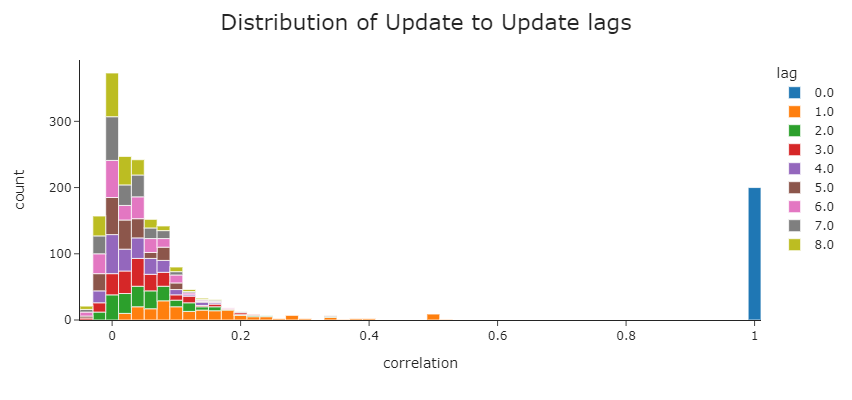

In [124]:
fig = px.histogram(df_lag[df_lag.lag < 9], x='correlation', nbins=100, 
                   color='lag',
                   # facet_col='lag',
                   # facet_col_wrap=3, facet_row_spacing=0.15
                  )
fig.update_layout(layout)
fig.update_layout(title=dict(text="Distribution of Update to Update lags"), width=600, height=400)

### Event Length Approach

In [125]:
def compute_elapse(run, epoch, boundary_df):
    for tag in boundary_df.tag.unique():
        df_select = boundary_df[(boundary_df.run == run) & (boundary_df.epoch == epoch) & (boundary_df.tag == tag)]
        if len(df_select):
            b_indices = np.where((df_select.event_boundary == 1).to_numpy() == 1)[0]
            elapses = b_indices[1:] - b_indices[:-1]
            df_elapse = pd.DataFrame({'tag': tag, 'epoch': epoch, 'run': run, 'elapse': elapses})
            return df_elapse

In [126]:
df_elapse = pd.DataFrame(columns=['tag', 'epoch', 'run','elapse'])
for run in tqdm(boundary_df.run.unique()):
    if run not in valid_runs:
        continue
    elapses = Parallel(n_jobs=12)(delayed(compute_elapse)(run, epoch, boundary_df) 
                                 for epoch in boundary_df.epoch.unique())
    df_elapse = pd.concat(elapses + [df_elapse])

df_elapse.head(5)

100%|████████████████████████████████████████████████████████████████████| 109/109 [02:15<00:00,  1.24s/it]


,tag,epoch,run,elapse
0,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,1,2.2.9,928
1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,1,2.2.9,3
0,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,71,2.2.9,5
1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,71,2.2.9,52
2,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,71,2.2.9,2


In [127]:
df_elapse['elapse(s)'] = df_elapse.elapse / 3
df_elapse[df_elapse['elapse(s)'] > 30] = 30

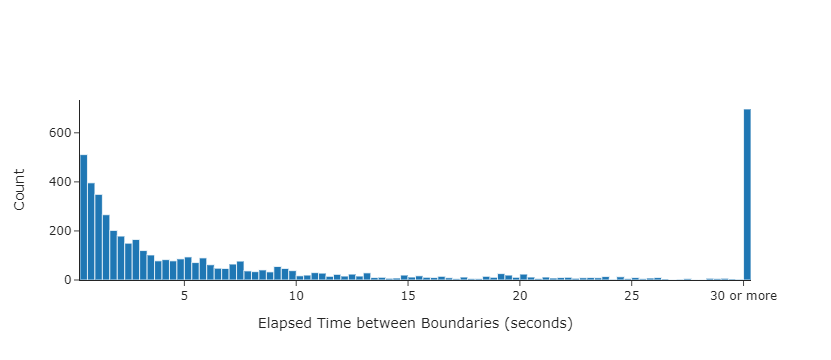

In [128]:
fig = go.Figure()
fig.add_trace(
    go.Histogram(x=df_elapse['elapse(s)'], xbins=go.histogram.XBins(size=1/3, start=0, end=30.1))
)

fig.update_layout(showlegend=False)
fig.update_xaxes(tickmode='array', tickvals=[5, 10, 15, 20, 25, 30], 
                 ticktext=['5', '10', '15', '20', '25', '30 or more'])
fig.update_xaxes(title=dict(text="Elapsed Time between Boundaries (seconds)"))
fig.update_yaxes(title=dict(text="Count"))
fig.show()

In [129]:
df_elapse['elapse(s)'].mean()

8.703072812291234

### Combine Figures from plotly.express

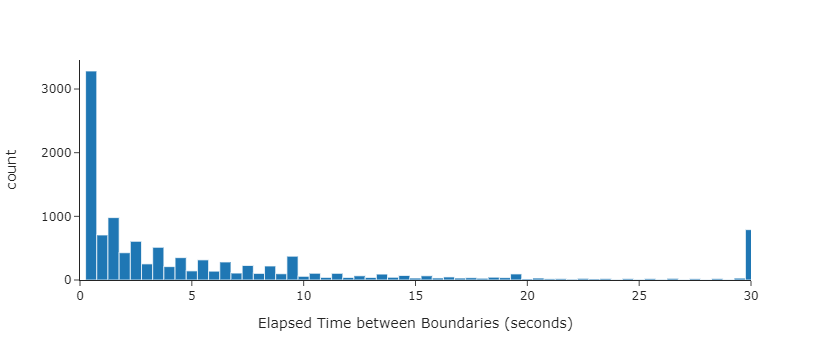

In [246]:
fig1 = px.histogram(x=df_elapse['elapse(s)'], nbins=100, range_x=(0, 30))
fig1.update_xaxes(title=dict(text="Elapsed Time between Boundaries (seconds)"))
fig1

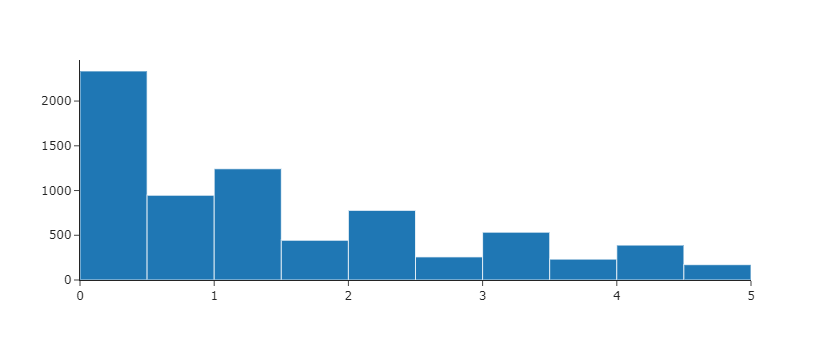

In [222]:
fig2 = px.histogram(x=df_elapse[df_elapse['elapse(s)'] < 5]['elapse(s)'], range_x=(-1, 4), nbins=20,
                 # xaxis='x2', yaxis='y2'
                   )
# fig2.update_xaxes(anchor='x2')
fig2.update_traces(xaxis='x2', yaxis='y2')
fig2.update_xaxes(title='')
fig2

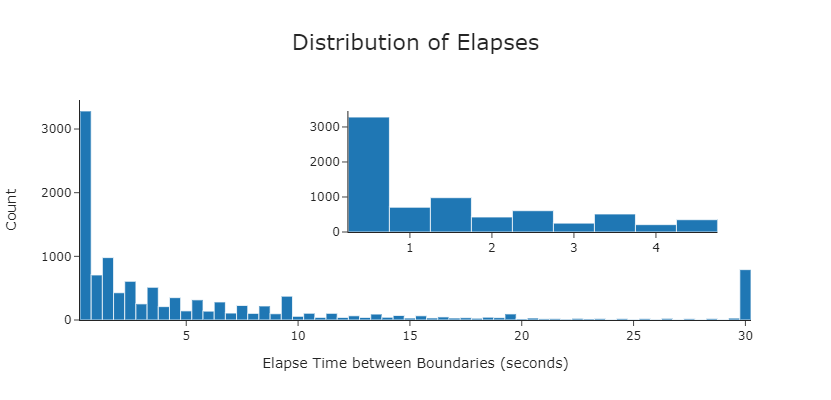

In [231]:
fig = go.Figure()

fig.add_trace(
    fig1.data[0]
)
fig.add_trace(
    fig2.data[0], 
)

fig.update_layout(layout)
fig.update_layout(xaxis2=dict(
        domain=[0.4, 0.95],
        anchor='y2'
    ),
    yaxis2=dict(
        domain=[0.4, 0.95],
        anchor='x2'
    ),
    xaxis=dict(title=dict(text='Elapse Time between Boundaries (seconds)')),
    yaxis=dict(title=dict(text='Count')),              
)
fig.update_layout(title=dict(text="Distribution of Elapses"), width=600, height=400, showlegend=False)
# fig.update_xaxes(title=dict(text="Elapse Time between Boundaries (seconds)"))
# fig.update_yaxes(title=dict(text="Count"))
fig.show()

In [164]:
df_window = pd.DataFrame(columns=['window', 'count'])
for w in range(10, 31, 10):
    for run in boundary_df.run.unique():
        if run not in valid_runs:
            continue
        for epoch in boundary_df.epoch.unique():
            for tag in boundary_df.tag.unique():
                df_select = boundary_df[(boundary_df.run == run) & (boundary_df.epoch == epoch) & (boundary_df.tag == tag)]
                if len(df_select):
                    count = df_select.event_boundary.rolling(w).sum()
                    df_window = pd.concat([df_window, 
                                           pd.DataFrame({'window': np.full_like(count, fill_value=w),
                                                         'count': count.to_numpy()})])
df_window

,window,count
0,10.0,NaN
1,10.0,NaN
2,10.0,NaN
3,10.0,NaN
4,10.0,NaN
...,...,...
1704,30.0,7.0
1705,30.0,7.0
1706,30.0,7.0
1707,30.0,7.0


In [176]:
df_window['updates'] = df_window['count']
df_window['window(s)'] = round(df_window['window'] / 3, 2)

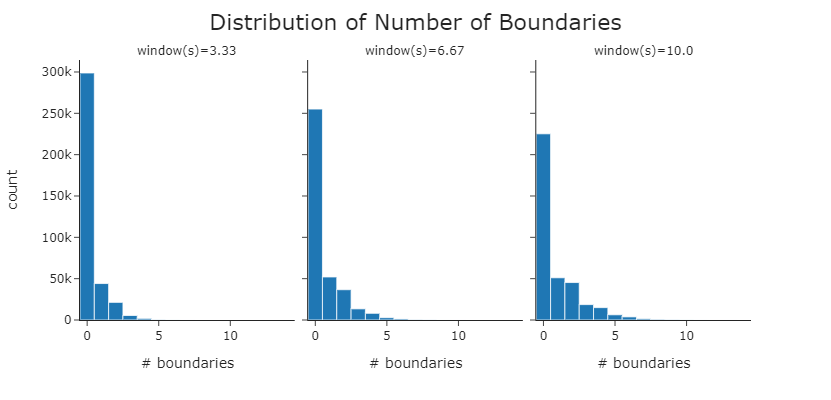

In [179]:
fig = px.histogram(df_window, x='updates',
                   facet_col='window(s)'
                  )
fig.update_layout(layout)
fig.update_layout(title=dict(text="Distribution of Number of Boundaries"), width=600, height=400)
fig.update_xaxes(title=dict(text="# boundaries"))
fig.show()

## Biserial Correlation

### Prepare Biserial Dataframe

In [347]:
def compute_biserial_epoch(tag, epoch, sdf, permute=10):
    
    edf = sdf[(sdf['epoch'] == epoch) & (sdf['tag'] == tag)]
    if len(edf) == 0:
        return pd.DataFrame()
    # e_hat = np.array(edf['e_hat'])
    # concatenated_boundaries = np.hstack([[0], e_hat[1:] != e_hat[:-1]])
    def average_biserial_run(sdf, run, boundary_from='event_boundary'):
        sdf = sdf[sdf.run == run]
        if len(sdf) == 0 or run not in valid_runs:
            return pd.DataFrame()
        # pred_boundaries = get_binned_prediction(sdf[boundary_from].to_numpy().astype(int), second_interval=1,
        #                                     sample_per_second=3).astype(bool)
        # human_segmentation = get_binned_prediction(sdf['gt_freqs'].to_numpy(), second_interval=1,
        #                                     sample_per_second=3).astype(float)
        # biserial = get_point_biserial(pred_boundaries, human_segmentation)
        biserial = get_point_biserial(sdf[boundary_from], sdf['gt_freqs'])
        return pd.DataFrame([{'run': run, 'bicorr': biserial}])
    
    run_bicorrs = Parallel(n_jobs=12)(delayed(average_biserial_run)(edf, run, 'event_boundary') 
                                                                   for run in sdf.run.unique())
    biserial = pd.concat(run_bicorrs).reset_index(drop=True).mean(numeric_only=True)[0]
    run_bicorrs = Parallel(n_jobs=12)(delayed(average_biserial_run)(edf, run, 'eb_pe') 
                                                                   for run in sdf.run.unique())
    bi_pe = pd.concat(run_bicorrs).reset_index(drop=True).mean(numeric_only=True)[0]
    run_bicorrs = Parallel(n_jobs=12)(delayed(average_biserial_run)(edf, run, 'eb_pe_w') 
                                                                   for run in sdf.run.unique())
    bi_pe_w = pd.concat(run_bicorrs).reset_index(drop=True).mean(numeric_only=True)[0]
    run_bicorrs = Parallel(n_jobs=12)(delayed(average_biserial_run)(edf, run, 'eb_pe_w2') 
                                                                   for run in sdf.run.unique())
    bi_pe_w2 = pd.concat(run_bicorrs).reset_index(drop=True).mean(numeric_only=True)[0]
    run_bicorrs = Parallel(n_jobs=12)(delayed(average_biserial_run)(edf, run, 'eb_pe_w3') 
                                                                   for run in sdf.run.unique())
    bi_pe_w3 = pd.concat(run_bicorrs).reset_index(drop=True).mean(numeric_only=True)[0]

    # concatenated_boundaries = edf['event_boundary']
    # biserial = get_point_biserial(concatenated_boundaries, edf['gt_freqs'])
    # concatenated_boundaries = edf['eb_pe']
    # bi_pe = get_point_biserial(concatenated_boundaries, edf['gt_freqs'])
    # concatenated_boundaries = edf['eb_pe_w2']
    # bi_pe_w2 = get_point_biserial(concatenated_boundaries, edf['gt_freqs'])
    # concatenated_boundaries = edf['eb_pe_w3']
    # bi_pe_w3 = get_point_biserial(concatenated_boundaries, edf['gt_freqs'])
    # concatenated_boundaries = edf['eb_pe_w']
    # bi_pe_w = get_point_biserial(concatenated_boundaries, edf['gt_freqs'])
    tempdf = pd.DataFrame({'epoch': epoch, 'tag': tag, 'bi': [biserial], 
                           'bi_shuffle_h': np.nan, 'bi_shuffle_h_fair': np.nan,
                           'bi_pe': [bi_pe], 'bi_pe_w':[bi_pe_w], 
                           'bi_pe_w2': [bi_pe_w2], 'bi_pe_w3': [bi_pe_w3]})
    for i in range(permute):
    # if permute:
        shuffled = np.array(fair_shuffle(df_e_hat=edf['e_hat'], df_run=edf['run']))
        # shuffled = np.array(shuffle_label_lengths(labels=edf['e_hat']))
        r_concatenated_boundaries = np.hstack([[0], shuffled[1:] != shuffled[:-1]])
        r_biserial_fair = get_point_biserial(r_concatenated_boundaries, edf['gt_freqs'])
        shuffled = np.array(shuffle_label_lengths(labels=edf['e_hat']))
        r_concatenated_boundaries = np.hstack([[0], shuffled[1:] != shuffled[:-1]])
        r_biserial = get_point_biserial(r_concatenated_boundaries, edf['gt_freqs'])
        tempdf = pd.concat([tempdf, pd.DataFrame({'epoch': epoch, 'tag': tag, 
                                                  'bi': [biserial], 'bi_shuffle_h': r_biserial,
                                                  'bi_shuffle_h_fair': r_biserial_fair,
                                                  'bi_pe': [bi_pe], 'bi_pe_w':[bi_pe_w], 
                                                  'bi_pe_w2': [bi_pe_w2], 'bi_pe_w3': [bi_pe_w3]
                                                 })])
    return tempdf

In [348]:
def compute_biserial_epoch_rs(tag, epoch, sdf, permute=10, scale=True):
    
    edf = sdf[(sdf['epoch'] == epoch) & (sdf['tag'] == tag)]
    if len(edf) == 0:
        return pd.DataFrame()
    # e_hat = np.array(edf['e_hat'])
    # concatenated_boundaries = np.hstack([[0], e_hat[1:] != e_hat[:-1]])
    def average_biserial_run(sdf, run, boundary_from='event_boundary'):
        sdf = sdf[sdf.run == run]
        if len(sdf) == 0 or run not in valid_runs:
            return pd.DataFrame()
        # pred_boundaries = get_binned_prediction(sdf[boundary_from].to_numpy().astype(int), second_interval=1,
        #                                     sample_per_second=3).astype(bool)
        # human_segmentation = get_binned_prediction(sdf['gt_freqs'].to_numpy(), second_interval=1,
        #                                     sample_per_second=3).astype(float)
        # biserial = get_point_biserial(pred_boundaries, human_segmentation)
        biserial = get_point_biserial(sdf[boundary_from], sdf['gt_freqs'], scale=scale)
        return pd.DataFrame([{'run': run, 'bicorr': biserial}])
    run_bicorrs = Parallel(n_jobs=12)(delayed(average_biserial_run)(edf, run, 'event_boundary_rs') 
                                                                   for run in sdf.run.unique())
    biserial = pd.concat(run_bicorrs).reset_index(drop=True).mean(numeric_only=True)[0]
    run_bicorrs = Parallel(n_jobs=12)(delayed(average_biserial_run)(edf, run, 'eb_pe_rs') 
                                                                   for run in sdf.run.unique())
    bi_pe = pd.concat(run_bicorrs).reset_index(drop=True).mean(numeric_only=True)[0]
    run_bicorrs = Parallel(n_jobs=12)(delayed(average_biserial_run)(edf, run, 'eb_pe_w_rs') 
                                                                   for run in sdf.run.unique())
    bi_pe_w = pd.concat(run_bicorrs).reset_index(drop=True).mean(numeric_only=True)[0]
    run_bicorrs = Parallel(n_jobs=12)(delayed(average_biserial_run)(edf, run, 'eb_pe_w2_rs') 
                                                                   for run in sdf.run.unique())
    bi_pe_w2 = pd.concat(run_bicorrs).reset_index(drop=True).mean(numeric_only=True)[0]
    run_bicorrs = Parallel(n_jobs=12)(delayed(average_biserial_run)(edf, run, 'eb_pe_w3_rs') 
                                                                   for run in sdf.run.unique())
    bi_pe_w3 = pd.concat(run_bicorrs).reset_index(drop=True).mean(numeric_only=True)[0]
    
    tempdf = pd.DataFrame({'epoch': epoch, 'tag': tag, 'bi': [biserial], 
                           'bi_shuffle_h': np.nan, 'bi_shuffle_h_fair': np.nan,
                           'bi_pe': [bi_pe], 'bi_pe_w':[bi_pe_w], 
                           'bi_pe_w2': [bi_pe_w2], 'bi_pe_w3': [bi_pe_w3]})
    for i in range(permute):
    # if permute:
        shuffled = np.array(fair_shuffle(df_e_hat=edf['e_hat'], df_run=edf['run']))
        # shuffled = np.array(shuffle_label_lengths(labels=edf['e_hat']))
        r_concatenated_boundaries = np.hstack([[0], shuffled[1:] != shuffled[:-1]])
        r_biserial_fair = get_point_biserial(r_concatenated_boundaries, edf['gt_freqs'], scale=scale)
        shuffled = np.array(shuffle_label_lengths(labels=edf['e_hat']))
        r_concatenated_boundaries = np.hstack([[0], shuffled[1:] != shuffled[:-1]])
        r_biserial = get_point_biserial(r_concatenated_boundaries, edf['gt_freqs'], scale=scale)
        tempdf = pd.concat([tempdf, pd.DataFrame({'epoch': epoch, 'tag': tag, 
                                                  'bi': [biserial], 'bi_shuffle_h': r_biserial,
                                                  'bi_shuffle_h_fair': r_biserial_fair,
                                                  'bi_pe': [bi_pe], 'bi_pe_w':[bi_pe_w], 
                                                  'bi_pe_w2': [bi_pe_w2], 'bi_pe_w3': [bi_pe_w3]
                                                 })])
    return tempdf

In [349]:
biserial_all_rs = pd.DataFrame()
for key, cache_tags in name_to_tags.items():
    if os.path.exists(f'biserial_scaled_{key}.csv'):
        print(f"biserial_scaled_{key}.csv exists, continue..")
        continue
    print(f"Processing {key}")
    # do reset
    sdf = schemadf[schemadf['run'].isin(valid_runs)
                   & (schemadf['tag'].isin(cache_tags))
                  ]
    if len(sdf) == 0:
        print(f"Tags with {cache_tags[0]} is not in schemadf")
        continue
    tempdfs = Parallel(n_jobs=12)(delayed(compute_biserial_epoch_rs)(tag, epoch, sdf) 
                       for epoch in tqdm(sdf.epoch.unique())
                                for tag in (sdf.tag.unique()))
    tags_df = pd.concat(tempdfs)
    tags_df['epoch'] = tags_df['epoch'].astype('int')
    tags_df.to_csv(f'biserial_scaled_{key}.csv', index_label=False)
    biserial_all_rs = pd.concat([biserial_all_rs, tags_df])

Processing 3m17_h15


  0%|                                          | 0/11 [00:00<?, ?it/s]







100%|█████████████████████████████████| 11/11 [00:27<00:00,  2.53s/it]


In [359]:
biserial_all_rs = pd.DataFrame()
for key in name_to_tags.keys():
    try:
        df = pd.read_csv(f'biserial_scaled_{key}.csv')
        biserial_all_rs = pd.concat([biserial_all_rs, df])
    except Exception as e:
        print(e)

In [360]:
biserial_all_rs.tag.unique()

array(['aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1020_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1050_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1060_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1070_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1080_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1010_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1020_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1030_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1040_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1050_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1070_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1080_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1090_1E-03_1E-01_1E+07',
       'aug_18_n

In [361]:
biserial_all_rs[biserial_all_rs.tag.isin(update_tags_3m17_more) & (biserial_all_rs.epoch == 101)].groupby(['tag'])['bi'].mean()

tag
july_18_full_.8_.8_1010_1E-03_1E-01_1E+07    0.255312
july_18_full_.8_.8_1020_1E-03_1E-01_1E+07    0.296046
july_18_full_.8_.8_1030_1E-03_1E-01_1E+07    0.310389
july_18_full_.8_.8_1040_1E-03_1E-01_1E+07    0.274134
july_18_full_.8_.8_1050_1E-03_1E-01_1E+07    0.239850
july_18_full_.8_.8_1060_1E-03_1E-01_1E+07    0.290836
july_18_full_.8_.8_1070_1E-03_1E-01_1E+07    0.268542
july_18_full_.8_.8_1080_1E-03_1E-01_1E+07    0.295372
july_18_full_.8_.8_1090_1E-03_1E-01_1E+07    0.252071
july_18_full_.8_.8_1100_1E-03_1E-01_1E+07    0.239879
july_18_full_.8_.8_1110_1E-03_1E-01_1E+07    0.246827
july_18_full_.8_.8_1120_1E-03_1E-01_1E+07    0.250469
july_18_full_.8_.8_1130_1E-03_1E-01_1E+07    0.259238
july_18_full_.8_.8_1140_1E-03_1E-01_1E+07    0.264655
july_18_full_.8_.8_1150_1E-03_1E-01_1E+07    0.256392
july_18_full_.8_.8_1160_1E-03_1E-01_1E+07    0.278243
Name: bi, dtype: float64

In [362]:
biserial_all_long = pd.melt(biserial_all_rs, id_vars = ["epoch", "tag"], 
                            value_vars=['bi', 'bi_shuffle_h_fair', 
                                        'bi_pe', 'bi_pe_w2', 
                                        'bi_pe_w3', 'bi_pe_w'])
biserial_all_long.head(5)

,epoch,tag,variable,value
0,91,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,bi,0.278122
1,91,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,bi,0.278122
2,91,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,bi,0.278122
3,91,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,bi,0.278122
4,91,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,bi,0.278122


In [363]:
seg_path = 'seg_data_analysis_clean.csv'
data_frame = pd.read_csv(seg_path)
human_seg = pd.DataFrame(columns=["run", "biserials"])
for v in valid_runs:
    video_path = v + '_C1_trim.mp4'
    seg_video = SegmentationVideo(data_frame=data_frame, video_path=video_path)
    seg_points = seg_video.get_human_segments(n_annotators=100, condition='coarse')
    last = round(max(np.concatenate(seg_points))) + 5
    # this function aggregate subject boundaries, apply a gaussian kernel and calculate correlations for subjects
    seg_video.get_gt_freqs(end_second=last)
    biserials = seg_video.get_biserial_subjects(end_second=last)
    human_seg.loc[len(human_seg), :] = [v, biserials]
# human_seg

/home/n.tan/.conda/envs/sem-viz-jupyter/lib/python3.7/site-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray



In [364]:
all_bi = []
for x in human_seg['biserials'].to_list():
    all_bi += x
for e in biserial_all_long.epoch.unique():
    for bi in all_bi:
        biserial_all_long.loc[len(biserial_all_long), :] = [e, 'human', 'human', bi]

In [365]:
biserial_all_long['training_time'] = biserial_all_long['epoch'].map(epoch_to_duration)
biserial_all_long['training_time'] = biserial_all_long['training_time'] / 60
biserial_all_long = biserial_all_long.drop_duplicates()
biserial_all_long.head(5)

,epoch,tag,variable,value,training_time
0,91.0,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,bi,0.278122,937.848032
11,91.0,aug_17_no_skel_off_update_1020_1E-03_1E-01_1E+07,bi,0.271799,937.848032
22,91.0,aug_17_no_skel_off_update_1050_1E-03_1E-01_1E+07,bi,0.268138,937.848032
33,91.0,aug_17_no_skel_off_update_1060_1E-03_1E-01_1E+07,bi,0.266575,937.848032
44,91.0,aug_17_no_skel_off_update_1070_1E-03_1E-01_1E+07,bi,0.275912,937.848032


#### Experiment with Sketching and Shrinking

In [559]:
# def get_binned_prediction(boundaries, second_interval=1, sample_per_second=3) -> np.ndarray:
#     # frame_boundaries = boundaries.astype(bool).astype(int)
#     frame_interval = round(second_interval * sample_per_second)
#     # Sum for each interval
#     time_boundaries = np.add.reduceat(boundaries,
#                                       range(0, len(boundaries), frame_interval))
#     return np.array(time_boundaries)

In [573]:
# def average_biserial_run(sdf, run, boundary_from='event_boundary'):
#     sdf = sdf[sdf.run == run]
#     if len(sdf) == 0 or run not in valid_runs:
#         return pd.DataFrame()
#     # pred_boundaries = get_binned_prediction(sdf[boundary_from].to_numpy().astype(int), second_interval=1,
#     #                                     sample_per_second=3).astype(bool)
#     # human_segmentation = get_binned_prediction(sdf['gt_freqs'].to_numpy(), second_interval=1,
#     #                                     sample_per_second=3).astype(float)
#     # biserial = get_point_biserial(pred_boundaries, human_segmentation)
#     biserial = get_point_biserial(sdf[boundary_from], sdf['gt_freqs'])
#     return pd.DataFrame([{'run': run, 'bicorr': biserial}])
    
# sdf = schemadf[(schemadf.epoch == '11') & (schemadf.tag == update_tags_305[1])]
# run_bicorrs = Parallel(n_jobs=12)(delayed(average_biserial_run)(sdf, run, 'event_boundary') 
#                                                                for run in sdf.run.unique())
# avg = pd.concat(run_bicorrs).reset_index(drop=True).mean(numeric_only=True)

In [574]:
# avg

bicorr    0.220176
dtype: float64

In [545]:
# seg_data = pd.read_csv('seg_data_analysis_clean.csv')
# seg_video = SegmentationVideo(data_frame=seg_data, video_path='1.2.7_kinect_trim.mp4')
# seg_video.get_human_segments(n_annotators=100, condition=grain, second_interval=1)

# dfile = f'output/run_sem/{update_tags_305[1]}/1.2.7_kinect_trim{update_tags_305[1]}_diagnostic_11.pkl'
# readout_dataframes = pkl.load(open(dfile, 'rb'))
# input_file = dfile.replace('diagnostic', 'inputdf')
# input_dataframes = pkl.load(open(input_file, 'rb'))
# sec = input_dataframes.x_train.index / 25

# first_second = sec[0]
# last_second = sec[len(sec) - 1]
# # add 1 to have larger range of gt_freqs, avoid out of bound interpolation
# seg_video.get_gt_freqs(second_interval=1, end_second=np.ceil(last_second) + 1)
# len(seg_video.gt_freqs)

486

In [550]:
# sdf = schemadf[(schemadf.epoch == '11') & (schemadf.tag == update_tags_305[1]) & (schemadf.run == '1.2.7')]
# get_point_biserial(sdf[boundary_from], sdf['gt_freqs'])

In [550]:
# pred_boundaries = get_binned_prediction(sdf[boundary_from].to_numpy(), second_interval=1,
#                                     sample_per_second=3).astype(bool)
# pred_boundaries = np.hstack([[0] * round(first_second), pred_boundaries])

(486,)

In [552]:
# biserial = get_point_biserial(pred_boundaries, seg_video.gt_freqs)
# biserial

0.27472913985948705

In [568]:
# boundary_from = 'event_boundary'
# sdf = schemadf[(schemadf.epoch == '11') & (schemadf.tag == update_tags_305[1]) & (schemadf.run == '1.2.7')]
# pred_boundaries = get_binned_prediction(sdf[boundary_from].to_numpy(), second_interval=1,
#                                     sample_per_second=3).astype(bool)
# human_segmentation = get_binned_prediction(sdf['gt_freqs'].to_numpy(), second_interval=1,
#                                     sample_per_second=3).astype(float)
# biserial = get_point_biserial(pred_boundaries, human_segmentation/3)
# biserial

0.27321391782774795

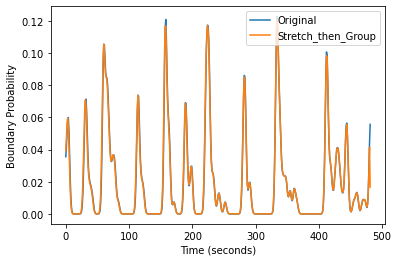

In [567]:
# # for validation purpose of sketching gt_freqs
# plt.figure()
# plt.plot(seg_video.gt_freqs[4:], label='Original')
# plt.plot(human_segmentation / 3, label='Stretch_then_Group')
# plt.xlabel('Time (seconds)')
# plt.ylabel('Boundary Probability')
# plt.legend()
# plt.show()

### Multiple Tags, Each with Multiple Simulations

In [383]:
biserial_all_long = biserial_all_long[biserial_all_long.variable != "human"]

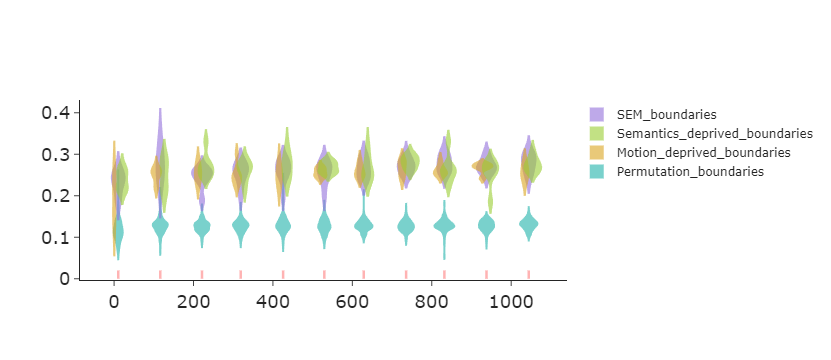

In [387]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['SEM_boundaries', 'Motion_deprived_boundaries', 'Semantics_deprived_boundaries']
shifts = [0, -10, 10, 0]
width = 50
point = False

ranks = [0, 2, 1, 3, 4, 5]

df = biserial_all_long[(biserial_all_long.variable == 'bi_shuffle_h_fair')
                       & (biserial_all_long.tag.isin(update_tags_3m17_more))
                      ]
fig.add_trace(
    go.Violin(x=df.training_time, y=df.value, name=f"Permutation_boundaries", fillcolor=colors[0], 
              line_color=colors[0], opacity=0.6, points=point, width=width,
              legendrank=ranks[4])
)
for i, tags in enumerate([update_tags_3m17_more[:8], update_tags_nomo_3m17_correct[:8], 
                          update_tags_nose_3m17_correct[8:]]):
    df = biserial_all_long[(biserial_all_long.variable == 'bi') & (biserial_all_long.tag.isin(tags))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df.value, name=f"{tag_names[i]}", 
                  fillcolor=colors[i+1], line_color=colors[i+1], opacity=0.6, points=point, width=width,
                  legendrank=ranks[i])
    )
    # df = biserial_all_long[(biserial_all_long.variable == 'bi_shuffle_h_fair') & (biserial_all_long.tag.isin(tags))]
    # fig.add_trace(
    #     go.Violin(x=df.training_time+shifts[i], y=df.value, name=f"{tag_names[i]}_perm", 
    #               fillcolor=colors[i+1], line_color=colors[i+1], opacity=0.6, points=False, width=30)
    # )

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
# fig.update_xaxes(title=dict(text="Amount of Training (minutes)"))
# fig.update_yaxes(title=dict(text="Scaled Point-biserial"))
# fig.update_layout(width=500)
# fig.update_layout(title="Compare Segmentation Agreement Between Full and Lesioned Models", title_x=0.5)
fig.update_layout(shapes=[{'type': 'line','y0':0,'y1': 0.05 * 0.4,
                           'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in biserial_select.training_time.unique()])
fig.show()

In [241]:
biserial_end = biserial_all_long[(biserial_all_long.epoch > 90) & (biserial_all_long.variable == 'bi')]
stats.ttest_ind(biserial_end[biserial_end['tag'].isin(update_tags_3m17_more)]['value'].dropna(),
                biserial_end[biserial_end['tag'].isin(update_tags_nose_3m17_correct)]['value'].dropna(),
                alternative='greater')

Ttest_indResult(statistic=0.3192733390430181, pvalue=0.3753234778748664)

In [237]:
biserial_end[biserial_end['tag'].isin(update_tags_nose_3m17_correct)]

,epoch,tag,variable,value,training_time
2024,101.0,aug_18_no_semantics_off_update_1010_1E-03_1E-0...,bi,0.265416,1044.249744
2035,101.0,aug_18_no_semantics_off_update_1020_1E-03_1E-0...,bi,0.271920,1044.249744
2046,101.0,aug_18_no_semantics_off_update_1030_1E-03_1E-0...,bi,0.251947,1044.249744
2057,101.0,aug_18_no_semantics_off_update_1040_1E-03_1E-0...,bi,0.257673,1044.249744
2068,101.0,aug_18_no_semantics_off_update_1050_1E-03_1E-0...,bi,0.244548,1044.249744
2079,101.0,aug_18_no_semantics_off_update_1070_1E-03_1E-0...,bi,0.256208,1044.249744
2090,101.0,aug_18_no_semantics_off_update_1080_1E-03_1E-0...,bi,0.262088,1044.249744
2101,101.0,aug_18_no_semantics_off_update_1090_1E-03_1E-0...,bi,0.307040,1044.249744
2112,101.0,aug_18_no_semantics_off_update_1100_1E-03_1E-0...,bi,0.261471,1044.249744
2123,101.0,aug_18_no_semantics_off_update_1110_1E-03_1E-0...,bi,0.258938,1044.249744


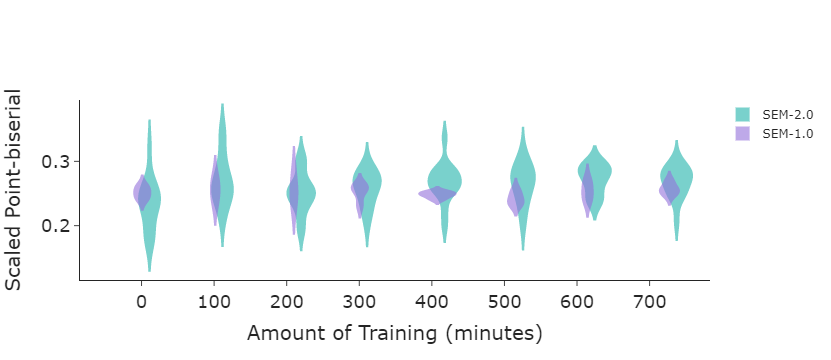

In [283]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['SEM_boundaries', 'Motion_deprived_boundaries', 'Semantics_deprived_boundaries']
shifts = [0, -10, 10, 0]
width = 50
point = False

ranks = [0, 2, 1, 3, 4, 5]

df = biserial_all_long[(biserial_all_long.variable == 'bi_shuffle_h_fair')
                       & (biserial_all_long.tag.isin(update_tags_3m17_more))
                      ]
fig.add_trace(
    go.Violin(x=df.training_time, y=df.value, name=f"Permutation_boundaries", fillcolor=colors[0], 
              line_color=colors[0], opacity=0.6, points=point, width=width,
              legendrank=ranks[4])
)
for i, tags in enumerate([update_tags_3m17_more[:8], update_tags_nomo_3m17_correct[:8], 
                          update_tags_nose_3m17_correct[8:]]):
    df = biserial_all_long[(biserial_all_long.variable == 'bi') & (biserial_all_long.tag.isin(tags))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df.value, name=f"{tag_names[i]}", 
                  fillcolor=colors[i+1], line_color=colors[i+1], opacity=0.6, points=point, width=width,
                  legendrank=ranks[i])
    )
    # df = biserial_all_long[(biserial_all_long.variable == 'bi_shuffle_h_fair') & (biserial_all_long.tag.isin(tags))]
    # fig.add_trace(
    #     go.Violin(x=df.training_time+shifts[i], y=df.value, name=f"{tag_names[i]}_perm", 
    #               fillcolor=colors[i+1], line_color=colors[i+1], opacity=0.6, points=False, width=30)
    # )

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
# fig.update_xaxes(title=dict(text="Amount of Training (minutes)"))
# fig.update_yaxes(title=dict(text="Scaled Point-biserial"))
# fig.update_layout(width=500)
# fig.update_layout(title="Compare Segmentation Agreement Between Full and Lesioned Models", title_x=0.5)
fig.show()

### Compare to Humans

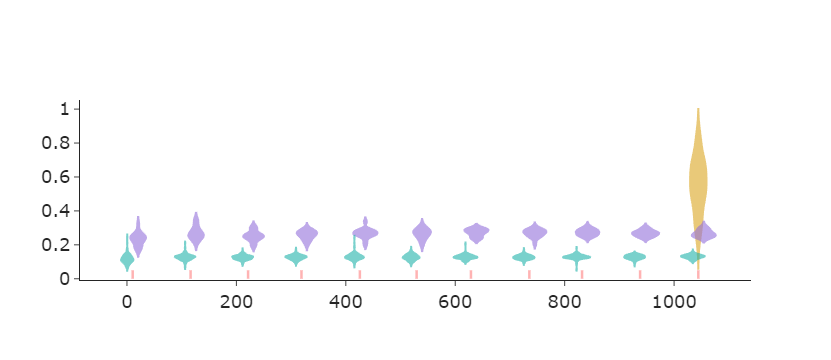

In [382]:
fig = go.Figure()
biserial_select = biserial_all_long[(biserial_all_long.tag.isin(update_tags_3m17_more + ['human']))]
df = biserial_select[(biserial_select.variable == 'human') & (biserial_select.epoch == 101)]
df = df.sample(n=100)
fig.add_trace(
    go.Violin(x=df.training_time, y=df.value, name=f"Human-to-human", fillcolor=colors[2],
              line_color=colors[2], opacity=0.6, points=False, width=30)
)
df = biserial_select[(biserial_select.variable == 'bi')]
fig.add_trace(
    go.Violin(x=df.training_time+10, y=df.value, name=f"SEM-to-human", fillcolor=colors[1], 
              line_color=colors[1], opacity=0.6, points=False, width=50)
)
df = biserial_select[(biserial_select.variable == 'bi_shuffle_h_fair')]
fig.add_trace(
    go.Violin(x=df.training_time-10, y=df.value, name=f"Perm", fillcolor=colors[0], 
              line_color=colors[0], opacity=0.6, points=False, width=50)
)
fig.update_layout(layout, showlegend=False)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
# fig.update_layout(title=dict(text="Segmentation Agreement with Human Normative Group"))
# fig.update_xaxes(title=dict(text="Amount of Training (minutes)"))
# fig.update_yaxes(title=dict(text='Scaled Correlation \n\nwith Human Segmentation'))
fig.update_layout(shapes=[{'type': 'line','y0':0,'y1': 0.05,'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in biserial_select.training_time.unique()])
fig.show()

#### Statistical Tests

In [175]:
biserial_end = biserial_select[biserial_select.epoch > 100]
stats.ttest_ind(biserial_end[biserial_end['variable'] == 'bi']['value'],
                biserial_end[biserial_end['variable'] == 'bi_shuffle_h_fair']['value'].dropna(),
                alternative='greater')

Ttest_indResult(statistic=38.924917035491305, pvalue=4.2072969720668926e-88)

In [173]:
biserial_end[biserial_end['variable'] == 'bi_shuffle_h_fair']['value']

11484         NaN
11485    0.125722
11486    0.136266
11487    0.109872
11488    0.128951
           ...   
12887    0.138650
12888    0.144321
12889    0.142461
12890    0.143789
12891    0.139316
Name: value, Length: 352, dtype: float64

In [141]:
# fig = px.strip(biserial_all_long.drop_duplicates(), x="epoch", y="value", color="variable",
#                 title="Segmentation Agreement with Humans")
# fig.update_layout(plot_bgcolor="white")
# fig

### Compare to Generic Models

In [384]:
biserial_all_long = biserial_all_long[biserial_all_long.tag != 'human']

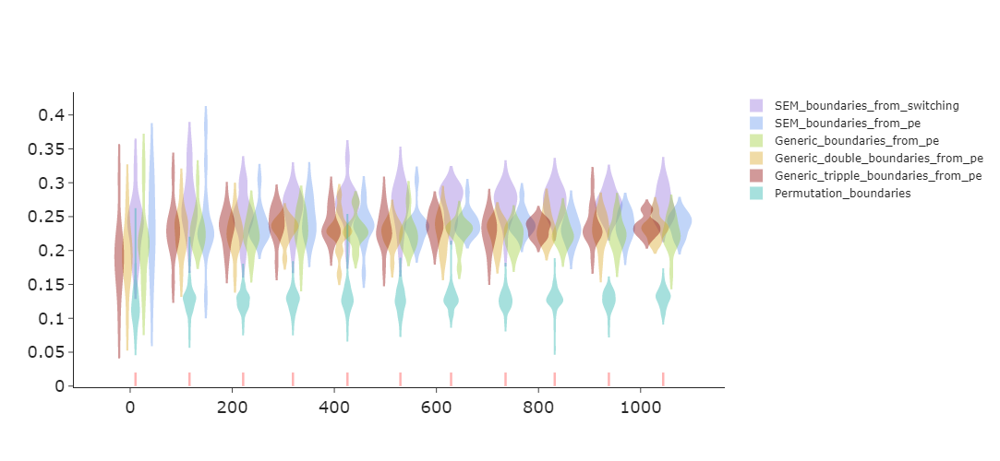

In [386]:
fig = go.Figure()
point = False
width = 50
biserial_select = biserial_all_long[(biserial_all_long.tag.isin(update_tags_3m17_more))]

df = biserial_select[(biserial_select.variable == 'bi')]
fig.add_trace(
    go.Violin(x=df.training_time, y=df.value, name=f"SEM_boundaries_from_switching", fillcolor=colors[1], 
              line_color=colors[1], opacity=0.4, points=point, width=width,
              scalemode='width', scalegroup="a")
)
df = biserial_select[(biserial_select.variable == 'bi_pe')]
fig.add_trace(
    go.Violin(x=df.training_time+16*2, y=df.value, name=f"SEM_boundaries_from_pe", fillcolor=colors[4], 
              line_color=colors[4], opacity=0.4, points=point, width=width,
              scalemode='width', scalegroup="a")
)
df = biserial_select[(biserial_select.variable == 'bi_pe_w')]
fig.add_trace(
    go.Violin(x=df.training_time+8*2, y=df.value, name=f"Generic_boundaries_from_pe", fillcolor=colors[3], 
              line_color=colors[3], opacity=0.4, points=point, width=width,
              scalemode='width', scalegroup="a")
)
df = biserial_select[(biserial_select.variable == 'bi_pe_w2')]
fig.add_trace(
    go.Violin(x=df.training_time-8*2, y=df.value, name=f"Generic_double_boundaries_from_pe", fillcolor=colors[2], 
              line_color=colors[2], opacity=0.4, points=point, width=width,
              scalemode='width', scalegroup="a")
)
df = biserial_select[(biserial_select.variable == 'bi_pe_w3')]
fig.add_trace(
    go.Violin(x=df.training_time-16*2, y=df.value, name=f"Generic_tripple_boundaries_from_pe", fillcolor=colors[5], 
              line_color=colors[5], opacity=0.4, points=point, width=width,
              scalemode='width', scalegroup="a")
)
df = biserial_select[(biserial_select.variable == 'bi_shuffle_h_fair')]
fig.add_trace(
    go.Violin(x=df.training_time, y=df.value, name=f"Permutation_boundaries", fillcolor=colors[0], 
              line_color=colors[0], opacity=0.4, points=False, width=30,
              scalemode='width', scalegroup="a")
)

    
fig.update_layout(layout)
fig.update_layout(height=500)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
# fig.update_layout(showlegend=True, margin=dict(l=30, r=30, t=30, b=30))
# fig.update_yaxes(title=dict(text="Scaled Correlation"))
# fig.update_xaxes(title=dict(text="Amount of Training (minutes)"))
# fig.update_layout(title="Compare Segmentation Agreement Between Full and Lesioned Models", title_x=0.5)
fig.update_layout(shapes=[{'type': 'line','y0':0,'y1': 0.05 * 0.4,'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in biserial_select.training_time.unique()])
fig.show()

#### Statistical Tests

In [181]:
biserial_select = biserial_all_long[(biserial_all_long.tag.isin(update_tags_3m17_more))]
biserial_end = biserial_select[(biserial_select.epoch > 100)]
stats.ttest_ind(biserial_end[biserial_end['variable'].isin(['bi'])]['value'],
                biserial_end[biserial_end['variable'] == 'bi_pe_w']['value'].dropna(),
                alternative='greater')

Ttest_indResult(statistic=5.5476968259217685, pvalue=2.482139721413479e-06)

In [176]:
biserial_select.variable.unique()

array(['bi', 'bi_shuffle_h_fair', 'bi_pe', 'bi_pe_w2', 'bi_pe_w3',
       'bi_pe_w', 'human'], dtype=object)

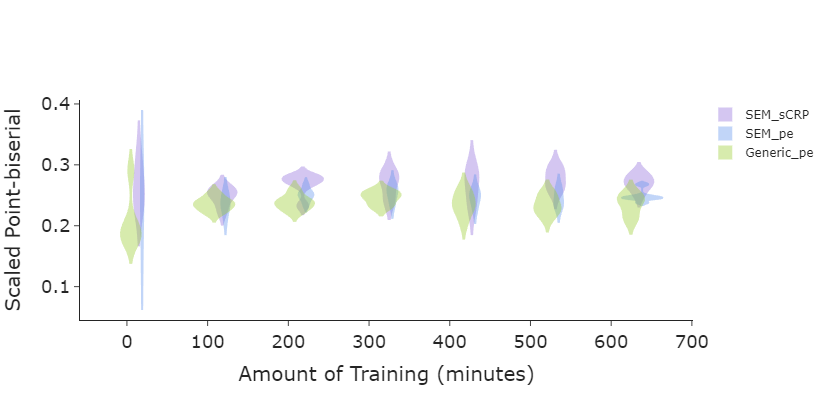

In [671]:
fig = go.Figure()
point = False
width = 50
biserial_select = biserial_all_long[(biserial_all_long.tag.isin(update_tags_306))]
# df = biserial_select[(biserial_select.variable == 'bi_shuffle_h_fair')]
# fig.add_trace(
#     go.Violin(x=df.training_time, y=df.value, name=f"Perm", fillcolor=colors[0], 
#               line_color=colors[0], opacity=0.4, points=False, width=30,
#               scalemode='width', scalegroup="a")
# )
df = biserial_select[(biserial_select.variable == 'bi')]
fig.add_trace(
    go.Violin(x=df.training_time+4, y=df.value, name=f"SEM_sCRP", fillcolor=colors[1], 
              line_color=colors[1], opacity=0.4, points=point, width=width,
              scalemode='width', scalegroup="a")
)
df = biserial_select[(biserial_select.variable == 'bi_pe')]
fig.add_trace(
    go.Violin(x=df.training_time+8, y=df.value, name=f"SEM_pe", fillcolor=colors[4], 
              line_color=colors[4], opacity=0.4, points=point, width=width,
              scalemode='width', scalegroup="a")
)
df = biserial_select[(biserial_select.variable == 'bi_pe_w')]
fig.add_trace(
    go.Violin(x=df.training_time-6, y=df.value, name=f"Generic_pe", fillcolor=colors[3], 
              line_color=colors[3], opacity=0.4, points=point, width=width,
              scalemode='width', scalegroup="a")
)
# df = biserial_select[(biserial_select.variable == 'bi_pe_w2')]
# fig.add_trace(
#     go.Violin(x=df.training_time-3, y=df.value, name=f"Generic_pe2", fillcolor=colors[2], 
#               line_color=colors[2], opacity=0.4, points=point, width=width,
#               scalemode='width', scalegroup="a")
# )
# df = biserial_select[(biserial_select.variable == 'bi_pe_w3')]
# fig.add_trace(
#     go.Violin(x=df.training_time-9, y=df.value, name=f"Generic_pe3", fillcolor=colors[5], 
#               line_color=colors[5], opacity=0.4, points=point, width=width,
#               scalemode='width', scalegroup="a")
# )

    
fig.update_layout(layout)
fig.update_layout(width=600, height=400)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
# fig.update_layout(showlegend=True, margin=dict(l=30, r=30, t=30, b=30))
fig.update_yaxes(title=dict(text="Scaled Point-biserial"))
fig.update_xaxes(title=dict(text="Amount of Training (minutes)"))
# fig.update_layout(title="Compare Segmentation Agreement Between Full and Lesioned Models", title_x=0.5)
fig.show() 

## Segmentation for Single Activities

In [10]:
df_boundary = deepcopy(schemadf[['run', 'epoch', 'event_boundary', 'gt_freqs', 'tag']])
df_boundary.head(5)

,run,epoch,event_boundary,gt_freqs,tag
0,4.4.2,41,0,0.031481,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07
1,4.4.2,41,1,0.031721,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07
2,4.4.2,41,1,0.031541,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07
3,4.4.2,41,0,0.031360,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07
4,4.4.2,41,0,0.030446,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07


In [11]:
df_boundary.tag.unique()

array(['july_18_full_.8_.8_1010_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1020_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1030_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1040_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1050_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1060_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1070_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1080_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1090_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1100_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1110_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1120_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1130_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1140_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1150_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1160_1E-03_1E-01_1E+07',
       'july_28_no_motion_1030_1E-03_1E-01_1E+07',
       'july_28_no_motion_1040_1E-03_1E-01_1E+07',
       'july_28_no_motion_1080_1E-03_1E-01_1E+07',
       'july_28

In [33]:
df_boundary_one_run = deepcopy(df_boundary[(df_boundary.epoch == 101) 
                                           & (df_boundary.tag == update_tags_3m17_more[0])
                                           # & (df_boundary.run == "6.3.4")
                                          ])
# df_boundary_one_run = deepcopy(df_boundary[(df_boundary.run == "6.3.4") & (df_boundary.epoch == "46") & (df_boundary.tag == "june_19_1010_lr1E-03_alfa1E-01_lmda1E+05")])
df_boundary_one_run.head(5)

,run,epoch,event_boundary,gt_freqs,tag
8217795,1.2.7,101,0,0.037132,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07
8217796,1.2.7,101,1,0.039341,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07
8217797,1.2.7,101,0,0.041551,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07
8217798,1.2.7,101,0,0.044356,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07
8217799,1.2.7,101,0,0.047396,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07


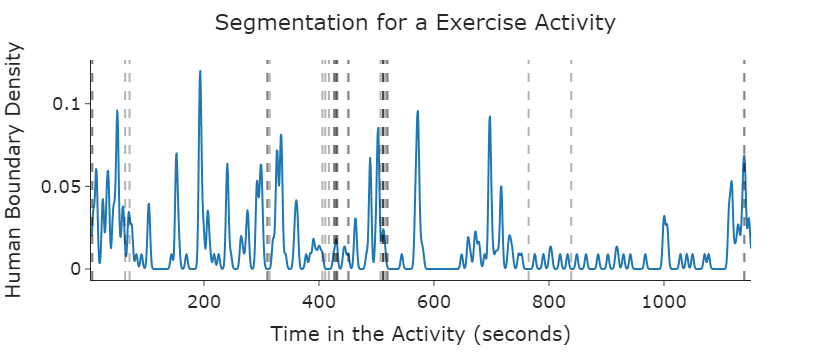

In [87]:
fig = go.Figure()
shapes = list()
y_max = df_boundary_one_run.gt_freqs.max()
def plot_one_run(run):
    diagnostic_readouts = pkl.load(open(f'output/run_sem/{update_tags_3m17_more[2]}/{run}_kinect_trim{update_tags_3m17_more[2]}_diagnostic_101.pkl', 'rb'))
    first_second = diagnostic_readouts['first_frame'] / diagnostic_readouts['fps']
    df_select = df_boundary_one_run[df_boundary_one_run.run == run].copy()
    time = [first_second + 1/3 * x for x in range(len(df_select))]
    df_select['time'] = time
    fig = px.line(df_select, x='time', y="gt_freqs")
    for _, row in df_select.iterrows():
        if row.event_boundary == 1:
            # add_vline update layout, thus cannot use the add_trace trick.
            fig.add_vline(x=row.time, line_width=2, line_dash="dash", line_color="black")
    # use update_layout to add shapes (lines).
    return fig
fig = plot_one_run('6.1.8')
fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(title_text="Segmentation for a Exercise Activity")
fig.update_xaxes(title_text="Time in the Activity (seconds)")
fig.update_yaxes(title_text="Human Boundary Density")
fig.show()

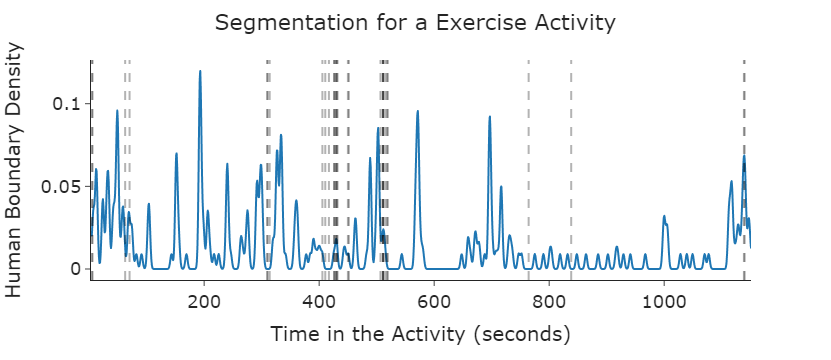

In [93]:
fig = go.Figure()
shapes = list()
y_max = df_boundary_one_run.gt_freqs.max()
def plot_one_run(run):
    diagnostic_readouts = pkl.load(open(f'output/run_sem/{update_tags_3m17_more[2]}/{run}_kinect_trim{update_tags_3m17_more[2]}_diagnostic_101.pkl', 'rb'))
    first_second = diagnostic_readouts['first_frame'] / diagnostic_readouts['fps']
    df_select = df_boundary_one_run[df_boundary_one_run.run == run].copy()
    time = [first_second + 1/3 * x for x in range(len(df_select))]
    df_select['time'] = time
    fig = px.line(df_select, x='time', y="gt_freqs")
    for _, row in df_select.iterrows():
        if row.event_boundary == 1:
            # add_vline update layout, thus cannot use the add_trace trick.
            fig.add_vline(x=row.time, line_width=2, line_dash="dash", line_color="black")
    # use update_layout to add shapes (lines).
    return fig
fig = plot_one_run('6.1.8')
fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(title_text="Segmentation for a Exercise Activity")
fig.update_xaxes(title_text="Time in the Activity (seconds)")
fig.update_yaxes(title_text="Human Boundary Density")
fig.show()

In [34]:
fig = make_subplots(rows=7, cols=3, shared_yaxes=True, 
                    subplot_titles=valid_runs)
shapes = list()
y_max = df_boundary_one_run.gt_freqs.max()
def plot_one_run(i, run):
    df_select = df_boundary_one_run[df_boundary_one_run.run == run].copy()
    diagnostic_readouts = pkl.load(open(f'output/run_sem/{update_tags_3m17_more[2]}/{run}_kinect_trim{update_tags_3m17_more[2]}_diagnostic_101.pkl', 'rb'))
    first_second = diagnostic_readouts['first_frame'] / diagnostic_readouts['fps']
    time = [first_second + 1/3 * x for x in range(len(df_select))]
    df_select['time'] = time
    fig_sub = px.line(df_select, x='time', y="gt_freqs")
    fig.add_trace(
        fig_sub.data[0], col=i%3+1, row=i//3+1
    )

    # for _, row in df_select.iterrows():
    #     if row.event_boundary == 1:
    #         # add_vline update layout, thus cannot use the add_trace trick.
    #         fig.add_vline(x=row.time, line_width=1, line_dash="dash", line_color="green", col=i%4+1, row=i//4+1)
    # use update_layout to add shapes (lines).
    def add_line(row):
        if row.event_boundary == 1:
            return {'type': 'line',
               'line': dict(color="black",width=1,dash="dot",),
               'xref': f'x{i+1}',
               'yref': f'y{i+1}',
               'x0': row.time,
               'y0': 0,
               'x1': row.time,
               'y1': y_max
              }
        return {}
    shapes.extend(Parallel(n_jobs=16)(delayed(add_line)(row) for _, row in df_select.iterrows()))

In [35]:
y_max

0.1613539905499962

In [36]:
for i, run in zip(range(0, len(valid_runs)), valid_runs):
    plot_one_run(i, run)

In [37]:
shapes = [x for x in shapes if len(x)]

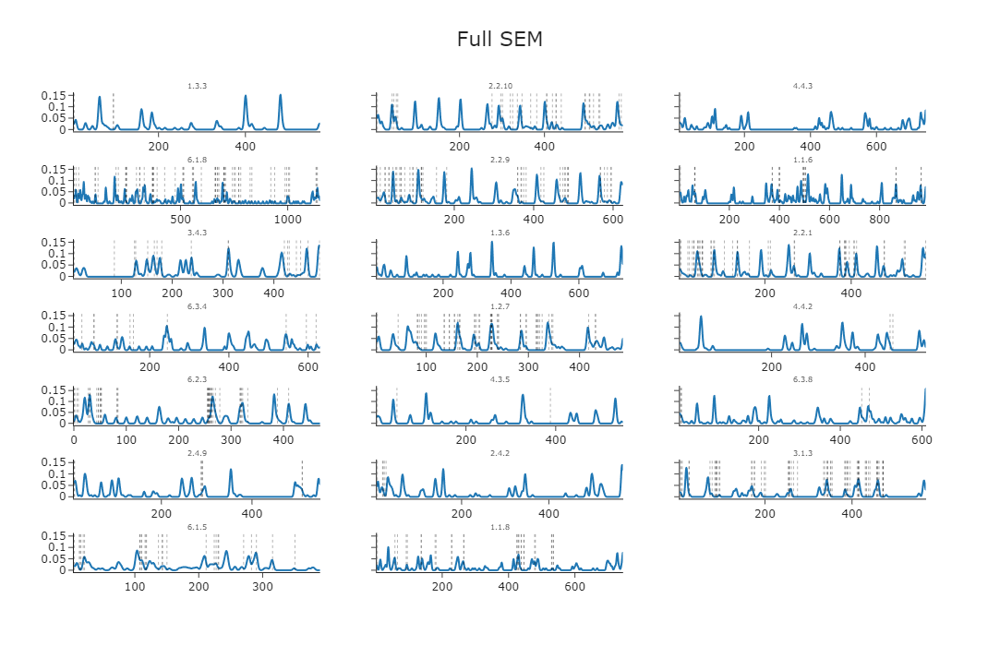

In [39]:
fig.update_layout(layout, shapes=shapes, title_text="Full SEM")
fig.for_each_annotation(lambda a: a.update(font=dict(size=8)))
fig.update_layout(width=800, height=700)
fig.show()

In [108]:
fig.print_grid()

This is the format of your plot grid:
[ (1,1) x,y     ]  [ (1,2) x2,y2   ]  [ (1,3) x3,y3   ]
[ (2,1) x4,y4   ]  [ (2,2) x5,y5   ]  [ (2,3) x6,y6   ]
[ (3,1) x7,y7   ]  [ (3,2) x8,y8   ]  [ (3,3) x9,y9   ]
[ (4,1) x10,y10 ]  [ (4,2) x11,y11 ]  [ (4,3) x12,y12 ]
[ (5,1) x13,y13 ]  [ (5,2) x14,y14 ]  [ (5,3) x15,y15 ]
[ (6,1) x16,y16 ]  [ (6,2) x17,y17 ]  [ (6,3) x18,y18 ]
[ (7,1) x19,y19 ]  [ (7,2) x20,y20 ]  [ (7,3) x21,y21 ]



In [166]:
df_boundary = deepcopy(schemadf[['run', 'epoch', 'event_boundary', 'gt_freqs', 'pe', 'tag']])
df_boundary_one_run = deepcopy(df_boundary[(df_boundary.epoch == 101) 
                                           & (df_boundary.tag == update_tags_3m17_more[2])
                                           & (df_boundary.run == "6.3.4")
                                          ])
df_boundary_one_run.head(5)
df_select = deepcopy(df_boundary_one_run)
time = [1/3 * x for x in range(len(df_select))]
df_select['time'] = time
fig = px.line(df_select, x='time', y='pe')

In [167]:
shapes = []
def add_line(row):
    if row.event_boundary == 1:
        return {'type': 'line',
           'line': dict(color="black",width=1,dash="dot",),
           # 'xref': f'x{i+1}',
           # 'yref': f'y{i+1}',
           'x0': row.time,
           'y0': 0,
           'x1': row.time,
           'y1': 2
          }
    return {}
shapes.extend(Parallel(n_jobs=16)(delayed(add_line)(row) for _, row in df_select.iterrows()))
shapes = [x for x in shapes if len(x)]

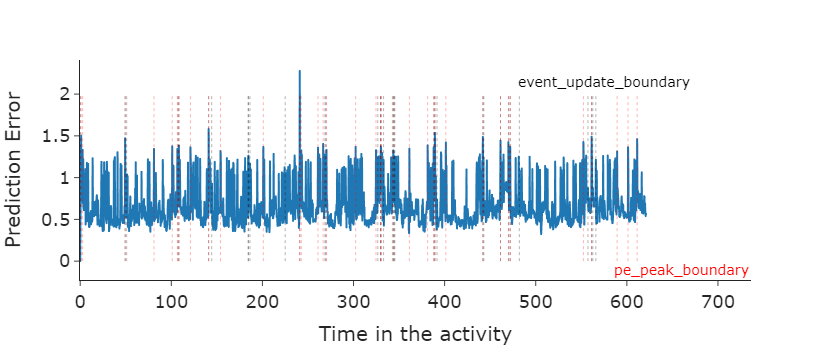

In [168]:
shapes_pe = []
for i, row in df_select.loc[df_select.nlargest(df_select.event_boundary.sum(), f'pe').index, ].iterrows():
    shapes_pe.extend([{'type': 'line',
           'line': dict(color="red", width=1, dash="dot",),
           # 'xref': f'x{i+1}',
           # 'yref': f'y{i+1}',
           'x0': row.time,
           'y0': 0,
           'x1': row.time,
           'y1': 2
          }])
fig.update_layout(layout, shapes=shapes + shapes_pe)
fig.update_xaxes(x_axis, title_text="Time in the activity")
fig.update_yaxes(y_axis, title_text="Prediction Error")
fig.add_annotation(x=575, y=2.15,
        text="event_update_boundary",
        font=dict(
        # family="sans serif",
        size=14,
        color='black'
        ),
        showarrow=False,
        )
fig.add_annotation(x=660, y=-0.1,
        text="pe_peak_boundary",
        font=dict(
        # family="sans serif",
        size=14,
        color='red'
        ),
        showarrow=False,
        )

## Boundary Probability (exp)

In [130]:
def compute_pearsonr_overall(schemadf, valid_only=True, permute=0):
    pearson_all = pd.DataFrame()
    sdf = deepcopy(schemadf)
    if valid_only:
        sdf = sdf[sdf['run'].isin(valid_runs)]

    for epoch in tqdm(sdf.epoch.unique()):
        for tag in (sdf.tag.unique()):
            edf = sdf[(sdf['epoch'] == epoch) & (sdf['tag'] == tag)]
            if len(edf) == 0:
                continue
            pearsonr, _ = stats.pearsonr(edf['boundary_prob'], edf['gt_freqs'])
            tempdf = pd.DataFrame({'epoch': epoch, 'tag': tag, 'pearsonr': [pearsonr], 'pearsonr_shuffle': np.nan})
            for i in range(permute):
                shuffled = edf['boundary_prob'].iloc[np.random.choice(range(len(edf['boundary_prob'])), size=len(edf['boundary_prob']), replace=False)]
                pearsonr_shuffle, _ = stats.pearsonr(shuffled, edf['gt_freqs'])
                tempdf = pd.concat([tempdf, pd.DataFrame({'epoch': epoch, 'tag': tag, 'pearsonr': [pearsonr], 'pearsonr_shuffle': pearsonr_shuffle})])
            pearson_all = pd.concat([pearson_all, tempdf])

    pearson_all['epoch'] = pearson_all['epoch'].astype('int')
    return pearson_all

In [131]:
pearsonr_all = compute_pearsonr_overall(schemadf, permute=50)
pearsonr_all

100%|██████████████████████████████████████████████████████████████████████| 20/20 [00:08<00:00,  2.39it/s]


,epoch,tag,pearsonr,pearsonr_shuffle
0,5,jan_25_lr_normal_grid_lr1E-03_alfa1E-01_lmda1E+05,-0.012372,NaN
0,5,jan_25_lr_normal_grid_lr1E-03_alfa1E-01_lmda1E+05,-0.012372,-0.008944
0,5,jan_25_lr_normal_grid_lr1E-03_alfa1E-01_lmda1E+05,-0.012372,-0.000840
0,5,jan_25_lr_normal_grid_lr1E-03_alfa1E-01_lmda1E+05,-0.012372,0.001989
0,5,jan_25_lr_normal_grid_lr1E-03_alfa1E-01_lmda1E+05,-0.012372,0.000442
...,...,...,...,...
0,16,jan_25_lr_normal_grid_lr1E-03_alfa1E-01_lmda1E+05,0.004928,-0.007148
0,16,jan_25_lr_normal_grid_lr1E-03_alfa1E-01_lmda1E+05,0.004928,-0.000915
0,16,jan_25_lr_normal_grid_lr1E-03_alfa1E-01_lmda1E+05,0.004928,0.002255
0,16,jan_25_lr_normal_grid_lr1E-03_alfa1E-01_lmda1E+05,0.004928,-0.005911


In [305]:
pearsonr_all_long = pd.melt(pearsonr_all, id_vars = ["epoch", "tag"], value_vars=['pearsonr', 'pearsonr_shuffle'])

NameError: name 'pearsonr_all' is not defined

In [304]:
fig = go.Figure()
for i, tag in enumerate(sorted(pearsonr_all_long.tag.unique())):
    df = pearsonr_all_long[(pearsonr_all_long.variable != 'pearsonr') & (pearsonr_all_long.tag == tag)]
    fig.add_trace(
        go.Violin(x=df.epoch, y=df.value, name=f"{tag}", fillcolor=colors[i], line_color=colors[i], opacity=0.6)
    )
    df = pearsonr_all_long[(pearsonr_all_long.variable == 'pearsonr') & (pearsonr_all_long.tag == tag)]
    fig.add_trace(
        go.Scatter(x=df.epoch, y=df.value, mode="markers", name=f"{tag}", marker=dict(color=colors[i+1]), opacity=0.6)
    )
fig.update_layout(showlegend=False, margin=dict(l=30, r=30, t=30, b=30))
fig.update_layout(yaxis = dict(tickfont=dict(size=20)))
fig.update_layout(xaxis = dict(tickfont=dict(size=20)))
fig.update_layout(title="Boundary Probability for SEM and Permutations, Average", title_x=0.5)
fig.show()

NameError: name 'pearsonr_all_long' is not defined

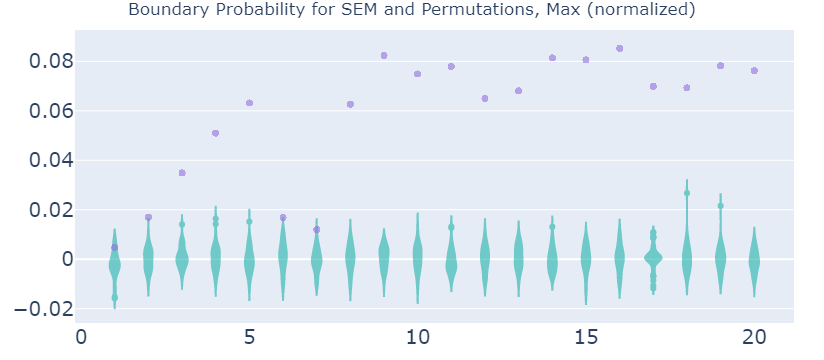

In [95]:
fig = go.Figure()
for i, tag in enumerate(sorted(pearsonr_all_long.tag.unique())):
    df = pearsonr_all_long[(pearsonr_all_long.variable != 'pearsonr') & (pearsonr_all_long.tag == tag)]
    fig.add_trace(
        go.Violin(x=df.epoch, y=df.value, name=f"{tag}", fillcolor=colors[i], line_color=colors[i], opacity=0.6)
    )
    df = pearsonr_all_long[(pearsonr_all_long.variable == 'pearsonr') & (pearsonr_all_long.tag == tag)]
    fig.add_trace(
        go.Scatter(x=df.epoch, y=df.value, mode="markers", name=f"{tag}", marker=dict(color=colors[i+1]), opacity=0.6)
    )
fig.update_layout(showlegend=False, margin=dict(l=30, r=30, t=30, b=30))
fig.update_layout(yaxis = dict(tickfont=dict(size=20)))
fig.update_layout(xaxis = dict(tickfont=dict(size=20)))
fig.update_layout(title="Boundary Probability for SEM and Permutations, Max", title_x=0.5)
fig.show()

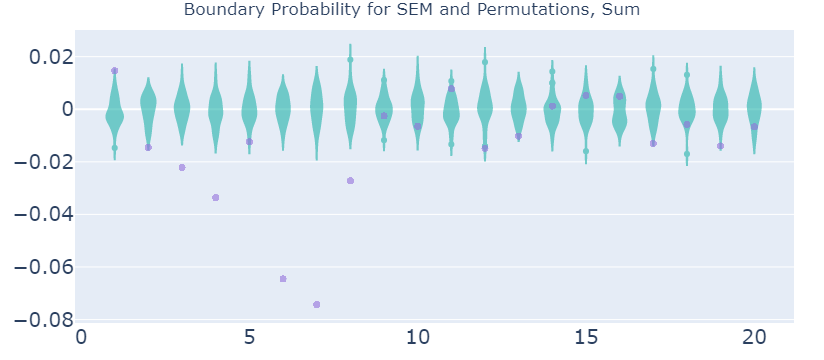

In [134]:
fig = go.Figure()
for i, tag in enumerate(sorted(pearsonr_all_long.tag.unique())):
    df = pearsonr_all_long[(pearsonr_all_long.variable != 'pearsonr') & (pearsonr_all_long.tag == tag)]
    fig.add_trace(
        go.Violin(x=df.epoch, y=df.value, name=f"{tag}", fillcolor=colors[i], line_color=colors[i], opacity=0.6)
    )
    df = pearsonr_all_long[(pearsonr_all_long.variable == 'pearsonr') & (pearsonr_all_long.tag == tag)]
    fig.add_trace(
        go.Scatter(x=df.epoch, y=df.value, mode="markers", name=f"{tag}", marker=dict(color=colors[i+1]), opacity=0.6)
    )
fig.update_layout(showlegend=False, margin=dict(l=30, r=30, t=30, b=30))
fig.update_layout(yaxis = dict(tickfont=dict(size=20)))
fig.update_layout(xaxis = dict(tickfont=dict(size=20)))
fig.update_layout(title="Boundary Probability for SEM and Permutations, Sum", title_x=0.5)
fig.show()

# Prediction Error


## Prepare PE Dataframe

In [43]:
df_pe = deepcopy(schemadf[['run', 'epoch', 'pe', 'pe_w', 'pe_w2', 'pe_w3', 'tag']])
df_pe = df_pe[df_pe.run.isin(valid_runs)]
df_pe.epoch = df_pe.epoch.astype(int)
df_pe = df_pe.groupby(['epoch', 'run', 'tag']).mean().reset_index(level=['epoch', 'run', 'tag'])
df_pe_long = pd.melt(df_pe, id_vars=["epoch", "run", "tag"], value_vars=['pe', 'pe_w', 'pe_w2', 'pe_w3'])

In [44]:
df_pe_long.tag.unique()

array(['aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1020_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1050_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1060_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1070_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1080_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1010_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1020_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1030_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1040_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1050_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1070_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1080_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1090_1E-03_1E-01_1E+07',
       'aug_18_n

In [46]:
df_pe_long_avg = df_pe_long.groupby(['epoch', 'tag', 'variable'])['value'].mean().reset_index()
df_pe_long_avg.tail()

,epoch,tag,variable,value
2435,101,july_18_full_.8_.8_1150_1E-03_1E-01_1E+07,pe_w3,0.539205
2436,101,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,pe,0.593539
2437,101,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,pe_w,0.800881
2438,101,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,pe_w2,0.609405
2439,101,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,pe_w3,0.513498


In [47]:
# df_pe_long_avg = df_pe_long.groupby(['epoch', 'tag', 'run', 'variable'])['value'].mean().reset_index()
# df_pe_long_avg

In [48]:
df_pe_long_avg['training_time'] = df_pe_long_avg['epoch'].map(epoch_to_duration)
df_pe_long_avg['training_time'] = df_pe_long_avg['training_time'] / 60
df_pe_long_avg

,epoch,tag,variable,value,training_time
0,1,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,pe,1.541689,10.481734
1,1,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,pe_w,1.195211,10.481734
2,1,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,pe_w2,0.000000,10.481734
3,1,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,pe_w3,0.000000,10.481734
4,1,aug_17_no_skel_off_update_1020_1E-03_1E-01_1E+07,pe,1.212613,10.481734
...,...,...,...,...,...
2435,101,july_18_full_.8_.8_1150_1E-03_1E-01_1E+07,pe_w3,0.539205,1044.249744
2436,101,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,pe,0.593539,1044.249744
2437,101,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,pe_w,0.800881,1044.249744
2438,101,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,pe_w2,0.609405,1044.249744


## Multiple Tags, Each with Multiple Simulations

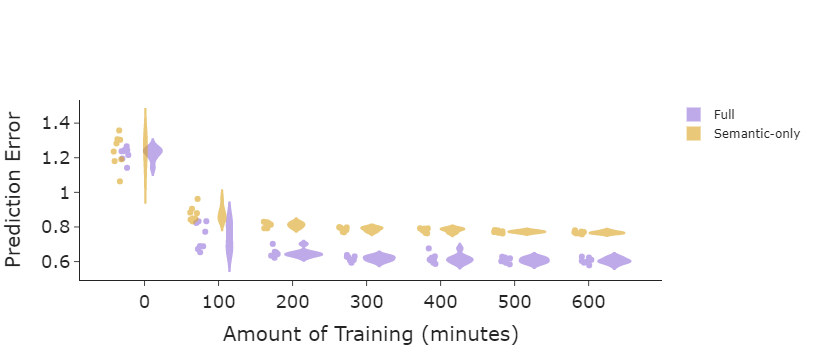

In [38]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['Full', 'Semantic-only', 'Motion-only']
shifts = [0, -10, 10]
point = 'all'
width = 50

# df = df_pe_long[(biserial_all_long.variable == 'bi_shuffle_h_fair') & (biserial_all_long.tag.isin(full_tags))]
# fig.add_trace(
#     go.Violin(x=df.training_time, y=df.value, name=f"Perm", 
#               fillcolor=colors[0], line_color=colors[0], opacity=0.6, points=False, width=30)
# )
for i, tags in enumerate([update_tags_3m17, update_tags_noskel_3m17[:8]]):
    df = df_pe_long_avg[(df_pe_long_avg.variable == 'pe') & (df_pe_long_avg.tag.isin(tags))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df.value, name=f"{tag_names[i]}", 
                  fillcolor=colors[i+1], line_color=colors[i+1], opacity=0.6,
                  points=point, width=width)
    )
    

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_xaxes(title=dict(text="Amount of Training (minutes)"))
fig.update_yaxes(title=dict(text="Prediction Error"))
# fig.update_layout(title="Compare Segmentation Agreement Between Full and Lesioned Models", title_x=0.5)
fig.show()

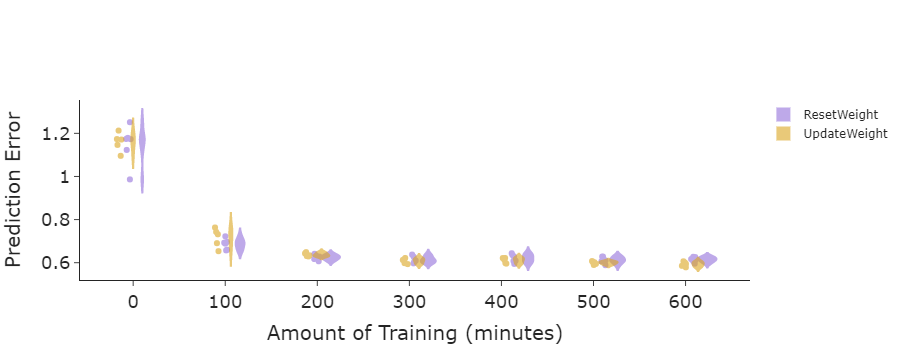

In [415]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['ResetWeight', 'UpdateWeight']
shifts = [0, -10, 10]

# df = df_pe_long[(biserial_all_long.variable == 'bi_shuffle_h_fair') & (biserial_all_long.tag.isin(full_tags))]
# fig.add_trace(
#     go.Violin(x=df.training_time, y=df.value, name=f"Perm", 
#               fillcolor=colors[0], line_color=colors[0], opacity=0.6, points=False, width=30)
# )
for i, tags in enumerate([full_tags, update_tags_305]):
    df = df_pe_long_avg[(df_pe_long_avg.variable == 'pe') & (df_pe_long_avg.tag.isin(tags))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df.value, name=f"{tag_names[i]}", 
                  fillcolor=colors[i+1], line_color=colors[i+1], opacity=0.6, points='all', width=20)
    )
    

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_xaxes(title=dict(text="Amount of Training (minutes)"))
fig.update_yaxes(title=dict(text="Prediction Error"))
# fig.update_layout(title="Compare Segmentation Agreement Between Full and Lesioned Models", title_x=0.5)
fig.show()

## Compare to Generic Models

In [100]:
df_pe_select = df_pe_long_avg[df_pe_long_avg.tag.isin(update_tags_3m17_more)]
df_pe_select

,epoch,tag,variable,value,training_time
188,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,pe,1.533384,10.481734
189,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,pe_w,1.139223,10.481734
190,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,pe_w2,1.070448,10.481734
191,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,pe_w3,1.027474,10.481734
192,1,july_18_full_.8_.8_1020_1E-03_1E-01_1E+07,pe,1.207254,10.481734
...,...,...,...,...,...
2435,101,july_18_full_.8_.8_1150_1E-03_1E-01_1E+07,pe_w3,0.539205,1044.249744
2436,101,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,pe,0.593539,1044.249744
2437,101,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,pe_w,0.800881,1044.249744
2438,101,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,pe_w2,0.609405,1044.249744


In [65]:
# retain run
df_pe_select = df_pe_select.groupby(['tag', 'training_time', 'run', 'variable'])
df_pe_select = df_pe_select.agg({'value': ['mean', 'std']}).reset_index()
df_pe_select.columns = ['_'.join(col) if len(col[1]) > 0 else col[0] for col in df_pe_select.columns]
# line_size = df_pe_select.groupby(['tag', 'run', 'variable'])['value_std'].mean().reset_index()
df_pe_select

KeyError: 'run'

In [57]:
# average for all validation runs
df_pe_select = df_pe_select.groupby(['tag', 'training_time', 'variable'])
df_pe_select = df_pe_select.agg({'value': ['mean', 'std']}).reset_index()
df_pe_select.columns = ['_'.join(col) if len(col[1]) > 0 else col[0] for col in df_pe_select.columns]
df_pe_select.tail()

,tag,training_time,variable,value_mean,value_std
699,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,937.848032,pe_w3,0.528536,NaN
700,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,1044.249744,pe,0.593539,NaN
701,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,1044.249744,pe_w,0.800881,NaN
702,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,1044.249744,pe_w2,0.609405,NaN
703,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,1044.249744,pe_w3,0.513498,NaN


In [101]:
# average for all validation runs, across tags (to plot error bars)
import scipy.stats as stat
df_pe_select = df_pe_select.groupby(['training_time', 'variable'])
df_pe_select = df_pe_select.agg({'value': ['mean', 'std', stat.sem]}).reset_index()
df_pe_select.columns = ['_'.join(col) if len(col[1]) > 0 else col[0] for col in df_pe_select.columns]
df_pe_select.tail()

,training_time,variable,value_mean,value_std,value_sem
39,937.848032,pe_w3,0.511009,0.021010,0.005253
40,1044.249744,pe,0.576904,0.015798,0.003949
41,1044.249744,pe_w,0.654347,0.075147,0.018787
42,1044.249744,pe_w2,0.551354,0.032020,0.008005
43,1044.249744,pe_w3,0.514886,0.024746,0.006186


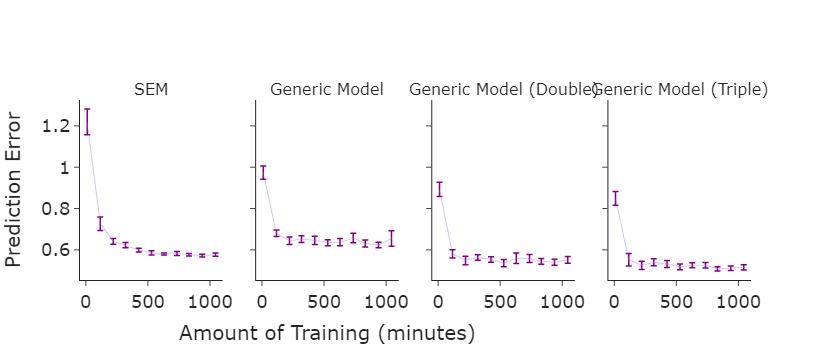

In [104]:
from plotly.subplots import make_subplots
pe_names = ['SEM', 'Generic Model', 'Generic Model (Double)', 'Generic Model (Triple)']
fig = make_subplots(
                    shared_yaxes=True,
                    rows=1, cols=4, 
                    subplot_titles=tuple(pe_names)
                   )
tag_names = ['SEM-2.0']
shifts = [-10, 10, 0, 0, 20, -20]
point = False
width = 50
# line_size = [2, 2, 4, 2]
# ranks = [0, 1, 2, 3, 4, 5]


for j, var in enumerate(['pe', 'pe_w', 'pe_w2', 'pe_w3']):
    df = df_pe_select[(df_pe_select.variable == var)]
    df = df.sort_values(by='training_time')
    # ls = float(line_size[(line_size.variable == var)]['value_std'])
    fig.add_trace(
        go.Scatter(x=df.training_time, y=df[f'value_mean'], 
                   mode="lines", 
                   # legendrank=ranks[i], 
                   fillcolor=colors[i+1], line_color=colors[i+1], 
                   error_y=dict(
                        type='data',
                        array=df[f'value_sem'].to_numpy() * 2,
                        color='purple',
                        thickness=1.5,
                        width=3,
                    ),
                   line=dict(width=0.4),
                   # points=point, width=width
                  ),
        row=j // 4 + 1, col=j % 4 + 1
    )
    

fig.update_layout(layout, 
                  # width=800, height=500, title_text="", 
                  # legend={'traceorder':'grouped'}
                 )
fig.update_xaxes(x_axis)
fig.update_xaxes(
                 title_text="Amount of Training (minutes)", row=1, col=2
                )
fig.update_yaxes(y_axis, title_text="Prediction Error", row=1, col=1)
fig.update_layout(#title=dict(text="Purity of SEM Action Categorization"),
                 showlegend=False)
# fig.update_layout(title_text="Average PE for all Validation activities (all simulations)")
# fig.for_each_annotation(lambda a: a.update(text=model_names[a.text.split('=')[-1]]))
# fig.update_xaxes(title_text="Amount of Training (minutes)")
# fig.update_yaxes(title_text=f"{metric}")

fig.show()

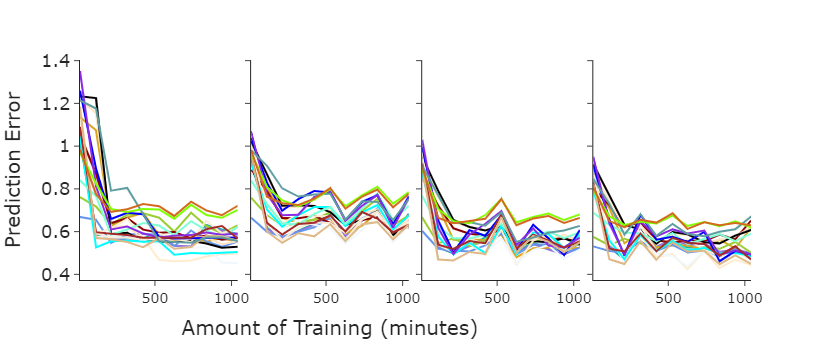

In [329]:
fig = px.line(data_frame=df_pe_select[df_pe_select.tag == update_tags_3m17_more[7]], 
                 x='training_time', y='value_mean', facet_col='variable', 
                 # facet_col_wrap=2,
                 color='run', color_discrete_sequence=colors,
                 labels=dict(value="Prediction Error", training_time="") 
                )
fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis, title_text='Prediction Error', row=1, col=1)
fig.update_layout(#title=dict(text="Compare Prediction Errors between SEM and Generic Models"),
                 showlegend=False)
fig.update_xaxes(tickfont=dict(size=14))
fig.update_xaxes(title_text="\t\t\t\tAmount of Training (minutes)", row=1, col=2)
model_names = {'pe': 'SEM', 'pe_w': 'Generic Model', 'pe_w2': 'Generic Model (Double)',
               'pe_w3': 'Generic Model (Triple)'}
# fig.for_each_annotation(lambda a: a.update(text=model_names[a.text.split('=')[-1]], font_size=16))
fig.for_each_annotation(lambda a: a.update(text='', font_size=16))
# fig.update_traces(opacity=.5, selector=dict(type='scatter'))
# line_size = [2, 2, 4, 2]
# fig.update_traces(opacity=.5, line=dict(width=line_size[2]), selector=dict(type='scatter'))
# fig.update_traces(marker=dict(opacity=1.0), selector=dict(type='scatter'))
# fig.update_layout(title_text="Average PE for all Validation activities (single simulation)")
fig.show()

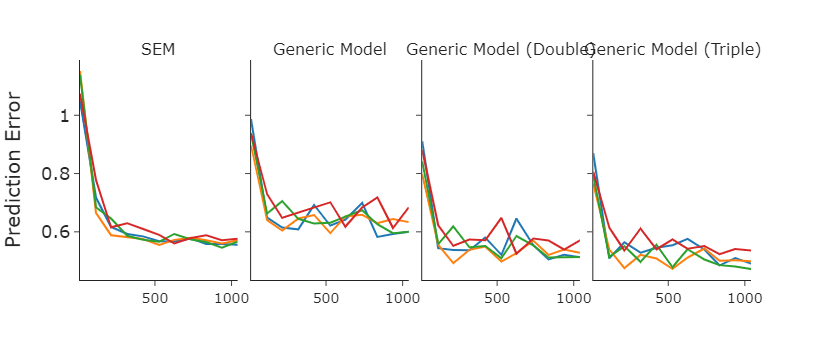

In [333]:
fig = px.line(data_frame=df_pe_select[df_pe_select.tag.isin(update_tags_3m17_more[4:8])], 
                 x='training_time', y='value_mean', facet_col='variable', 
                 # facet_col_wrap=2,
                 # trendline='rolling', trendline_options={'window': 1},
                 # opacity=0.6, 
                 color='tag',
                 labels=dict(value="Prediction Error", training_time="") 
                )
fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis, title_text="Prediction Error", row=1, col=1)
fig.update_layout(#title=dict(text="Compare Prediction Errors between SEM and Generic Models"),
                 showlegend=False)
fig.update_xaxes(tickfont=dict(size=14))
# fig.update_xaxes(title_text="\t\t\t\tAmount of Training (minutes)", row=1, col=2)
model_names = {'pe': 'SEM', 'pe_w': 'Generic Model', 'pe_w2': 'Generic Model (Double)',
               'pe_w3': 'Generic Model (Triple)'}
fig.for_each_annotation(lambda a: a.update(text=model_names[a.text.split('=')[-1]], font_size=16))
# fig.update_traces(opacity=.5, selector=dict(type='scatter'))
fig.update_traces(marker=dict(opacity=1.0), selector=dict(type='scatter'))

fig.show()

#### Statistical Tests

In [346]:
df_pe_end = df_pe_select[df_pe_select.training_time > 800]
import scipy.stats as stat
df_pe_end = df_pe_end.groupby(['variable'])[['value_mean']].agg({'value_mean': ['count', 'mean', stat.sem, 'std']}).reset_index()
df_pe_end

variable value_mean                              
                count      mean       sem       std
0       pe         48  0.574791  0.001983  0.013741
1     pe_w         48  0.636329  0.007337  0.050833
2    pe_w2         48  0.545121  0.004235  0.029341
3    pe_w3         48  0.511318  0.003183  0.022051

In [352]:
# 95% CI
df_pe_end['ci_lower'] = df_pe_end['value_mean']['mean'] + df_pe_end['value_mean']['sem'] * stat.t.ppf(q=.025,df=48)
df_pe_end['ci_upper'] = df_pe_end['value_mean']['mean'] + df_pe_end['value_mean']['sem'] * stat.t.ppf(q=.975,df=48)
df_pe_end

variable value_mean                                ci_lower  ci_upper
                count      mean       sem       std                    
0       pe         48  0.574791  0.001983  0.013741  0.570803  0.578779
1     pe_w         48  0.636329  0.007337  0.050833  0.621577  0.651081
2    pe_w2         48  0.545121  0.004235  0.029341  0.536606  0.553636
3    pe_w3         48  0.511318  0.003183  0.022051  0.504918  0.517717

In [120]:
# mean PE at the end of training
df_pe_select = df_pe_long_avg[df_pe_long_avg.tag.isin(update_tags_3m17_more)]
df_pe_end = df_pe_select[df_pe_select.training_time > 800]
df_pe_end
stats.ttest_ind(df_pe_end[df_pe_end['variable'] == 'pe']['value'],
                df_pe_end[df_pe_end['variable'] == 'pe_w2']['value'],
                alternative='greater')

Ttest_indResult(statistic=6.344544993775727, pvalue=3.8841530303107665e-09)

In [268]:
# interference
df_pe = deepcopy(schemadf[['run', 'epoch', 'pe', 'pe_w', 'pe_w2', 'pe_w3', 'tag']])
df_pe = df_pe[df_pe.run.isin(valid_runs)]
df_pe.epoch = df_pe.epoch.astype(int)
df_pe = df_pe.groupby(['epoch', 'run', 'tag']).mean().reset_index(level=['epoch', 'run', 'tag'])
df_pe_long = pd.melt(df_pe, id_vars=["epoch", "run", "tag"], value_vars=['pe', 'pe_w', 'pe_w2', 'pe_w3'])
df_pe_long

,epoch,run,tag,variable,value
0,1,1.1.6,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,pe,1.562557
1,1,1.1.6,aug_17_no_skel_off_update_1020_1E-03_1E-01_1E+07,pe,1.217034
2,1,1.1.6,aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07,pe,1.054802
3,1,1.1.6,aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07,pe,0.994190
4,1,1.1.6,aug_17_no_skel_off_update_1050_1E-03_1E-01_1E+07,pe,1.233524
...,...,...,...,...,...
48655,101,6.3.8,july_18_full_.8_.8_1120_1E-03_1E-01_1E+07,pe_w3,0.639228
48656,101,6.3.8,july_18_full_.8_.8_1130_1E-03_1E-01_1E+07,pe_w3,0.646557
48657,101,6.3.8,july_18_full_.8_.8_1140_1E-03_1E-01_1E+07,pe_w3,0.614289
48658,101,6.3.8,july_18_full_.8_.8_1150_1E-03_1E-01_1E+07,pe_w3,0.623706


In [286]:
df_pe_long['first_derv'] = 0
for i, row in df_pe_long.iterrows():
    if row.run != '1.1.6':
        continue
    if row.epoch < 10:
        continue
    prev = df_pe_long[(df_pe_long.run == row.run) & (df_pe_long.tag == row.tag) 
                      & (df_pe_long.epoch == row.epoch - 10) & (df_pe_long.variable == row.variable)]
    df_pe_long.loc[i, ['first_derv']] = float(row.value - prev.value)
    # print(row.value - prev.value)


In [300]:
df_pe_long = df_pe_long.assign(derv=df_pe_long.value - df_pe_long.groupby(['run', 'tag', 'variable']).value.shift(1))
df_pe_long[(df_pe_long.run == '1.1.6') & (df_pe_long.tag == update_tags_3m17_more[1])].fillna(0).head()

,epoch,run,tag,variable,value,first_derv,derv
48,1,1.1.6,july_18_full_.8_.8_1020_1E-03_1E-01_1E+07,pe,1.297434,0.000000,0.000000
1308,11,1.1.6,july_18_full_.8_.8_1020_1E-03_1E-01_1E+07,pe,0.576867,-0.720567,-0.720567
2568,21,1.1.6,july_18_full_.8_.8_1020_1E-03_1E-01_1E+07,pe,0.591516,0.014650,0.014650
3828,31,1.1.6,july_18_full_.8_.8_1020_1E-03_1E-01_1E+07,pe,0.594919,0.003403,0.003403
5087,41,1.1.6,july_18_full_.8_.8_1020_1E-03_1E-01_1E+07,pe,0.565428,-0.029491,-0.029491


In [337]:
df_pe_derv_agg = df_pe_long.groupby(['run', 'tag', 'variable']).derv.aggregate((lambda x: sum(x > 0), lambda x: sum(x < 0)))
df_pe_derv_agg.columns = ['increase', 'decrease']
df_pe_derv_agg['log_ratio'] = np.log((df_pe_derv_agg['increase'] + 1e-7) / (df_pe_derv_agg['decrease'] + 1e-7))
df_pe_derv_agg = df_pe_derv_agg.reset_index()

In [340]:
stats.ttest_ind(df_pe_derv_agg[(df_pe_derv_agg.variable == 'pe') & (df_pe_derv_agg.log_ratio != 0)]['log_ratio'],
                df_pe_derv_agg[(df_pe_derv_agg.variable == 'pe_w3') & (df_pe_derv_agg.log_ratio != 0)]['log_ratio'],
                alternative='less'), 

(Ttest_indResult(statistic=-3.5733071509939403, pvalue=0.00018268644878917855),)

In [335]:
df_pe_derv_agg[(df_pe_derv_agg.variable == 'pe') & (df_pe_derv_agg.log_ratio != 0)]['log_ratio']

0      -0.405465
8      -0.510826
12     -0.693147
16     -0.405465
24      0.405465
          ...   
5012   -0.847298
5016   -0.847298
5020   -0.405465
5024   -0.405465
5028   -0.847298
Name: log_ratio, Length: 1076, dtype: float64

## Single Activities

In [12]:
df_pe = deepcopy(schemadf[['run', 'epoch', 'pe', 'pe_w', 'pe_w2', 'pe_w3', 'tag']])
df_pe.tail()

,run,epoch,pe,pe_w,pe_w2,pe_w3,tag
6895021,6.1.5,61,0.800443,0.814589,0.877770,0.918015,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07
6895022,6.1.5,61,0.621222,0.681207,0.636548,0.576949,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07
6895023,6.1.5,61,0.718106,0.722122,0.595703,0.647619,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07
6895024,6.1.5,61,0.562391,0.631147,0.489224,0.440783,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07
6895025,6.1.5,61,0.513554,0.611140,0.446744,0.419645,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07


In [13]:
df_pe_one_run = df_pe[(df_pe.run == "6.3.8") & (df_pe.epoch == 101) & (df_pe.tag == update_tags_3m17_more[2])]
df_pe_one_run.tail()

,run,epoch,pe,pe_w,pe_w2,pe_w3,tag
4471473,6.3.8,101,0.676679,0.678695,0.614871,0.652418,july_18_full_.8_.8_1030_1E-03_1E-01_1E+07
4471474,6.3.8,101,0.475973,0.626673,0.554073,0.565244,july_18_full_.8_.8_1030_1E-03_1E-01_1E+07
4471475,6.3.8,101,0.603308,0.677796,0.692504,0.664804,july_18_full_.8_.8_1030_1E-03_1E-01_1E+07
4471476,6.3.8,101,0.458769,0.456391,0.444061,0.470568,july_18_full_.8_.8_1030_1E-03_1E-01_1E+07
4471477,6.3.8,101,0.425393,0.407467,0.359730,0.340890,july_18_full_.8_.8_1030_1E-03_1E-01_1E+07


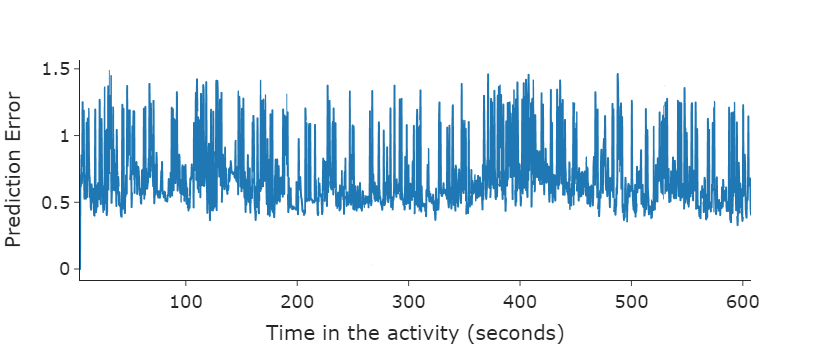

In [32]:
time = [5 + 1/3 * x for x in range(len(df_pe_one_run))]
fig = px.line(df_pe_one_run, x=time, y="pe_w")

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
# fig.update_layout(title=dict(text="Prediction Error Timecourse of One Activity"))
fig.update_xaxes(title=dict(text="Time in the activity (seconds)"))
fig.update_yaxes(title=dict(text="Prediction Error"))
fig.show()

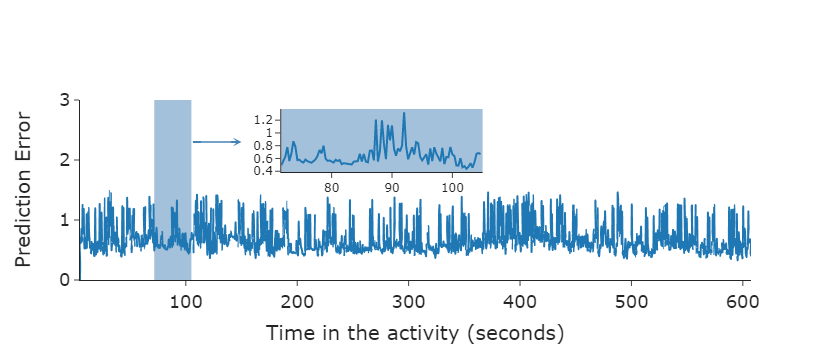

In [41]:
time = [5 + 1/3 * x for x in range(len(df_pe_one_run))]
fig = go.Figure()
fig1 = px.line(df_pe_one_run, x=time, y="pe_w", range_y=(0, 2))
fig2 = px.line(df_pe_one_run.iloc[200:300], x=time[200:300], y="pe_w")
fig2.update_traces(xaxis='x2', yaxis='y2')
fig2.update_layout(plot_bgcolor='rgba(255,255,0,0)')

fig.add_trace(
    fig1.data[0]
)
fig.add_trace(
    fig2.data[0], 
)

# fig.update_layout(layout)
fig.update_layout(
    xaxis2=dict(
        domain=[0.3, 0.6],
        anchor='y2'
    ),
    yaxis2=dict(
        domain=[0.6, 0.95],
        anchor='x2'
    ),
    # title=dict(font=dict(size=20)), tickfont=dict(size=18)
    xaxis=dict(title=dict(text='Time in the activity (seconds)', font=dict(size=20)), tickfont=dict(size=18)),
    yaxis=dict(title=dict(text='Prediction Error', font=dict(size=20)), range=(0, 3), tickfont=dict(size=18)),              
)
fig.update_layout(layout)
fig.update_layout(
    shapes=[dict(
            type="rect",
            xref="x2",
            yref="y2",
            x0=time[200],
            y0=min(df_pe_one_run.iloc[200:300]['pe_w']) - 0.05,
            x1=time[300],
            y1=max(df_pe_one_run.iloc[200:300]['pe_w']) + 0.05,
            fillcolor="steelblue",
            opacity=0.5,
            layer="below",
            line_width=0,
        ), dict(
            type="rect",
            xref="x",
            yref="y",
            x0=time[200],
            y0=0,
            x1=time[300],
            y1=3,
            fillcolor="steelblue",
            opacity=0.5,
            layer="below",
            line_width=0,
        )]
)
arrow = go.layout.Annotation(dict(
                x=150,
                y=2.3,
                xref="x", yref="y",
                text="",
                showarrow=True,
                axref = "x", ayref='y',
                ax=time[300],
                ay= 2.3,
                arrowhead = 3,
                arrowwidth=1.5,
                arrowcolor='steelblue',)
            )
fig.update_layout(
annotations=[arrow],)
# fig.update_xaxes(title=dict(text="Time in the activity (seconds)"), anchor='x1')
# fig.update_yaxes(title=dict(text="Prediction Error"), range=(0, 2.5), anchor='y1')
# fig.update_layout(title=dict(text="Distribution of Elapses"), width=600, height=400, showlegend=False)
# fig.update_xaxes(title=dict(text="Elapse Time between Boundaries (seconds)"))
# fig.update_yaxes(title=dict(text="Count"))
fig.show()

In [49]:
fig.data

(Scattergl({
     'hovertemplate': 'x=%{x}<br>pe_w=%{y}<extra></extra>',
     'legendgroup': '',
     'line': {'color': '#1F77B4', 'dash': 'solid'},
     'marker': {'symbol': 'circle'},
     'mode': 'lines',
     'name': '',
     'showlegend': False,
     'x': array([  5.        ,   5.33333333,   5.66666667, ..., 606.66666667,
                 607.        , 607.33333333]),
     'xaxis': 'x',
     'y': array([0.        , 0.70135572, 0.61699783, ..., 0.67779636, 0.45639081,
                 0.40746716]),
     'yaxis': 'y'
 }),
 Scatter({
     'hovertemplate': 'x=%{x}<br>pe_w=%{y}<extra></extra>',
     'legendgroup': '',
     'line': {'color': '#1F77B4', 'dash': 'solid'},
     'marker': {'symbol': 'circle'},
     'mode': 'lines',
     'name': '',
     'orientation': 'v',
     'showlegend': False,
     'x': array([ 71.66666667,  72.        ,  72.33333333,  72.66666667,  73.        ,
                  73.33333333,  73.66666667,  74.        ,  74.33333333,  74.66666667,
                  75.

In [60]:
readout_dataframes = pkl.load(open(f'output/run_sem/{update_tags_3m17[0]}/{valid_runs[2]}_kinect_trim{update_tags_3m17[0]}_diagnostic_51.pkl', 'rb'))

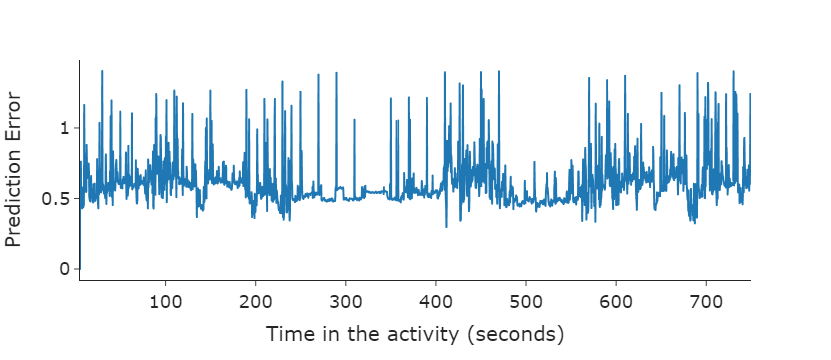

In [61]:
time = [5 + 1/3 * x for x in range(len(readout_dataframes['pe']))]
fig = px.line(x=time, y=readout_dataframes['pe'])

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
# fig.update_layout(title=dict(text="Prediction Error Timecourse of One Activity"))
fig.update_xaxes(title=dict(text="Time in the activity (seconds)"))
fig.update_yaxes(title=dict(text="Prediction Error"))
fig.show()

## Parcelized PE

In [91]:
def pe_epoch(sdf, e):
    if int(e) % 10 != 1:
        return pd.DataFrame()
    df_e = pd.DataFrame(columns=['tag', 'epoch', 'run', 
                                 'pe', 'pe_appear', 'pe_optical', 
                                 'pe_skel', 'pe_emb', 'is_sum'])
    # for each tag
    for tag in tqdm(sdf.tag.unique()):
        for run in sdf.run.unique():
            try:
                diag = pkl.load(open(f'output/run_sem/{tag}/{run}_kinect_trim{tag}_diagnostic_{e}.pkl', 'rb'))
                inputdf = pkl.load(open(f'output/run_sem/{tag}/{run}_kinect_trim{tag}_inputdf_{e}.pkl', 'rb'))
                pe = (inputdf.__dict__['x_train_pca'] - inputdf.__dict__['x_inferred_pca']).to_numpy()
                full_pe = np.linalg.norm(pe, axis=1).mean() / np.sqrt(30)
                appear_pe = np.linalg.norm(pe[:, :2], axis=1).mean() / np.sqrt(2)
                optical_pe = np.linalg.norm(pe[:, :3], axis=1).mean() / np.sqrt(1)
                skel_pe = np.linalg.norm(pe[:, :17], axis=1).mean() / np.sqrt(14)
                emb_pe = np.linalg.norm(pe[:, 17:], axis=1).mean() / np.sqrt(13)
                identifier = [tag, e, run]
                pe_list = [full_pe, appear_pe, optical_pe, skel_pe, emb_pe]
                # df_e.loc[len(df_e), :] = identifier + [np.sum(x) for x in pe_list] + [1]
                df_e.loc[len(df_e), :] = identifier + [np.average(x) for x in pe_list] + [0]
            except Exception as ex:
                print(ex)
                continue
    return df_e

In [15]:
# pe_epoch(sdf, 51)

In [16]:
# diag = pkl.load(open(f'output/run_sem/{update_tags_3m17_more[0]}/{valid_runs[0]}_kinect_trim{update_tags_3m17_more[0]}_diagnostic_{101}.pkl', 'rb'))
# inputdf = pkl.load(open(f'output/run_sem/{update_tags_3m17_more[0]}/{valid_runs[0]}_kinect_trim{update_tags_3m17_more[0]}_inputdf_{101}.pkl', 'rb'))
# pe = (inputdf.__dict__['x_train_pca'] - inputdf.__dict__['x_inferred_pca'])

In [17]:
# appear_pe = np.linalg.norm(pe.iloc[:, :2], axis=1)
# appear_pe.mean()

In [94]:
sdf = schemadf[schemadf.tag.isin(update_tags_3m17_more[:8] + 
                                 update_tags_nomo_3m17_correct[:8] + 
                                 update_tags_nose_3m17_correct[:8])]
sdf = sdf[sdf.run.isin(valid_runs)]
df_parcels = Parallel(n_jobs=8)(delayed(pe_epoch)(sdf, e) for e in (sdf.epoch.unique()))
df_parcel = pd.concat(df_parcels)
# df_parcel.columns = ['tag', 'epoch', 'run', 
#                      'pe', 'pe_appear', 'pe_optical', 
#                      'pe_skel', 'pe_emb', 'is_sum']

100%|██████████| 23/23 [07:41<00:00, 20.04s/it]

[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/6.3.8_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_91.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/4.4.2_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_91.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/6.1.5_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_91.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/3.4.3_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_91.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/1.1.8_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_91.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_sk


100%|██████████| 23/23 [08:36<00:00, 22.44s/it]

[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/6.3.8_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_71.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/4.4.2_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_71.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/6.1.5_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_71.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/3.4.3_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_71.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/1.1.8_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_71.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_sk


  0%|          | 0/23 [00:00<?, ?it/s]

[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/6.3.8_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_51.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/4.4.2_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_51.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/6.1.5_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_51.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/3.4.3_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_51.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/1.1.8_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_51.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_sk

 87%|████████▋ | 20/23 [07:03<00:33, 11.18s/it]


[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/6.3.8_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_101.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/4.4.2_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_101.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/6.1.5_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_101.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/3.4.3_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_101.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/1.1.8_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_101.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_

100%|██████████| 23/23 [08:44<00:00, 22.81s/it]


[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/6.3.8_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_61.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/4.4.2_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_61.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/6.1.5_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_61.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/3.4.3_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_61.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/1.1.8_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_61.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_sk

[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/3.1.3_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_81.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07/1.2.7_kinect_trimaug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07_diagnostic_81.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/6.3.8_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_81.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/4.4.2_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_81.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07/6.1.5_kinect_trimaug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07_diagnostic_81.pkl'
[Errno 2] No such file or directory: 'output/run_sem/aug_17_no_sk

KeyboardInterrupt: 

In [ ]:
df_parcel.to_csv('df_parcel_final.csv', index_label=False)

In [96]:
df_parcel = pd.read_csv('df_parcel_final.csv')
df_parcel.tag.unique()

array(['july_18_full_.8_.8_1010_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1020_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1030_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1040_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1050_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1060_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1070_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1080_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1090_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1100_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1110_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1120_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1130_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1140_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1150_1E-03_1E-01_1E+07',
       'july_18_full_.8_.8_1160_1E-03_1E-01_1E+07',
       'july_28_no_motion_1030_1E-03_1E-01_1E+07',
       'july_28_no_motion_1040_1E-03_1E-01_1E+07',
       'july_28_no_motion_1080_1E-03_1E-01_1E+07',
       'july_28

In [97]:
df_parcel_long = pd.melt(df_parcel, id_vars=["epoch", "run", "tag", "is_sum"], 
                         value_vars=['pe', 'pe_appear', 'pe_optical', 'pe_skel', 'pe_emb'])

In [98]:
df_parcel_long['training_time'] = df_parcel_long['epoch'].map(epoch_to_duration)
df_parcel_long['training_time'] = df_parcel_long['training_time'] / 60
df_parcel_long.head(5)

,epoch,run,tag,is_sum,variable,value,training_time
0,41,4.4.2,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,0,pe,0.527759,426.958634
1,41,4.4.3,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,0,pe,0.489247,426.958634
2,41,6.1.5,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,0,pe,0.611455,426.958634
3,41,6.2.3,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,0,pe,0.653088,426.958634
4,41,1.3.3,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,0,pe,0.575967,426.958634


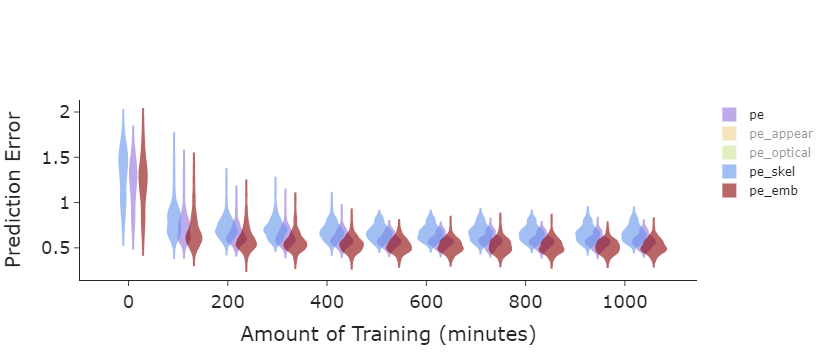

In [81]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['Full', 'Appearance-Disappeance', 'Optical', 'Motion', 'Object-Hand']
point = False
width = 50
shifts = [0, -10, 10, -20, 20]

# df = df_pe_long[(biserial_all_long.variable == 'bi_shuffle_h_fair') & (biserial_all_long.tag.isin(full_tags))]
# fig.add_trace(
#     go.Violin(x=df.training_time, y=df.value, name=f"Perm", 
#               fillcolor=colors[0], line_color=colors[0], opacity=0.6, points=False, width=30)
# )
for i, var in enumerate(['pe', 'pe_appear', 'pe_optical', 'pe_skel', 'pe_emb']):
    df = df_parcel_long[(df_parcel_long.variable == var) & (df_parcel_long.is_sum == False)]
    fig.add_trace(
        go.Violin(x=df.training_time + shifts[i], y=df.value, name=f"{var}", 
                  fillcolor=colors[i+1], line_color=colors[i+1], opacity=0.6,
                  points=point, width=width)
    )
    

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_xaxes(title=dict(text="Amount of Training (minutes)"))
fig.update_yaxes(title=dict(text="Prediction Error"))
# fig.update_layout(title="Compare Segmentation Agreement Between Full and Lesioned Models", title_x=0.5)
fig.show()

In [100]:
df_parcel_long = df_parcel_long.groupby(['epoch', 'tag', 'variable', 'training_time'])['value'].mean().reset_index()
df_parcel_long['Model Version'] = None
df_parcel_long.loc[df_parcel_long.tag.isin(update_tags_3m17_more), 'Model Version'] = 'SEM-2.0-full'
df_parcel_long.loc[df_parcel_long.tag.isin(update_tags_nomo_3m17), 'Model Version'] = 'Motion-deprived'
df_parcel_long.loc[df_parcel_long.tag.isin(update_tags_nose_3m17), 'Model Version'] = 'Semantics-deprived'
df_parcel_long

,epoch,tag,variable,training_time,value,Model Version
0,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,pe,11.209184,1.534036,SEM-2.0-full
1,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,pe_appear,11.209184,1.636924,SEM-2.0-full
2,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,pe_emb,11.209184,1.671177,SEM-2.0-full
3,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,pe_optical,11.209184,2.538248,SEM-2.0-full
4,1,july_18_full_.8_.8_1010_1E-03_1E-01_1E+07,pe_skel,11.209184,1.548117,SEM-2.0-full
...,...,...,...,...,...,...
2305,101,july_29_no_semantics_1160_1E-03_1E-01_1E+07,pe,1039.549004,0.747797,Semantics-deprived
2306,101,july_29_no_semantics_1160_1E-03_1E-01_1E+07,pe_appear,1039.549004,0.332759,Semantics-deprived
2307,101,july_29_no_semantics_1160_1E-03_1E-01_1E+07,pe_emb,1039.549004,0.863008,Semantics-deprived
2308,101,july_29_no_semantics_1160_1E-03_1E-01_1E+07,pe_optical,1039.549004,0.900589,Semantics-deprived


In [101]:
times = df_parcel_long.training_time.unique()

In [103]:
df_parcel_select = df_parcel_long[df_parcel_long.variable.isin(['pe', 'pe_skel', 'pe_emb'])]
df_parcel_select.loc[df_parcel_select.tag.isin(update_tags_nomo_3m17), 'training_time'] += 20
df_parcel_select.loc[df_parcel_select.tag.isin(update_tags_nose_3m17), 'training_time'] -= 20
fig = px.violin(data_frame=df_parcel_select, 
                 x='training_time', y='value', 
                 facet_col='variable', 
                 # facet_col_wrap=2,
                 # trendline='rolling', trendline_options={'window': 1},
                 # opacity=0.6, 
                 color='Model Version',
                 color_discrete_sequence=colors[1:],
                 labels=dict(value="Prediction Error", training_time="") 
                )
fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis, title_text="Prediction Error", row=1, col=1)
fig.update_layout(#title=dict(text="Compare Prediction Errors between SEM and Generic Models"),
                 showlegend=True)
fig.update_xaxes(tickfont=dict(size=14))
# fig.update_xaxes(title_text="\t\t\t\tAmount of Training (minutes)", row=1, col=2)
model_names = {'pe': 'All Features', 'pe_skel': 'Motion Features', 'pe_emb': 'Semantic Features'}
fig.for_each_annotation(lambda a: a.update(text=model_names[a.text.split('=')[-1]], font_size=16))
fig.update_traces(
                  # row=1, col=1,
                  fillcolor=colors[1], line_color=colors[1], legendrank=2,
                  width=100, points=False, scalemode="width", selector=dict(type='violin', name="SEM-2.0-full"))
fig.update_traces(
                  # row=1, col=1,
                  fillcolor=colors[2], line_color=colors[2], legendrank=0,
                  width=100, points=False, scalemode="width", selector=dict(type='violin', name="Motion-deprived"))
fig.update_traces(
                  # row=1, col=1,
                  fillcolor=colors[3], line_color=colors[3], legendrank=1,
                  width=100, points=False, scalemode="width", selector=dict(type='violin', name="Semantics-deprived"))
# fig.update_traces(marker=dict(opacity=1.0), selector=dict(type='scatter'))
fig.update_layout(shapes=[{'type': 'line','y0':0,'y1': 0.05 * 2,'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in times])
fig.show()

ValueError: Invalid property specified for object of type plotly.graph_objs.Layout: 'row'

Did you mean "font"?

    Valid properties:
        activeshape
            :class:`plotly.graph_objects.layout.Activeshape`
            instance or dict with compatible properties
        annotations
            A tuple of
            :class:`plotly.graph_objects.layout.Annotation`
            instances or dicts with compatible properties
        annotationdefaults
            When used in a template (as
            layout.template.layout.annotationdefaults), sets the
            default property values to use for elements of
            layout.annotations
        autosize
            Determines whether or not a layout width or height that
            has been left undefined by the user is initialized on
            each relayout. Note that, regardless of this attribute,
            an undefined layout width or height is always
            initialized on the first call to plot.
        autotypenumbers
            Using "strict" a numeric string in trace data is not
            converted to a number. Using *convert types* a numeric
            string in trace data may be treated as a number during
            automatic axis `type` detection. This is the default
            value; however it could be overridden for individual
            axes.
        bargap
            Sets the gap (in plot fraction) between bars of
            adjacent location coordinates.
        bargroupgap
            Sets the gap (in plot fraction) between bars of the
            same location coordinate.
        barmode
            Determines how bars at the same location coordinate are
            displayed on the graph. With "stack", the bars are
            stacked on top of one another With "relative", the bars
            are stacked on top of one another, with negative values
            below the axis, positive values above With "group", the
            bars are plotted next to one another centered around
            the shared location. With "overlay", the bars are
            plotted over one another, you might need to an
            "opacity" to see multiple bars.
        barnorm
            Sets the normalization for bar traces on the graph.
            With "fraction", the value of each bar is divided by
            the sum of all values at that location coordinate.
            "percent" is the same but multiplied by 100 to show
            percentages.
        boxgap
            Sets the gap (in plot fraction) between boxes of
            adjacent location coordinates. Has no effect on traces
            that have "width" set.
        boxgroupgap
            Sets the gap (in plot fraction) between boxes of the
            same location coordinate. Has no effect on traces that
            have "width" set.
        boxmode
            Determines how boxes at the same location coordinate
            are displayed on the graph. If "group", the boxes are
            plotted next to one another centered around the shared
            location. If "overlay", the boxes are plotted over one
            another, you might need to set "opacity" to see them
            multiple boxes. Has no effect on traces that have
            "width" set.
        calendar
            Sets the default calendar system to use for
            interpreting and displaying dates throughout the plot.
        clickmode
            Determines the mode of single click interactions.
            "event" is the default value and emits the
            `plotly_click` event. In addition this mode emits the
            `plotly_selected` event in drag modes "lasso" and
            "select", but with no event data attached (kept for
            compatibility reasons). The "select" flag enables
            selecting single data points via click. This mode also
            supports persistent selections, meaning that pressing
            Shift while clicking, adds to / subtracts from an
            existing selection. "select" with `hovermode`: "x" can
            be confusing, consider explicitly setting `hovermode`:
            "closest" when using this feature. Selection events are
            sent accordingly as long as "event" flag is set as
            well. When the "event" flag is missing, `plotly_click`
            and `plotly_selected` events are not fired.
        coloraxis
            :class:`plotly.graph_objects.layout.Coloraxis` instance
            or dict with compatible properties
        colorscale
            :class:`plotly.graph_objects.layout.Colorscale`
            instance or dict with compatible properties
        colorway
            Sets the default trace colors.
        computed
            Placeholder for exporting automargin-impacting values
            namely `margin.t`, `margin.b`, `margin.l` and
            `margin.r` in "full-json" mode.
        datarevision
            If provided, a changed value tells `Plotly.react` that
            one or more data arrays has changed. This way you can
            modify arrays in-place rather than making a complete
            new copy for an incremental change. If NOT provided,
            `Plotly.react` assumes that data arrays are being
            treated as immutable, thus any data array with a
            different identity from its predecessor contains new
            data.
        dragmode
            Determines the mode of drag interactions. "select" and
            "lasso" apply only to scatter traces with markers or
            text. "orbit" and "turntable" apply only to 3D scenes.
        editrevision
            Controls persistence of user-driven changes in
            `editable: true` configuration, other than trace names
            and axis titles. Defaults to `layout.uirevision`.
        extendfunnelareacolors
            If `true`, the funnelarea slice colors (whether given
            by `funnelareacolorway` or inherited from `colorway`)
            will be extended to three times its original length by
            first repeating every color 20% lighter then each color
            20% darker. This is intended to reduce the likelihood
            of reusing the same color when you have many slices,
            but you can set `false` to disable. Colors provided in
            the trace, using `marker.colors`, are never extended.
        extendiciclecolors
            If `true`, the icicle slice colors (whether given by
            `iciclecolorway` or inherited from `colorway`) will be
            extended to three times its original length by first
            repeating every color 20% lighter then each color 20%
            darker. This is intended to reduce the likelihood of
            reusing the same color when you have many slices, but
            you can set `false` to disable. Colors provided in the
            trace, using `marker.colors`, are never extended.
        extendpiecolors
            If `true`, the pie slice colors (whether given by
            `piecolorway` or inherited from `colorway`) will be
            extended to three times its original length by first
            repeating every color 20% lighter then each color 20%
            darker. This is intended to reduce the likelihood of
            reusing the same color when you have many slices, but
            you can set `false` to disable. Colors provided in the
            trace, using `marker.colors`, are never extended.
        extendsunburstcolors
            If `true`, the sunburst slice colors (whether given by
            `sunburstcolorway` or inherited from `colorway`) will
            be extended to three times its original length by first
            repeating every color 20% lighter then each color 20%
            darker. This is intended to reduce the likelihood of
            reusing the same color when you have many slices, but
            you can set `false` to disable. Colors provided in the
            trace, using `marker.colors`, are never extended.
        extendtreemapcolors
            If `true`, the treemap slice colors (whether given by
            `treemapcolorway` or inherited from `colorway`) will be
            extended to three times its original length by first
            repeating every color 20% lighter then each color 20%
            darker. This is intended to reduce the likelihood of
            reusing the same color when you have many slices, but
            you can set `false` to disable. Colors provided in the
            trace, using `marker.colors`, are never extended.
        font
            Sets the global font. Note that fonts used in traces
            and other layout components inherit from the global
            font.
        funnelareacolorway
            Sets the default funnelarea slice colors. Defaults to
            the main `colorway` used for trace colors. If you
            specify a new list here it can still be extended with
            lighter and darker colors, see
            `extendfunnelareacolors`.
        funnelgap
            Sets the gap (in plot fraction) between bars of
            adjacent location coordinates.
        funnelgroupgap
            Sets the gap (in plot fraction) between bars of the
            same location coordinate.
        funnelmode
            Determines how bars at the same location coordinate are
            displayed on the graph. With "stack", the bars are
            stacked on top of one another With "group", the bars
            are plotted next to one another centered around the
            shared location. With "overlay", the bars are plotted
            over one another, you might need to an "opacity" to see
            multiple bars.
        geo
            :class:`plotly.graph_objects.layout.Geo` instance or
            dict with compatible properties
        grid
            :class:`plotly.graph_objects.layout.Grid` instance or
            dict with compatible properties
        height
            Sets the plot's height (in px).
        hiddenlabels
            hiddenlabels is the funnelarea & pie chart analog of
            visible:'legendonly' but it can contain many labels,
            and can simultaneously hide slices from several
            pies/funnelarea charts
        hiddenlabelssrc
            Sets the source reference on Chart Studio Cloud for
            `hiddenlabels`.
        hidesources
            Determines whether or not a text link citing the data
            source is placed at the bottom-right cored of the
            figure. Has only an effect only on graphs that have
            been generated via forked graphs from the Chart Studio
            Cloud (at https://chart-studio.plotly.com or on-
            premise).
        hoverdistance
            Sets the default distance (in pixels) to look for data
            to add hover labels (-1 means no cutoff, 0 means no
            looking for data). This is only a real distance for
            hovering on point-like objects, like scatter points.
            For area-like objects (bars, scatter fills, etc)
            hovering is on inside the area and off outside, but
            these objects will not supersede hover on point-like
            objects in case of conflict.
        hoverlabel
            :class:`plotly.graph_objects.layout.Hoverlabel`
            instance or dict with compatible properties
        hovermode
            Determines the mode of hover interactions. If
            "closest", a single hoverlabel will appear for the
            "closest" point within the `hoverdistance`. If "x" (or
            "y"), multiple hoverlabels will appear for multiple
            points at the "closest" x- (or y-) coordinate within
            the `hoverdistance`, with the caveat that no more than
            one hoverlabel will appear per trace. If *x unified*
            (or *y unified*), a single hoverlabel will appear
            multiple points at the closest x- (or y-) coordinate
            within the `hoverdistance` with the caveat that no more
            than one hoverlabel will appear per trace. In this
            mode, spikelines are enabled by default perpendicular
            to the specified axis. If false, hover interactions are
            disabled.
        iciclecolorway
            Sets the default icicle slice colors. Defaults to the
            main `colorway` used for trace colors. If you specify a
            new list here it can still be extended with lighter and
            darker colors, see `extendiciclecolors`.
        images
            A tuple of :class:`plotly.graph_objects.layout.Image`
            instances or dicts with compatible properties
        imagedefaults
            When used in a template (as
            layout.template.layout.imagedefaults), sets the default
            property values to use for elements of layout.images
        legend
            :class:`plotly.graph_objects.layout.Legend` instance or
            dict with compatible properties
        mapbox
            :class:`plotly.graph_objects.layout.Mapbox` instance or
            dict with compatible properties
        margin
            :class:`plotly.graph_objects.layout.Margin` instance or
            dict with compatible properties
        meta
            Assigns extra meta information that can be used in
            various `text` attributes. Attributes such as the
            graph, axis and colorbar `title.text`, annotation
            `text` `trace.name` in legend items, `rangeselector`,
            `updatemenus` and `sliders` `label` text all support
            `meta`. One can access `meta` fields using template
            strings: `%{meta[i]}` where `i` is the index of the
            `meta` item in question. `meta` can also be an object
            for example `{key: value}` which can be accessed
            %{meta[key]}.
        metasrc
            Sets the source reference on Chart Studio Cloud for
            `meta`.
        modebar
            :class:`plotly.graph_objects.layout.Modebar` instance
            or dict with compatible properties
        newshape
            :class:`plotly.graph_objects.layout.Newshape` instance
            or dict with compatible properties
        paper_bgcolor
            Sets the background color of the paper where the graph
            is drawn.
        piecolorway
            Sets the default pie slice colors. Defaults to the main
            `colorway` used for trace colors. If you specify a new
            list here it can still be extended with lighter and
            darker colors, see `extendpiecolors`.
        plot_bgcolor
            Sets the background color of the plotting area in-
            between x and y axes.
        polar
            :class:`plotly.graph_objects.layout.Polar` instance or
            dict with compatible properties
        scene
            :class:`plotly.graph_objects.layout.Scene` instance or
            dict with compatible properties
        selectdirection
            When `dragmode` is set to "select", this limits the
            selection of the drag to horizontal, vertical or
            diagonal. "h" only allows horizontal selection, "v"
            only vertical, "d" only diagonal and "any" sets no
            limit.
        selectionrevision
            Controls persistence of user-driven changes in selected
            points from all traces.
        separators
            Sets the decimal and thousand separators. For example,
            *. * puts a '.' before decimals and a space between
            thousands. In English locales, dflt is ".," but other
            locales may alter this default.
        shapes
            A tuple of :class:`plotly.graph_objects.layout.Shape`
            instances or dicts with compatible properties
        shapedefaults
            When used in a template (as
            layout.template.layout.shapedefaults), sets the default
            property values to use for elements of layout.shapes
        showlegend
            Determines whether or not a legend is drawn. Default is
            `true` if there is a trace to show and any of these: a)
            Two or more traces would by default be shown in the
            legend. b) One pie trace is shown in the legend. c) One
            trace is explicitly given with `showlegend: true`.
        sliders
            A tuple of :class:`plotly.graph_objects.layout.Slider`
            instances or dicts with compatible properties
        sliderdefaults
            When used in a template (as
            layout.template.layout.sliderdefaults), sets the
            default property values to use for elements of
            layout.sliders
        smith
            :class:`plotly.graph_objects.layout.Smith` instance or
            dict with compatible properties
        spikedistance
            Sets the default distance (in pixels) to look for data
            to draw spikelines to (-1 means no cutoff, 0 means no
            looking for data). As with hoverdistance, distance does
            not apply to area-like objects. In addition, some
            objects can be hovered on but will not generate
            spikelines, such as scatter fills.
        sunburstcolorway
            Sets the default sunburst slice colors. Defaults to the
            main `colorway` used for trace colors. If you specify a
            new list here it can still be extended with lighter and
            darker colors, see `extendsunburstcolors`.
        template
            Default attributes to be applied to the plot. This
            should be a dict with format: `{'layout':
            layoutTemplate, 'data': {trace_type: [traceTemplate,
            ...], ...}}` where `layoutTemplate` is a dict matching
            the structure of `figure.layout` and `traceTemplate` is
            a dict matching the structure of the trace with type
            `trace_type` (e.g. 'scatter'). Alternatively, this may
            be specified as an instance of
            plotly.graph_objs.layout.Template.  Trace templates are
            applied cyclically to traces of each type. Container
            arrays (eg `annotations`) have special handling: An
            object ending in `defaults` (eg `annotationdefaults`)
            is applied to each array item. But if an item has a
            `templateitemname` key we look in the template array
            for an item with matching `name` and apply that
            instead. If no matching `name` is found we mark the
            item invisible. Any named template item not referenced
            is appended to the end of the array, so this can be
            used to add a watermark annotation or a logo image, for
            example. To omit one of these items on the plot, make
            an item with matching `templateitemname` and `visible:
            false`.
        ternary
            :class:`plotly.graph_objects.layout.Ternary` instance
            or dict with compatible properties
        title
            :class:`plotly.graph_objects.layout.Title` instance or
            dict with compatible properties
        titlefont
            Deprecated: Please use layout.title.font instead. Sets
            the title font. Note that the title's font used to be
            customized by the now deprecated `titlefont` attribute.
        transition
            Sets transition options used during Plotly.react
            updates.
        treemapcolorway
            Sets the default treemap slice colors. Defaults to the
            main `colorway` used for trace colors. If you specify a
            new list here it can still be extended with lighter and
            darker colors, see `extendtreemapcolors`.
        uirevision
            Used to allow user interactions with the plot to
            persist after `Plotly.react` calls that are unaware of
            these interactions. If `uirevision` is omitted, or if
            it is given and it changed from the previous
            `Plotly.react` call, the exact new figure is used. If
            `uirevision` is truthy and did NOT change, any
            attribute that has been affected by user interactions
            and did not receive a different value in the new figure
            will keep the interaction value. `layout.uirevision`
            attribute serves as the default for `uirevision`
            attributes in various sub-containers. For finer control
            you can set these sub-attributes directly. For example,
            if your app separately controls the data on the x and y
            axes you might set `xaxis.uirevision=*time*` and
            `yaxis.uirevision=*cost*`. Then if only the y data is
            changed, you can update `yaxis.uirevision=*quantity*`
            and the y axis range will reset but the x axis range
            will retain any user-driven zoom.
        uniformtext
            :class:`plotly.graph_objects.layout.Uniformtext`
            instance or dict with compatible properties
        updatemenus
            A tuple of
            :class:`plotly.graph_objects.layout.Updatemenu`
            instances or dicts with compatible properties
        updatemenudefaults
            When used in a template (as
            layout.template.layout.updatemenudefaults), sets the
            default property values to use for elements of
            layout.updatemenus
        violingap
            Sets the gap (in plot fraction) between violins of
            adjacent location coordinates. Has no effect on traces
            that have "width" set.
        violingroupgap
            Sets the gap (in plot fraction) between violins of the
            same location coordinate. Has no effect on traces that
            have "width" set.
        violinmode
            Determines how violins at the same location coordinate
            are displayed on the graph. If "group", the violins are
            plotted next to one another centered around the shared
            location. If "overlay", the violins are plotted over
            one another, you might need to set "opacity" to see
            them multiple violins. Has no effect on traces that
            have "width" set.
        waterfallgap
            Sets the gap (in plot fraction) between bars of
            adjacent location coordinates.
        waterfallgroupgap
            Sets the gap (in plot fraction) between bars of the
            same location coordinate.
        waterfallmode
            Determines how bars at the same location coordinate are
            displayed on the graph. With "group", the bars are
            plotted next to one another centered around the shared
            location. With "overlay", the bars are plotted over one
            another, you might need to an "opacity" to see multiple
            bars.
        width
            Sets the plot's width (in px).
        xaxis
            :class:`plotly.graph_objects.layout.XAxis` instance or
            dict with compatible properties
        yaxis
            :class:`plotly.graph_objects.layout.YAxis` instance or
            dict with compatible properties
        
Did you mean "font"?

Bad property path:
row
^^^

# Clustering

## Mutual Information

### Prepare MI Dataframe

In [22]:
def compute_mi(epoch, sdf, permute):
    mialldf = pd.DataFrame()
    for tag in tqdm(sdf.tag.unique()):
        try:
            edf = sdf[(sdf['epoch'] == epoch) & (sdf['tag'] == tag)]
            if len(edf) == 0:
                continue
            mi = adjusted_mutual_info_score(edf['e_hat'], edf['ev_fact'])
            # mi_reset = adjusted_mutual_info_score(edf['e_hat_reset'], edf['ev_fact'])
            mi_reset = np.nan
            tempdf = pd.DataFrame({'mi_reset': mi_reset, 'mi_reset_shuffle_h': np.nan,
                                   'epoch': epoch, 'tag': tag, 'mi': [mi], 
                                   'mi_shuffle_h': np.nan, 'mi_shuffle_d': np.nan,
                                   'mi_shuffle_h_fair': np.nan})
            if permute:
                #mi_shuffle=[]
                for i in range(permute):
                    # shuffled = shuffle_label_lengths(edf['ev_fact'])
                    # mip_d = adjusted_mutual_info_score(edf['e_hat'], shuffled)
                    shuffled = shuffle_lengths(edf['e_hat'])
                    mip_h = adjusted_mutual_info_score(shuffled, edf['ev_fact'])
                    # shuffled = fair_shuffle(edf['e_hat'], edf['run'])
                    shuffled = shuffle_label_lengths(edf['e_hat'])
                    mip_h_f = adjusted_mutual_info_score(shuffled, edf['ev_fact'])
                    # shuffled = fair_shuffle(edf['e_hat_reset'], edf['run'])
                    # mip_reset_h_f = adjusted_mutual_info_score(shuffled, edf['ev_fact'])
                    mip_reset_h_f = np.nan
                    temptempdf = pd.DataFrame({'mi_reset_shuffle_h': mip_reset_h_f, 'epoch': epoch, 'tag': tag, 'mi': [mi], 'mi_shuffle_h': mip_h, 'mi_shuffle_d':np.nan, 'mi_shuffle_h_fair': mip_h_f})
                    tempdf = pd.concat([tempdf, temptempdf])
                    #mi_shuffle.append(mip)
                #tempdf['mi_shuffle']=[mi_shuffle]
            mialldf = pd.concat([mialldf, tempdf])
        except Exception as e:
            print(traceback.format_exc())
            print(f'error epoch={epoch}, tag={tag}')
            continue
    
    return mialldf


In [23]:
def compute_mi_overall(schemadf, permute=20):
    # Compute adjusted mutual information scores across all runs
    mialldf = pd.DataFrame()
    sdf = schemadf[(schemadf.run.isin(valid_runs))]
    
    edfs = Parallel(n_jobs=12)(delayed(compute_mi)(epoch, sdf, permute) for epoch in sdf.epoch.unique())
    # for epoch in tqdm(sdf.epoch.unique()):
    mialldf = pd.concat(edfs)
    mialldf['epoch'] = mialldf['epoch'].astype('int')
    return mialldf

In [352]:
mialldf = pd.DataFrame()
for key, cache_tags in name_to_tags.items():
    if os.path.exists(f'mialldf_final_{key}.csv'):
        print(f'mialldf_final_{key}.csv exists, continue..')
        continue
    print(f"Processing {key}")
    # do reset
    sdf = schemadf[schemadf['run'].isin(valid_runs)
                   & (schemadf['tag'].isin(cache_tags))
                  ]
    if len(sdf) == 0:
        print(f"Tags with {cache_tags[0]} is not in schemadf")
        continue
    tags_df = compute_mi_overall(sdf, permute=20)
    tags_df.to_csv(f'mialldf_final_{key}.csv', index_label=False)
    print(f"Saved mialldf_final_{key}.csv")
    
    mialldf = pd.concat([mialldf, tags_df])

Processing 3m17_h15


100%|██████████| 7/7 [00:23<00:00,  3.41s/it]

Saved mialldf_final_3m17_h15.csv


100%|██████████| 7/7 [00:23<00:00,  3.37s/it]

In [31]:
mialldf = pd.DataFrame()
for key in name_to_tags.keys():
    try:
        df = pd.read_csv(f'mialldf_final_{key}.csv')
        mialldf = pd.concat([mialldf, df])
    except Exception as e:
        print(e)

In [32]:
mialldf.tag.unique()

array(['aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1020_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1050_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1060_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1070_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1080_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1010_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1020_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1030_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1040_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1050_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1070_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1080_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1090_1E-03_1E-01_1E+07',
       'aug_18_n

In [34]:
# mialldf_long = pd.melt(mialldf, id_vars = ["epoch", "tag"], value_vars=['mi', 'mi_shuffle_h_fair'])
mialldf_long = pd.melt(mialldf, id_vars = ["epoch", "tag"], value_vars=['mi', 'mi_shuffle_h_fair', 'mi_shuffle_h'])
mialldf_long = mialldf_long.drop_duplicates()

In [35]:
mialldf_long['training_time'] = mialldf_long['epoch'].map(epoch_to_duration)
mialldf_long['training_time'] = mialldf_long['training_time'] / 60
mialldf_long.head(5)

,epoch,tag,variable,value,training_time
0,91,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,mi,0.453808,940.984559
21,91,aug_17_no_skel_off_update_1020_1E-03_1E-01_1E+07,mi,0.522388,940.984559
42,91,aug_17_no_skel_off_update_1050_1E-03_1E-01_1E+07,mi,0.529150,940.984559
63,91,aug_17_no_skel_off_update_1060_1E-03_1E-01_1E+07,mi,0.425005,940.984559
84,91,aug_17_no_skel_off_update_1070_1E-03_1E-01_1E+07,mi,0.492614,940.984559


### Multiple Tags, Each with Multiple Simulations

In [247]:
mialldf_long

,epoch,tag,variable,value,training_time
0,91,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,mi,0.453808,937.848032
21,91,aug_17_no_skel_off_update_1020_1E-03_1E-01_1E+07,mi,0.522388,937.848032
42,91,aug_17_no_skel_off_update_1050_1E-03_1E-01_1E+07,mi,0.529150,937.848032
63,91,aug_17_no_skel_off_update_1060_1E-03_1E-01_1E+07,mi,0.425005,937.848032
84,91,aug_17_no_skel_off_update_1070_1E-03_1E-01_1E+07,mi,0.492614,937.848032
...,...,...,...,...,...
38425,61,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,mi_shuffle_h,0.364025,628.719584
38426,61,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,mi_shuffle_h,0.367873,628.719584
38427,61,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,mi_shuffle_h,0.357973,628.719584
38428,61,july_18_full_.8_.8_1160_1E-03_1E-01_1E+07,mi_shuffle_h,0.359122,628.719584


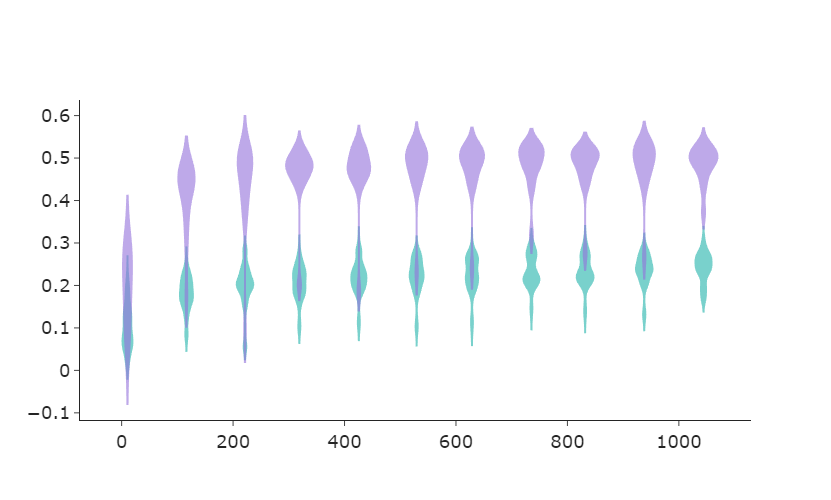

In [189]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['SEM']
shifts = [0, -10, 10]
point = False
width = 50

df = mialldf_long[(mialldf_long.variable == 'mi_shuffle_h_fair') 
                  & (mialldf_long.tag.isin(update_tags_3m17_more))
                 ]
fig.add_trace(
    go.Violin(x=df.training_time, y=df.value, name=f"Permutation_event_labels", 
              fillcolor=colors[0], line_color=colors[0], 
              opacity=0.6, points=False, width=30, 
             )
)

for i, tags in enumerate([update_tags_3m17_more]):
    df = mialldf_long[(mialldf_long.variable == 'mi') & (mialldf_long.tag.isin(tags))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df.value, name=f"{tag_names[i]}", 
                  fillcolor=colors[i+1], line_color=colors[i+1], opacity=0.6, 
                  points=point, width=width, scalemode='width')
    )
    
# fig.add_annotation(x=900, y=0.6,
#         text="SEM-to-human",
#         font=dict(
#         # family="sans serif",
#         size=18,
#         color=colors[1]
#         ),
#         showarrow=False,
#         )

fig.update_layout(layout, showlegend=False, height=500)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
# fig.update_xaxes(title=dict(text="Amount of Training (minutes)"))
# fig.update_yaxes(title=dict(text="Adjusted Mutual Info"))
# fig.update_layout(title="Compare Segmentation Agreement Between Full and Lesioned Models", title_x=0.5)
fig.show()

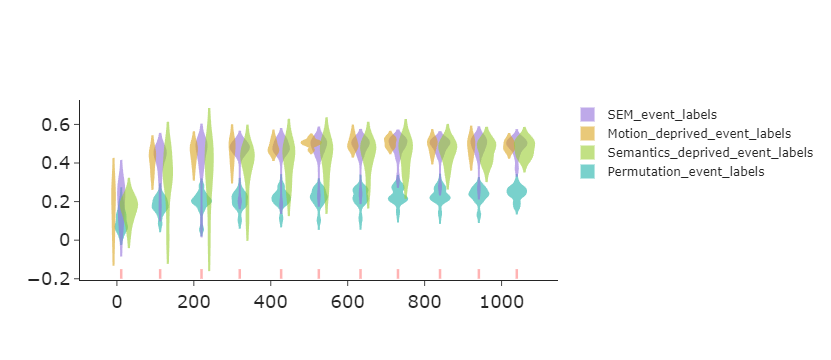

In [38]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['SEM_event_labels', 'Motion_deprived_event_labels', 'Semantics_deprived_event_labels']
shifts = [0, -20, 20]
width = 50
point = False
ranks = [0, 1, 2, 3, 4, 5]

df = mialldf_long[(mialldf_long.variable == 'mi_shuffle_h_fair')
                  & (mialldf_long.tag.isin(update_tags_3m17_more))
                 ]
fig.add_trace(
    go.Violin(x=df.training_time, y=df.value, name=f"Permutation_event_labels", 
              fillcolor=colors[0], line_color=colors[0], opacity=0.6, points=point, width=width,
              legendrank=ranks[4])
)
for i, tags in enumerate([update_tags_3m17_more, update_tags_nomo_3m17_correct,
                          update_tags_nose_3m17_correct]):
    df = mialldf_long[(mialldf_long.variable == 'mi') & (mialldf_long.tag.isin(tags))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df.value, name=f"{tag_names[i]}", 
                  fillcolor=colors[i+1], line_color=colors[i+1], opacity=0.6, 
                  points=point, width=width, scalemode='count',
                  legendrank=ranks[i])
    )
    

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
# fig.update_xaxes(title=dict(text="Amount of Training (minutes)"))
# fig.update_yaxes(title=dict(text="Adjusted MI"))
# fig.update_layout(title="Compare Segmentation Agreement Between Full and Lesioned Models", title_x=0.5)
fig.update_layout(shapes=[{'type': 'line','y0':-0.2,'y1': -0.15,'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in mialldf_long.training_time.unique()])
fig.show()

#### Statistical Tests

In [192]:
mialldf_long_end = mialldf_long[mialldf_long.training_time > 1000]
import scipy.stats as stat
stats.ttest_ind(mialldf_long_end[mialldf_long_end['variable'].isin(['mi'])]['value'],
                mialldf_long_end[mialldf_long_end['variable'] == 'mi_shuffle_h_fair']['value'].dropna(),
                alternative='greater')

Ttest_indResult(statistic=29.413188640008258, pvalue=1.4685772482496784e-127)

In [255]:
mialldf_long_end = mialldf_long[(mialldf_long.training_time > 1000) & mialldf_long['tag'].isin(update_tags_nomo_3m17_correct[:8])]
import scipy.stats as stat
stats.ttest_ind(mialldf_long_end[mialldf_long_end['variable'] == 'mi']['value'].dropna(),
                mialldf_long_end[mialldf_long_end['variable'] == 'mi_shuffle_h_fair']['value'].dropna(),
                alternative='greater')

Ttest_indResult(statistic=14.052565152282922, pvalue=1.0140402785560882e-27)

## Purity & Coverage

### Prepare PC Dataframe

In [353]:
def compute_metrics(edf):
    """
    Compute purity and coverage. The two metrics could have the same or different ways of calculation, 
    depending on what we're interested in. Thus, separate the two.
    """
    e_hats = edf.e_hat.unique()
    ev_facts = edf.ev_fact.unique()
    
    purity_df = pd.DataFrame(columns=["e_hat", "max_ev_fact", "purity", 'len_e_hat'])
    for e_hat in e_hats:
        max_ev_fact = -1
        max_purity = -1
        len_e_hat = len(edf[(edf.e_hat == e_hat)])
        for ev_fact in ev_facts:
            overlap = edf[(edf.e_hat == e_hat) & (edf.ev_fact == ev_fact)]
            purity = len(overlap) / len_e_hat
            if purity > max_purity:
                max_ev_fact = ev_fact
                max_purity = purity
        purity_df.loc[len(purity_df)] = [e_hat, max_ev_fact, max_purity, len_e_hat]
        
    
    coverage_df = pd.DataFrame(columns=["ev_fact", "max_e_hat", "coverage", 'len_ev_fact'])
    for ev_fact in ev_facts:
        max_e_hat = -1
        max_coverage = -1
        len_ev_fact = len(edf[(edf.ev_fact == ev_fact)])
        for e_hat in e_hats:
            overlap = edf[(edf.e_hat == e_hat) & (edf.ev_fact == ev_fact)]
            coverage = len(overlap) / len_ev_fact
            if coverage > max_coverage:
                max_e_hat = e_hat
                max_coverage = coverage
        coverage_df.loc[len(coverage_df)] = [ev_fact, max_e_hat, max_coverage, len_ev_fact]
        
    # average_purity = purity_df.purity.mean()
    # average_coverage = coverage_df.coverage.mean()
    
    average_purity = np.average(purity_df.purity, weights=purity_df.len_e_hat)
    average_coverage = np.average(coverage_df.coverage, weights=coverage_df.len_ev_fact)
    
    return average_purity, average_coverage
    

In [354]:
def compute_pc(tag, epoch, sdf, permute):
    pcalldf = pd.DataFrame()
    # for tag in tqdm(sdf.tag.unique()):
    try:
        edf = sdf[(sdf['epoch'] == epoch) & (sdf['tag'] == tag)]
        p, c = compute_metrics(edf[["e_hat", "ev_fact"]])

        #mi = adjusted_mutual_info_score(edf['e_hat'], edf['ev_fact'])
        tempdf = pd.DataFrame({'epoch': epoch, 'tag': tag, 'purity': [p], 'coverage': [c],
                               'purity_shuffle': np.nan, 'coverage_shuffle': np.nan,
                               'purity_shuffle_length': np.nan, 'coverage_shuffle_length': np.nan})
        if permute:
            for i in range(permute):
                shuffled = fair_shuffle(edf['e_hat'], edf['run'])
                p_shuffled, c_shuffled = compute_metrics(pd.concat([shuffled.reset_index(drop=True), edf['ev_fact'].reset_index(drop=True)], axis=1))
                shuffled = shuffle_lengths(edf['e_hat'])
                p_shuffled_l, c_shuffled_l = compute_metrics(pd.concat([shuffled.reset_index(drop=True), edf['ev_fact'].reset_index(drop=True)], axis=1))
                temptempdf = pd.DataFrame({'epoch': epoch, 'tag': tag, 'purity': [p], 'coverage': [c],
                                           'purity_shuffle': p_shuffled, 'coverage_shuffle': c_shuffled,
                                           'purity_shuffle_length': p_shuffled_l, 
                                           'coverage_shuffle_length': c_shuffled_l
                                          })
                tempdf = pd.concat([tempdf, temptempdf])
        pcalldf = pd.concat([pcalldf, tempdf])
    except Exception as e:
        print(traceback.format_exc())
        print(f'error epoch={epoch}, tag={tag}')
    return pcalldf
    


In [355]:
    
def compute_purity_coverage_overall(schemadf, permute=20):
    """
    Compuate purity and coverage across all runs
    """
    pcalldf = pd.DataFrame()
    sdf = schemadf[schemadf.run.isin(valid_runs)]
    edfs = Parallel(n_jobs=12)(delayed(compute_pc)(tag, epoch, sdf, permute) for epoch in tqdm(sdf.epoch.unique())
                                                                                for tag in (sdf.tag.unique()))
    pcalldf = pd.concat(edfs)
    pcalldf['epoch'] = pcalldf['epoch'].astype('int')

    return pcalldf

In [356]:
pc_df = pd.DataFrame()
for key, cache_tags in name_to_tags.items():
    if os.path.exists(f'pc_df_{key}.csv'):
        print(f'pc_df_{key}.csv exists, continue..')
        continue
    print(f"Processing {key}")
    # do reset
    sdf = schemadf[schemadf['run'].isin(valid_runs)
                   & (schemadf['tag'].isin(cache_tags))
                  ]
    if len(sdf) == 0:
        print(f"Tags with {cache_tags[0]} is not in schemadf")
        continue
    tags_df = compute_purity_coverage_overall(sdf, permute=20)
    tags_df.to_csv(f'pc_df_{key}.csv', index_label=False)
    print(f"Saved pc_df_{key}.csv")
    
    pc_df = pd.concat([pc_df, tags_df])

Processing 3m17_h15


100%|█████████████████████████████████| 11/11 [03:29<00:00, 19.06s/it]


Saved pc_df_3m17_h15.csv


In [389]:
pc_df = pd.DataFrame()
for key in name_to_tags.keys():
    try:
        df = pd.read_csv(f'pc_df_{key}.csv')
        pc_df = pd.concat([pc_df, df])
    except Exception as e:
        print(e)

In [390]:
pc_df.tag.unique()

array(['aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1020_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1050_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1060_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1070_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1080_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1030_1E-03_1E-01_1E+07',
       'aug_17_no_skel_off_update_1040_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1010_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1020_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1030_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1040_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1050_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1070_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1080_1E-03_1E-01_1E+07',
       'aug_18_no_semantics_off_update_1090_1E-03_1E-01_1E+07',
       'aug_18_n

In [391]:
# pc_df_long = pd.melt(pc_df, id_vars = ["epoch", "tag"], value_vars=['purity', 'purity_shuffle', 'coverage', 'coverage_shuffle'])
pc_df_long = pd.melt(pc_df, id_vars = ["epoch", "tag"], value_vars=['purity', 'purity_shuffle', 'purity_shuffle_length',
                                                                    'coverage', 'coverage_shuffle', 'coverage_shuffle_length'])
pc_df_long = pc_df_long.drop_duplicates()

In [392]:
pc_df_long['training_time'] = pc_df_long['epoch'].map(epoch_to_duration)
pc_df_long['training_time'] = pc_df_long['training_time'] / 60
pc_df_long

,epoch,tag,variable,value,training_time
0,91,aug_17_no_skel_off_update_1010_1E-03_1E-01_1E+07,purity,0.335633,937.848032
21,91,aug_17_no_skel_off_update_1020_1E-03_1E-01_1E+07,purity,0.405087,937.848032
42,91,aug_17_no_skel_off_update_1050_1E-03_1E-01_1E+07,purity,0.441592,937.848032
63,91,aug_17_no_skel_off_update_1060_1E-03_1E-01_1E+07,purity,0.351680,937.848032
84,91,aug_17_no_skel_off_update_1070_1E-03_1E-01_1E+07,purity,0.374545,937.848032
...,...,...,...,...,...
86557,81,aug_05_n15_1080_1E-03_1E-01_1E+07,coverage_shuffle_length,0.331328,831.781347
86558,81,aug_05_n15_1080_1E-03_1E-01_1E+07,coverage_shuffle_length,0.333628,831.781347
86559,81,aug_05_n15_1080_1E-03_1E-01_1E+07,coverage_shuffle_length,0.306376,831.781347
86560,81,aug_05_n15_1080_1E-03_1E-01_1E+07,coverage_shuffle_length,0.334965,831.781347


### Multiple Tags, Each with Multiple Simulations

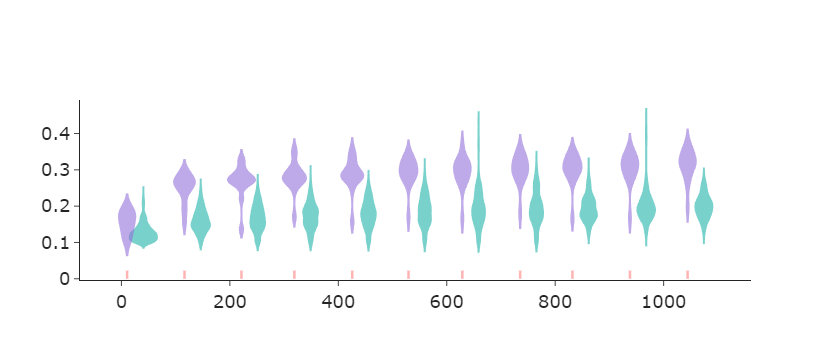

In [394]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['20', '50']
shifts = [0, -10, 10]
width = 50
point = False

df = pc_df_long[(pc_df_long.variable == 'purity_shuffle')]
fig.add_trace(
    go.Violin(x=df.training_time+30, y=df.value, name=f"Perm", points=point,
              fillcolor=colors[0], line_color=colors[0], opacity=0.6,
              width=width, scalemode='width')
)
# df = pc_df_long[(pc_df_long.variable == 'purity_shuffle_length')]
# fig.add_trace(
#     go.Violin(x=df.training_time+30, y=df.value, name=f"Perm", points=point,
#               fillcolor=colors[2], line_color=colors[2], opacity=0.6,
#               width=width, scalemode='width')
# )
for i, tags in enumerate([update_tags_3m17_more]):
    df = pc_df_long[(pc_df_long.variable == 'purity') & (pc_df_long.tag.isin(tags))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df.value, name=f"SEM-to-human",
                  fillcolor=colors[i+1], line_color=colors[i+1], opacity=0.6,
                  points=point, width=width, scalemode='width')
    )
# fig.add_annotation(x=900, y=0.42,
#         text="SEM-to-human",
#         font=dict(
#         # family="sans serif",
#         size=18,
#         color=colors[1]
#         ),
#         showarrow=False,
#         )

    

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(#title=dict(text="Purity of SEM Action Categorization"),
                 showlegend=False)
# fig.update_xaxes(title_text="Amount of Training (minutes)")
# fig.update_yaxes(title_text="Purity")
fig.update_layout(shapes=[{'type': 'line','y0':0,'y1': 0.05 * 0.45,'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in pc_df_long.training_time.unique()])
fig.show()

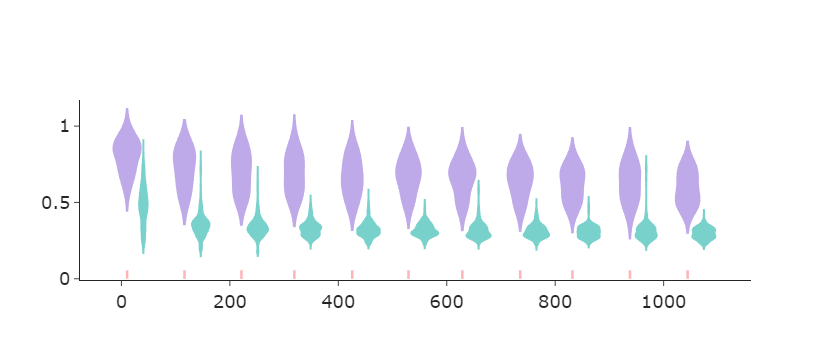

In [396]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['20', '50']
shifts = [0, -10, 10]
point = False
width = 50

# df = pc_df_long[(pc_df_long.variable == 'coverage_shuffle')]
# fig.add_trace(
#     go.Violin(x=df.training_time-30, y=df.value, name=f"Perm", points=point,
#               fillcolor=colors[0], line_color=colors[0], opacity=0.6,
#               width=width, scalemode='width')
# )
df = pc_df_long[(pc_df_long.variable == 'coverage_shuffle_length')]
fig.add_trace(
    go.Violin(x=df.training_time+30, y=df.value, name=f"Perm", points=point,
              fillcolor=colors[0], line_color=colors[0], opacity=0.6,
              width=width, scalemode='width')
)
for i, tags in enumerate([update_tags_3m17_more]):
    df = pc_df_long[(pc_df_long.variable == 'coverage') & (pc_df_long.tag.isin(tags))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df.value, name=f"SEM-to-human",
                  fillcolor=colors[i+1], line_color=colors[i+1], opacity=0.6,
                  points=point, width=width, scalemode='width')
    )
    
# fig.add_annotation(x=900, y=1.1,
#         text="SEM-to-human",
#         font=dict(
#         # family="sans serif",
#         size=18,
#         color=colors[1]
#         ),
#         showarrow=False,
#         )
# fig.add_annotation(x=900, y=0.08,
#         text="event-length-and-activation-time",
#         font=dict(
#         # family="sans serif",
#         size=18,
#         color=colors[0]
#         ),
#         showarrow=False,
#         )
# fig.add_annotation(x=1300, y=0.2,
#         text="only-event-length",
#         font=dict(
#         # family="sans serif",
#         size=18,
#         color=colors[2]
#         ),
#         showarrow=False,
#         )
    
fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(#title=dict(text="Purity of SEM Action Categorization"),
                 showlegend=False)
# fig.update_xaxes(title_text="Amount of Training (minutes)")
# fig.update_yaxes(title_text="Coverage")
fig.update_layout(shapes=[{'type': 'line','y0':0,'y1': 0.05 * 1.1,'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in pc_df_long.training_time.unique()])
fig.show()

In [8]:
# sem_to_intervals = dict()
# action_to_intervals = dict()
# for e_hat in schemadf.e_hat.unique():
#     sem_to_intervals[e_hat] = []
# for ev_fact in schemadf.ev_fact.unique():
#     action_to_intervals[ev_fact] = []

# prev_e_hat = schemadf.iloc[0].e_hat
# prev_e_hat_sec = schemadf.iloc[0].sec
# for i, row in schemadf.iterrows():
#     if i == 0:
#         continue
# #     if i > 5000:
# #         break
#     if row.e_hat != prev_e_hat:
#         sem_to_intervals[prev_e_hat].append([prev_e_hat_sec, row.sec])
#         prev_e_hat_sec = row.sec
#         prev_e_hat = row.e_hat
# sem_to_intervals[prev_e_hat].append([prev_e_hat_sec, row.sec + 0.33])
        
# prev_ev_fact = schemadf.iloc[0].ev_fact
# prev_ev_fact_sec = schemadf.iloc[0].sec
# for i, row in schemadf.iterrows():
#     if i == 0:
#         continue
# #     if i > 5000:
# #         break
#     if row.ev_fact != prev_ev_fact:
#         action_to_intervals[prev_ev_fact].append([prev_ev_fact_sec, row.sec])
#         prev_ev_fact_sec = row.sec
#         prev_ev_fact = row.ev_fact
# action_to_intervals[prev_ev_fact].append([prev_ev_fact_sec, row.sec + 0.33])

In [13]:
# schemadf['e_hat_switch'] = np.hstack([[1], (np.array(schemadf['e_hat'])[1:] != np.array(schemadf['e_hat'])[:-1])])

# SEM's Event Schemas

In [33]:
# cache_tags = update_tags_3m15 + update_tags_305 + update_tags_304 + update_tags_3m14 + \
#                 update_tags_306 + update_tags_307 + update_tags_316 + update_tags_317 + \
#                 update_tags_3m26 + update_tags_3m24 + update_tags_3m16 + update_tags_3m17 + \
#                 update_tags_205 + update_tags_2m15 + update_tags_4m15 + update_tags_4m24 + \
#                 update_tags_noskel_3m17 + update_tags_w_generic_3m15 + update_tags_wo_filler_3m15 + \
#                 update_tags_pristine_3m15 + update_tags_wo_kappa_3m15 + \
#                 update_tags_wo_kappa_wo_filler_3m15 + update_tags_w_generic_wo_filler_3m15 + \
#                 update_tags_w_generic_wo_kappa_3m15 + \
#                 update_tags_3m17_more + update_tags_nomo_3m17
cache_tags = sum(name_to_tags.values(), [])
cache_tags = update_tags_3m17_more

## Metrics from DF

In [39]:
event_df = pd.read_csv('output/run_sem/results_purity_coverage.csv')
event_df.run = event_df.run.apply(lambda x: x.split('_')[0])
event_df.head(5)

/home/n.tan/.conda/envs/sem-viz-jupyter/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning:

Columns (13) have mixed types.Specify dtype option on import or set low_memory=False.



,run,grain,bicorr,percentile,n_event_models,active_event_models,epoch,number_boundaries,sem_params,tag,mean_pe,std_pe,pearson_r,is_train,switch_old,switch_new,switch_current,entropy,purity,coverage
0,2.4.7,coarse,0.129385,28.125000,25.0,0.0,1.0,48.0,"{'lmda': 10000.0, 'alfa': 0.01, 'kappa': 1.0, ...",test_aug_27,0.832934,0.374530,0.191668,True,22.0,26.0,0.0,0.53779,0.474128,0.481329
1,6.1.10,coarse,0.258689,34.285714,25.0,0.0,1.0,117.0,"{'lmda': 10000.0, 'alfa': 0.01, 'kappa': 1.0, ...",test_aug_27,0.998333,0.358805,0.398338,False,117.0,0.0,0.0,0.53779,0.294665,0.335752
2,2.4.9,coarse,0.246203,37.931034,25.0,0.0,1.0,57.0,"{'lmda': 10000.0, 'alfa': 0.01, 'kappa': 1.0, ...",test_aug_27,0.834631,0.265686,0.356141,False,57.0,0.0,0.0,0.53779,0.555525,0.673581
3,6.3.10,coarse,0.103545,11.428571,25.0,0.0,1.0,71.0,"{'lmda': 10000.0, 'alfa': 0.01, 'kappa': 1.0, ...",test_aug_27,0.959081,0.274752,0.164674,False,71.0,0.0,0.0,0.53779,0.188855,0.386891
4,4.1.9,coarse,0.125924,18.918919,25.0,0.0,1.0,51.0,"{'lmda': 10000.0, 'alfa': 0.01, 'kappa': 1.0, ...",test_aug_27,1.119962,0.415455,0.179190,False,51.0,0.0,0.0,0.53779,0.511264,0.569283


### #Created schemas against time

In [68]:
df_select = event_df.loc[event_df.tag.isin(update_tags_3m17_more) ,['n_event_models', 'epoch']]
df_select = df_select.append({'n_event_models': 0, 'epoch': 0}, ignore_index=True)
first_der = df_select.groupby('epoch').mean().reset_index()
first_der['n_new_events'] =  first_der['n_event_models'] - first_der['n_event_models'].shift(1)
first_der

,epoch,n_event_models,n_new_events
0,0.0,0.0000,NaN
1,1.0,4.3125,4.3125
2,2.0,6.4375,2.1250
3,3.0,8.5625,2.1250
4,4.0,9.6250,1.0625
...,...,...,...
104,104.0,36.9375,0.0000
105,105.0,37.1250,0.1875
106,106.0,37.1875,0.0625
107,107.0,37.3125,0.1250


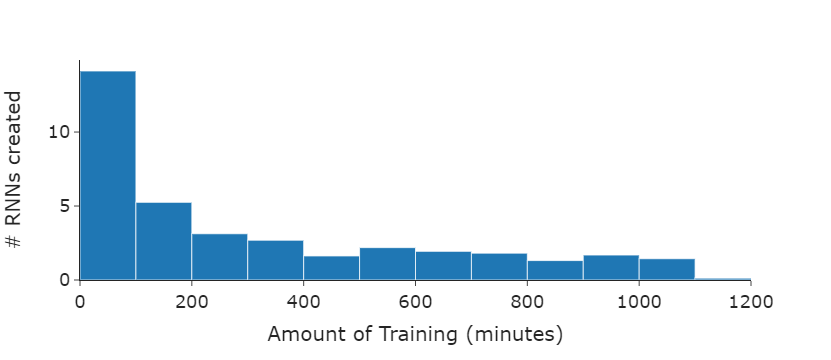

In [74]:
first_der['training_time'] = first_der['epoch'].map(epoch_to_duration)
first_der['training_time'] = first_der['training_time'] / 60
fig = px.histogram(first_der, x='training_time', y='n_new_events')
fig.update_yaxes(y_axis, title_text="# RNNs created")
fig.update_xaxes(x_axis, title_text="Amount of Training (minutes)")
fig.update_layout(layout)
fig.show()

### Multi tags, multi metrics

In [41]:
# metrics = ['bicorr', 'pearson_r', 'n_event_models', 'number_boundaries', 'mean_pe', 'entropy']
# metrics = ['mean_pe', 'pearson_r', 'n_event_models', 'number_boundaries']
metrics = ['mean_pe']
n_rnns = event_df[(event_df.run.isin(valid_runs))]
# n_rnns = n_rnns[n_rnns.run.isin(valid_runs) & (n_rnns.grain == 'coarse')][['epoch', 'tag'] + metrics]
n_rnns = n_rnns[(n_rnns.grain == 'coarse')][['epoch', 'tag'] + metrics]
n_rnns = n_rnns.groupby(['epoch', 'tag']).mean().reset_index()
n_rnns.tail()

,epoch,tag,mean_pe
7328,176.0,feb_11_cleaned_segmentation_grid_lr1E-03_alfa1...,0.632292
7329,176.0,feb_11_cleaned_segmentation_grid_lr1E-03_alfa1...,0.627612
7330,176.0,feb_11_cleaned_segmentation_grid_lr1E-03_alfa1...,0.635430
7331,176.0,feb_11_cleaned_segmentation_grid_lr1E-03_alfa1...,0.646874
7332,176.0,feb_11_cleaned_segmentation_grid_lr1E-03_alfa1...,0.639626


In [36]:
# # for plotting # event models
# for t in n_rnns.tag.unique():
#     n_rnns.loc[len(n_rnns), :] = [0, t, 0]
# n_rnns.tail()

In [45]:
n_rnns_long = pd.melt(n_rnns, id_vars=["epoch", "tag"], value_vars=metrics)

In [46]:
n_rnns_long['training_time'] = n_rnns_long['epoch'].map(epoch_to_duration)
n_rnns_long['training_time'] = n_rnns_long['training_time'] / 60
n_rnns_long.head()

,epoch,tag,variable,value,training_time
0,1.0,april_04_grid_lr1E-03_alfa1E-01_lmda1E+05,mean_pe,1.092133,11.209184
1,1.0,april_04_grid_lr1E-03_alfa1E-01_lmda1E+06,mean_pe,1.103410,11.209184
2,1.0,april_04_grid_lr1E-03_alfa1E-02_lmda1E+05,mean_pe,1.098921,11.209184
3,1.0,april_04_grid_lr1E-03_alfa1E-02_lmda1E+06,mean_pe,0.954907,11.209184
4,1.0,aug_05_n15_1010_1E-03_1E-01_1E+07,mean_pe,1.348895,11.209184


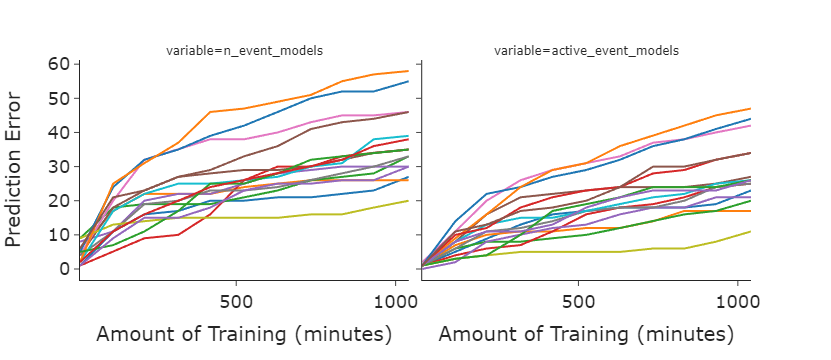

In [45]:
fig = px.line(data_frame=n_rnns_long.sort_values(by=['training_time']), 
                 x='training_time', y='value',
                 color='tag',
                 facet_col='variable',
                 labels=dict(value="Prediction Error", training_time="") 
                )
fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(#title=dict(text="Compare Prediction Errors between SEM and Generic Models"),
                 showlegend=False,
                 # width=600, height=600
)
# fig.update_xaxes(tickfont=dict(size=14))
fig.update_xaxes(title_text="\t\t\t\tAmount of Training (minutes)")
# model_names = {'pe': 'SEM', 'pe_w': 'Generic Model', 'pe_w2': 'Generic Model (Double)',
#                'pe_w3': 'Generic Model (Triple)'}
# fig.for_each_annotation(lambda a: a.update(text=model_names[a.text.split('=')[-1]]))
fig.update_traces(opacity=.5, selector=dict(type='line'))
# fig.update_traces(marker=dict(opacity=1.0), selector=dict(type='scatter'))

fig.show()

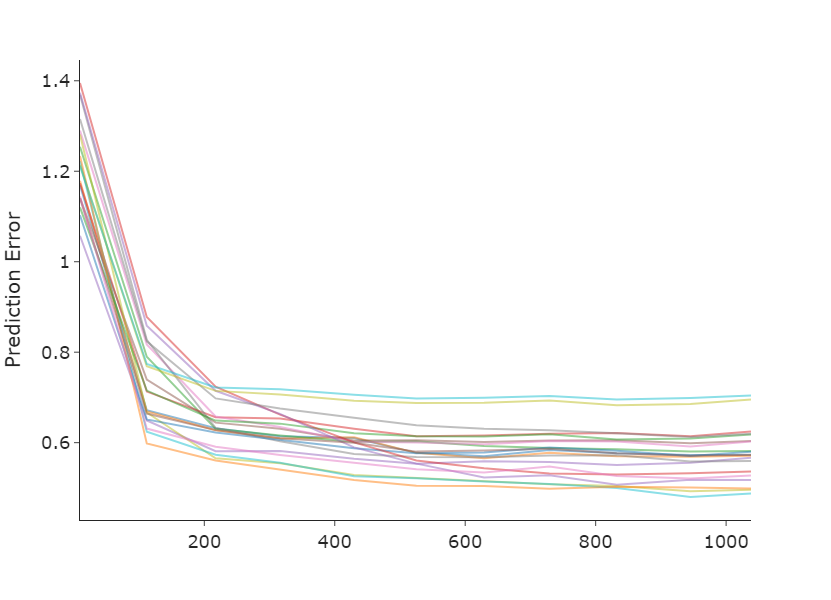

In [17]:
fig = px.line(data_frame=n_rnns_long, 
                 x='training_time', y='value',
                 color='run',
                 labels=dict(value="Prediction Error", training_time="") 
                )
fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(#title=dict(text="Compare Prediction Errors between SEM and Generic Models"),
                 showlegend=False,
                 width=600, height=600
)
# fig.update_xaxes(tickfont=dict(size=14))
# fig.update_xaxes(title_text="\t\t\t\tAmount of Training (minutes)", row=1, col=2)
# model_names = {'pe': 'SEM', 'pe_w': 'Generic Model', 'pe_w2': 'Generic Model (Double)',
#                'pe_w3': 'Generic Model (Triple)'}
# fig.for_each_annotation(lambda a: a.update(text=model_names[a.text.split('=')[-1]]))
fig.update_traces(opacity=.5, selector=dict(type='scatter'))
fig.update_traces(marker=dict(opacity=1.0), selector=dict(type='scatter'))

fig.show()

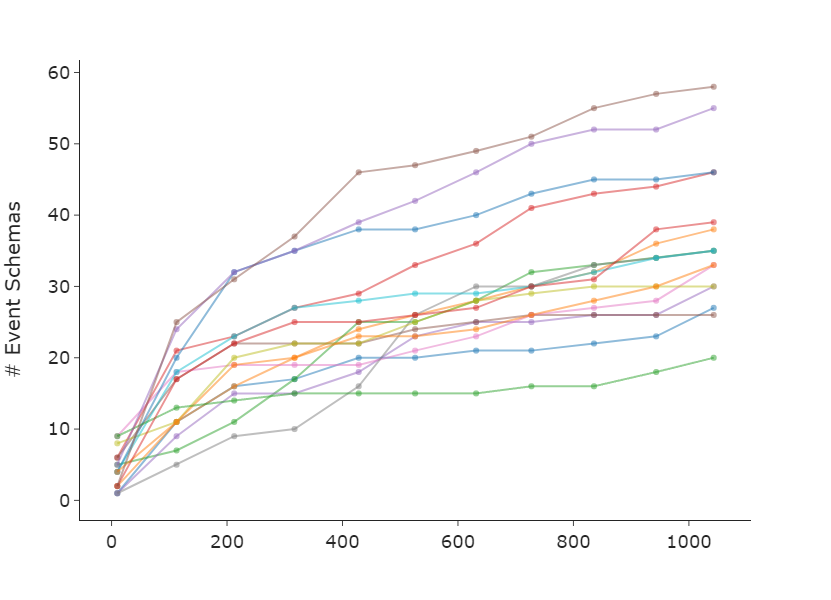

In [345]:
fig = px.scatter(data_frame=n_rnns_long[(n_rnns_long.epoch % 2 == 1) & 
                                        (n_rnns_long.tag.isin(update_tags_3m17_more))], 
                 x='training_time', y='value', 
                 # facet_col='variable', 
                 # facet_col_wrap=2,
                 trendline='rolling', trendline_options={'window': 1},
                 opacity=0.6, 
                 color='tag',
                 labels=dict(value="# Event Schemas", training_time="") 
                )
fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(#title=dict(text="Compare Prediction Errors between SEM and Generic Models"),
                 showlegend=False,
                 width=600, height=600
)
# fig.update_xaxes(tickfont=dict(size=14))
# fig.update_xaxes(title_text="\t\t\t\tAmount of Training (minutes)", row=1, col=2)
# model_names = {'pe': 'SEM', 'pe_w': 'Generic Model', 'pe_w2': 'Generic Model (Double)',
#                'pe_w3': 'Generic Model (Triple)'}
# fig.for_each_annotation(lambda a: a.update(text=model_names[a.text.split('=')[-1]]))
fig.update_traces(opacity=.5, selector=dict(type='scatter'))
fig.update_traces(marker=dict(opacity=1.0), selector=dict(type='scatter'))

fig.show()

In [50]:
n_rnns['training_time'] = n_rnns['epoch'].map(epoch_to_duration)
n_rnns['training_time'] = n_rnns['training_time'] / 60
n_rnns.head()

,epoch,tag,mean_pe,training_time
0,1.0,april_04_grid_lr1E-03_alfa1E-01_lmda1E+05,1.092133,11.209184
1,1.0,april_04_grid_lr1E-03_alfa1E-01_lmda1E+06,1.103410,11.209184
2,1.0,april_04_grid_lr1E-03_alfa1E-02_lmda1E+05,1.098921,11.209184
3,1.0,april_04_grid_lr1E-03_alfa1E-02_lmda1E+06,0.954907,11.209184
4,1.0,aug_05_n15_1010_1E-03_1E-01_1E+07,1.348895,11.209184


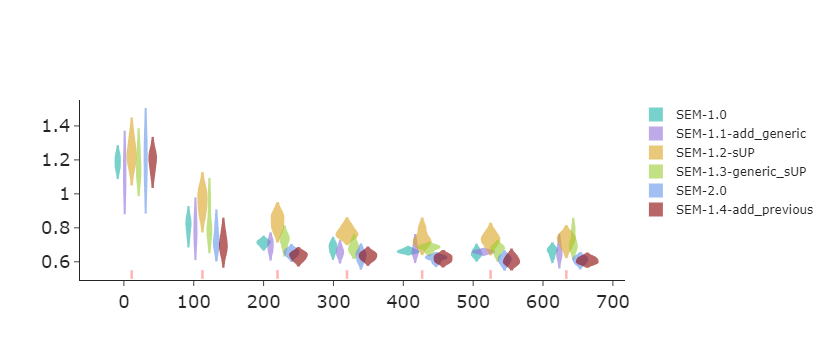

In [67]:

fig = go.Figure()
tag_names = ['SEM-1.0', 'SEM-1.1-add_generic', 'SEM-1.2-sUP', 'SEM-1.3-generic_sUP', 'SEM-2.0', 'SEM-1.4-add_previous']
group_tags = [update_tags_pristine_3m15[:4], update_tags_w_generic_3m15[:4], \
        update_tags_wo_kappa_3m15[:4], update_tags_w_generic_wo_kappa_3m15[:4], \
        update_tags_3m15[:5], update_tags_wo_filler_3m15[:4]]
shifts = [-20, -10, 0, 10, 20, 30]


for i, tags in enumerate(group_tags):
    df = n_rnns[(n_rnns.tag.isin(tags)) & (n_rnns.epoch.isin(range(1, 62, 10)))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df[f'mean_pe'], name=f"{tag_names[i]}", points=False,
                  fillcolor=colors[i], line_color=colors[i], opacity=0.6,
                  width=30, scalemode='width')
    )
    

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(
                 showlegend=True)

fig.update_layout(shapes=[{'type': 'line','y0':0.5,'y1': 0.55,'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in df.training_time.unique()],
                 width=800)
fig.show()

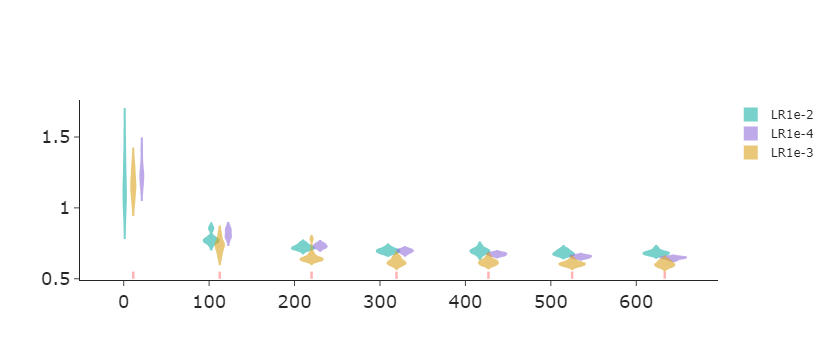

In [61]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['LR1e-2', 'LR1e-4', 'LR1e-3']
shifts = [-10, 10, 0]

# for i, tags in enumerate([update_tags_3m15 + update_tags_2m15, 
#                           update_tags_305 + update_tags_205]):
# for i, tags in enumerate([update_tags_3m15 + update_tags_305, 
#                           update_tags_306 + update_tags_3m26]):
for i, tags in enumerate([update_tags_2m15 + update_tags_205,
                          update_tags_4m24 + update_tags_4m15,
                          update_tags_3m15 + update_tags_305 + update_tags_3305_anneal]):
    df = n_rnns[(n_rnns.tag.isin(tags)) & (n_rnns.epoch.isin(range(1, 62, 10)))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df[f'mean_pe'], name=f"{tag_names[i]}", points=False,
                  fillcolor=colors[i], line_color=colors[i], opacity=0.6,
                  width=30, scalemode='width')
    )
    

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(#title=dict(text="Purity of SEM Action Categorization"),
                 showlegend=True)
# fig.update_xaxes(title_text="Amount of Training (minutes)")
# fig.update_yaxes(title_text=f"Prediction Error")
# fig.add_annotation(dict(font=dict(color='black',size=17),
#                                         x=.3,
#                                         y=.9,
#                                         showarrow=False,
#                                         text="Each violin groups over<br>Concentration=[1e-1, 1e0]<br>LR=[1e-2, 1e-3, 1e-4]",
#                                         textangle=0,
#                                         xanchor='left',
#                                         xref="paper",
#                                         yref="paper"))
fig.update_layout(shapes=[{'type': 'line','y0':0.5,'y1': 0.55,'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in df.training_time.unique()],
                 width=800)
fig.show()

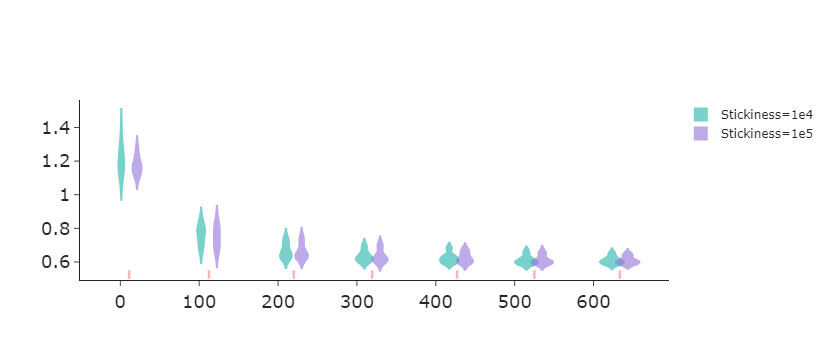

In [65]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['Stickiness=1e4', 'Stickiness=1e5']
shifts = [-10, 10, 0]

# update_tags_3m15 + update_tags_305 + update_tags_304 + update_tags_3m14 + \
#                 update_tags_306 + update_tags_307 + update_tags_316 + update_tags_317 + \
#                 update_tags_3m26 + update_tags_3m24 + update_tags_3m16 + update_tags_3m17 + \
#                 update_tags_205 + update_tags_2m15 + update_tags_4m15 + update_tags_4m24 + \
for i, tags in enumerate([update_tags_3m15 + update_tags_4m15 + update_tags_3m24,
                          update_tags_4m24 + update_tags_3m24 + update_tags_3m14]):
    df = n_rnns[(n_rnns.tag.isin(tags)) & (n_rnns.epoch.isin(range(1, 62, 10)))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df[f'mean_pe'], name=f"{tag_names[i]}", points=False,
                  fillcolor=colors[i], line_color=colors[i], opacity=0.6,
                  width=30, scalemode='width')
    )
    

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(#title=dict(text="Purity of SEM Action Categorization"),
                 showlegend=True)
# fig.update_xaxes(title_text="Amount of Training (minutes)")
# fig.update_yaxes(title_text=f"Prediction Error")
# fig.add_annotation(dict(font=dict(color='black',size=17),
#                                         x=.3,
#                                         y=.9,
#                                         showarrow=False,
#                                         text="Each violin groups over<br>Concentration=[1e-1, 1e0]<br>LR=[1e-2, 1e-3, 1e-4]",
#                                         textangle=0,
#                                         xanchor='left',
#                                         xref="paper",
#                                         yref="paper"))
fig.update_layout(shapes=[{'type': 'line','y0':0.5,'y1': 0.55,'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in df.training_time.unique()],
                 width=800)
fig.show()

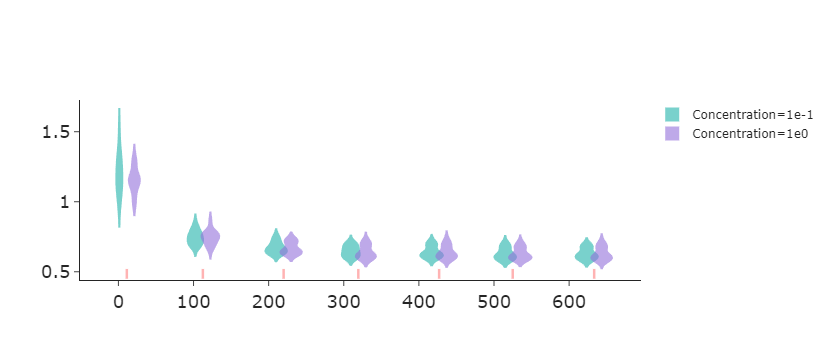

In [64]:
# fig = px.violin(biserial_all_long[biserial_all_long.variable != 'bi'], x="epoch", y="value", color="tag",
#                 title="Segmentation Agreement with Human Subjects")
fig = go.Figure()
tag_names = ['Concentration=1e-1', 'Concentration=1e0']
shifts = [-10, 10, 0]

# update_tags_3m15 + update_tags_305 + update_tags_304 + update_tags_3m14 + \
#                 update_tags_306 + update_tags_307 + update_tags_316 + update_tags_317 + \
#                 update_tags_3m26 + update_tags_3m24 + update_tags_3m16 + update_tags_3m17 + \
#                 update_tags_205 + update_tags_2m15 + update_tags_4m15 + update_tags_4m24 + \
for i, tags in enumerate([update_tags_3m15 + update_tags_3m16 + update_tags_2m15,
                          update_tags_305 + update_tags_306 + update_tags_205]):
    df = n_rnns[(n_rnns.tag.isin(tags)) & (n_rnns.epoch.isin(range(1, 62, 10)))]
    fig.add_trace(
        go.Violin(x=df.training_time+shifts[i], y=df[f'mean_pe'], name=f"{tag_names[i]}", points=False,
                  fillcolor=colors[i], line_color=colors[i], opacity=0.6,
                  width=30, scalemode='width')
    )
    

fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(#title=dict(text="Purity of SEM Action Categorization"),
                 showlegend=True)
# fig.update_xaxes(title_text="Amount of Training (minutes)")
# fig.update_yaxes(title_text=f"Prediction Error")
# fig.add_annotation(dict(font=dict(color='black',size=17),
#                                         x=.3,
#                                         y=.9,
#                                         showarrow=False,
#                                         text="Each violin groups over<br>Concentration=[1e-1, 1e0]<br>LR=[1e-2, 1e-3, 1e-4]",
#                                         textangle=0,
#                                         xanchor='left',
#                                         xref="paper",
#                                         yref="paper"))
fig.update_layout(shapes=[{'type': 'line','y0':0.45,'y1': 0.52,'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in df.training_time.unique()],
                 width=800)
fig.show()

## Schema Activations

In [215]:
seed = 3
names = ['SEM-1.0', 'SEM-1.1-add_generic', 'SEM-1.2-sUP', 'SEM-1.3-generic_sUP', 'SEM-2.0', 'SEM-1.4-add_previous']
# names = ['SEM-1.0', 'SEM-1.1-add_generic', 'SEM-1.2-sUP', 'SEM-1.3-generic_sUP', 'SEM-1.4-add_previous', 'SEM-2.0']
tags = [update_tags_pristine_3m15[seed], update_tags_w_generic_3m15[seed], \
        update_tags_wo_kappa_3m15[seed], update_tags_w_generic_wo_kappa_3m15[seed], \
        update_tags_3m15[seed+1], update_tags_wo_filler_3m15[seed]]
# tags = [update_tags_pristine_3m15[seed], update_tags_w_generic_3m15[seed], \
#         update_tags_wo_kappa_3m15[seed], update_tags_w_generic_wo_kappa_3m15[seed], \
#         update_tags_wo_filler_3m15[seed], update_tags_3m15[seed+1]]
list(zip(names, tags))

[('SEM-1.0', 'july_12_pristine_1040_1E-03_1E-01_1E+05'),
 ('SEM-1.1-add_generic', 'july_12_w_generic_1040_1E-03_1E-01_1E+05'),
 ('SEM-1.2-sUP', 'july_12_w_kappa_1040_1E-03_1E-01_1E+05'),
 ('SEM-1.3-generic_sUP', 'july_17_wo_kappa_w_generic_1040_1E-03_1E-01_1E+05'),
 ('SEM-2.0', 'june_28_1050_update_event_models'),
 ('SEM-1.4-add_previous', 'july_12_wo_filler_1040_1E-03_1E-01_1E+05')]

In [216]:
df = pd.DataFrame()
for n, t in zip(names, tags):
    readout_dataframes = pkl.load(open(f'output/run_sem/{t}/{valid_runs[10]}_kinect_trim{t}_diagnostic_41.pkl', 'rb'))
    train = pd.DataFrame({'c': readout_dataframes['c']})
    train = train[train.c > 0]
    train['schema'] = train.index
    val = pd.DataFrame({'c_eval': readout_dataframes['c_eval']})
    # val = val[val.c_eval > 0]
    val['schema'] = val.index
    activation = train.merge(val[['schema', 'c_eval']], on = 'schema', how = 'left')
    activation['tag'] = n
    # activation['schema'] = activation.index
    df = pd.concat([df, activation])
df.head(5)

,c,schema,c_eval,tag
0,22374.0,0,21394.0,SEM-1.0
1,1018.0,1,69.0,SEM-1.0
2,2.0,2,483.0,SEM-1.0
3,6.0,3,1656.0,SEM-1.0
4,12110.0,4,50684.0,SEM-1.0


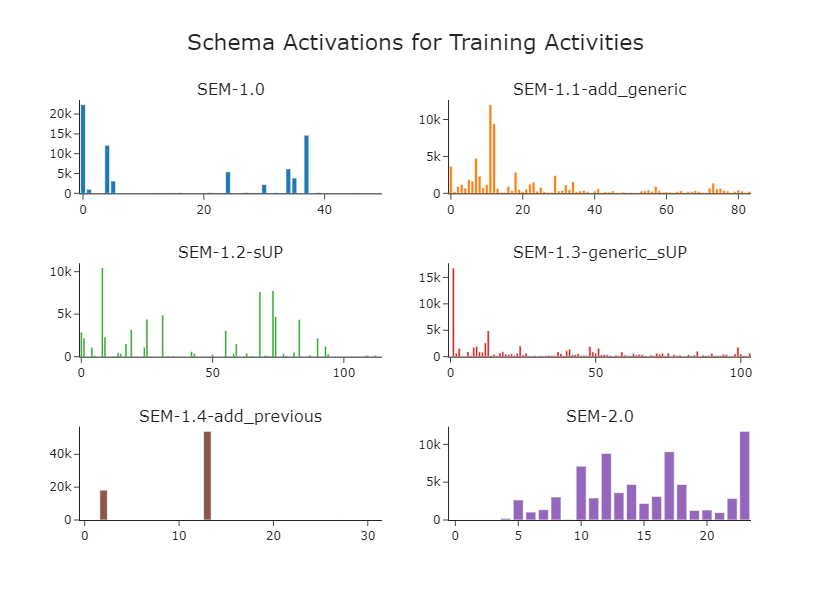

In [219]:
from plotly.subplots import make_subplots
fig = make_subplots(rows=3, cols=2, 
                    subplot_titles=['SEM-1.0', 'SEM-1.1-add_generic', 'SEM-1.2-sUP', 'SEM-1.3-generic_sUP', 'SEM-1.4-add_previous', 'SEM-2.0']
                   )
for i, n in enumerate(names):
    df_select = df[df.tag == n]
    fig.add_trace(
    go.Bar(x=df_select.schema, y=df_select.c, name=f'{n}',
                 # xbins=go.histogram.XBins(size=1, start=0, end=len(activation)+2)
            ),
        row=(i//2 + 1), col=(i%2+1) if i < 4 else ((i+1)%2+1)
    )
# fig.update_traces(marker_color='brown', selector=dict(name="SEM-1.4-add_previous"))
fig.update_layout(layout, showlegend=False, 
                  title_text="Schema Activations for Training Activities", 
                  width=900, height=600)

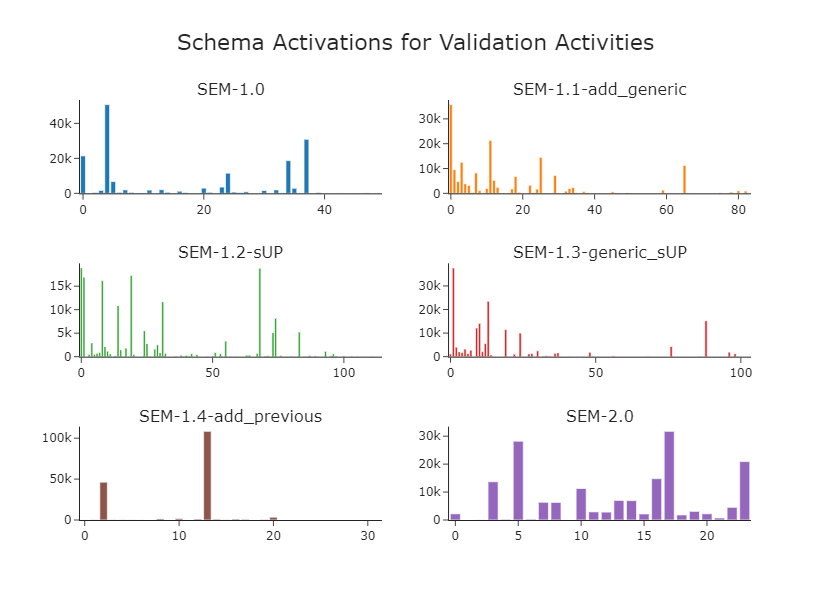

In [220]:
fig = make_subplots(rows=3, cols=2, 
                    subplot_titles=['SEM-1.0', 'SEM-1.1-add_generic', 'SEM-1.2-sUP', 'SEM-1.3-generic_sUP', 'SEM-1.4-add_previous', 'SEM-2.0']
                   )
for i, n in enumerate(names):
    df_select = df[df.tag == n]
    fig.add_trace(
    go.Bar(x=df_select.schema, y=df_select.c_eval,
                 # xbins=go.histogram.XBins(size=1, start=0, end=len(activation)+2)
            ),
        row=(i//2 + 1), col=(i%2+1) if i < 4 else ((i+1)%2+1)
    )
fig.update_layout(layout, showlegend=False, 
                  title_text="Schema Activations for Validation Activities",
                  width=900, height=600)

## Entropy

In [82]:
names = ['SEM-1.0', 'SEM-1.1-add_generic', 'SEM-1.2-sUP', 'SEM-1.3-generic_sUP', 'SEM-2.0', 'SEM-1.4-add_previous']
group_tags = [update_tags_pristine_3m15[:4], update_tags_w_generic_3m15[:4], \
        update_tags_wo_kappa_3m15[:4], update_tags_w_generic_wo_kappa_3m15[:4], \
        update_tags_3m15[:5], update_tags_wo_filler_3m15[:4]]
# list(zip(names, group_tags))

In [83]:
df = pd.DataFrame()
for n, tags in zip(names, group_tags):
    for t in tags:
        try:
            readout_dataframes = pkl.load(open(f'output/run_sem/{t}/{valid_runs[10]}_kinect_trim{t}_diagnostic_61.pkl', 'rb'))
            train = pd.DataFrame({'c': readout_dataframes['c']})
            train = train[train.c > 0]
            train['schema'] = train.index
            val = pd.DataFrame({'c_eval': readout_dataframes['c_eval']})
            # val = val[val.c_eval > 0]
            val['schema'] = val.index
            activation = train.merge(val[['schema', 'c_eval']], on = 'schema', how = 'left')
            activation['version'] = n
            activation['tag'] = t
            # activation['schema'] = activation.index
            df = pd.concat([df, activation])
        except:
            continue
df.head(5)

,c,schema,c_eval,version,tag
0,2.0,0,817.0,SEM-1.0,july_12_pristine_1010_1E-03_1E-01_1E+05
1,5893.0,1,16097.0,SEM-1.0,july_12_pristine_1010_1E-03_1E-01_1E+05
2,20.0,2,0.0,SEM-1.0,july_12_pristine_1010_1E-03_1E-01_1E+05
3,3.0,3,694.0,SEM-1.0,july_12_pristine_1010_1E-03_1E-01_1E+05
4,39.0,4,92.0,SEM-1.0,july_12_pristine_1010_1E-03_1E-01_1E+05


In [84]:
import scipy.stats as stats
def raw_entropy(c):
    return round(stats.entropy(c), 2)
def norm_entropy(c):
    return round(stats.entropy(c) / np.log((c > 0).sum()), 2)

In [85]:
df_norm = df.groupby(['version', 'tag'])[['c', 'c_eval']].agg({"c": norm_entropy, 
                                                             "c_eval": norm_entropy})
df_norm

c  \
version              tag                                                       
SEM-1.0              july_12_pristine_1010_1E-03_1E-01_1E+05            0.51   
                     july_12_pristine_1020_1E-03_1E-01_1E+05            0.58   
                     july_12_pristine_1030_1E-03_1E-01_1E+05            0.65   
                     july_12_pristine_1040_1E-03_1E-01_1E+05            0.52   
SEM-1.1-add_generic  july_12_w_generic_1010_1E-03_1E-01_1E+05           0.69   
                     july_12_w_generic_1020_1E-03_1E-01_1E+05           0.66   
                     july_12_w_generic_1030_1E-03_1E-01_1E+05           0.74   
                     july_12_w_generic_1040_1E-03_1E-01_1E+05           0.79   
SEM-1.2-sUP          july_12_w_kappa_1010_1E-03_1E-01_1E+05             0.67   
                     july_12_w_kappa_1020_1E-03_1E-01_1E+05             0.68   
                     july_12_w_kappa_1030_1E-03_1E-01_1E+05             0.65   
                     july_12_w_kappa_1040_1E-03_1E-01_1E+05             0.62   
SEM-1.3-generic_sUP  july_17_wo_kappa_w_generic_1010_1E-03_1E-01_1E+05  0.88   
                     july_17_wo_kappa_w_generic_1020_1E-03_1E-01_1E+05  0.91   
                     july_17_wo_kappa_w_generic_1030_1E-03_1E-01_1E+05  0.91   
                     july_17_wo_kappa_w_generic_1040_1E-03_1E-01_1E+05  0.81   
SEM-1.4-add_previous july_12_wo_filler_1010_1E-03_1E-01_1E+05           0.43   
                     july_12_wo_filler_1020_1E-03_1E-01_1E+05           0.39   
                     july_12_wo_filler_1030_1E-03_1E-01_1E+05           0.26   
                     july_12_wo_filler_1040_1E-03_1E-01_1E+05           0.16   
SEM-2.0              june_28_1010_update_event_models                   0.81   
                     june_28_1020_update_event_models                   0.89   
                     june_28_1030_update_event_models                   0.83   
                     june_28_1050_update_event_models                   0.81   

                                                                        c_eval  
version              tag                                                        
SEM-1.0              july_12_pristine_1010_1E-03_1E-01_1E+05              0.64  
                     july_12_pristine_1020_1E-03_1E-01_1E+05              0.65  
                     july_12_pristine_1030_1E-03_1E-01_1E+05              0.72  
                     july_12_pristine_1040_1E-03_1E-01_1E+05              0.61  
SEM-1.1-add_generic  july_12_w_generic_1010_1E-03_1E-01_1E+05             0.61  
                     july_12_w_generic_1020_1E-03_1E-01_1E+05             0.64  
                     july_12_w_generic_1030_1E-03_1E-01_1E+05             0.66  
                     july_12_w_generic_1040_1E-03_1E-01_1E+05             0.74  
SEM-1.2-sUP          july_12_w_kappa_1010_1E-03_1E-01_1E+05               0.72  
                     july_12_w_kappa_1020_1E-03_1E-01_1E+05               0.75  
                     july_12_w_kappa_1030_1E-03_1E-01_1E+05               0.73  
                     july_12_w_kappa_1040_1E-03_1E-01_1E+05               0.69  
SEM-1.3-generic_sUP  july_17_wo_kappa_w_generic_1010_1E-03_1E-01_1E+05    0.73  
                     july_17_wo_kappa_w_generic_1020_1E-03_1E-01_1E+05    0.70  
                     july_17_wo_kappa_w_generic_1030_1E-03_1E-01_1E+05    0.71  
                     july_17_wo_kappa_w_generic_1040_1E-03_1E-01_1E+05    0.69  
SEM-1.4-add_previous july_12_wo_filler_1010_1E-03_1E-01_1E+05             0.56  
                     july_12_wo_filler_1020_1E-03_1E-01_1E+05             0.62  
                     july_12_wo_filler_1030_1E-03_1E-01_1E+05             0.45  
                     july_12_wo_filler_1040_1E-03_1E-01_1E+05             0.29  
SEM-2.0              june_28_1010_update_event_models                     0.89  
                     june_28_1020_update_event_models                     0.87  
                     june_28_1030_update_event_mod

In [86]:
df_norm = df_norm.loc[names, :, :]

In [87]:
df_norm = df_norm.reset_index()
df_norm = pd.melt(df_norm, id_vars = ["version", "tag"], value_vars=['c', 'c_eval'])
df_norm.head(5)

,version,tag,variable,value
0,SEM-1.0,july_12_pristine_1010_1E-03_1E-01_1E+05,c,0.51
1,SEM-1.0,july_12_pristine_1020_1E-03_1E-01_1E+05,c,0.58
2,SEM-1.0,july_12_pristine_1030_1E-03_1E-01_1E+05,c,0.65
3,SEM-1.0,july_12_pristine_1040_1E-03_1E-01_1E+05,c,0.52
4,SEM-1.1-add_generic,july_12_w_generic_1010_1E-03_1E-01_1E+05,c,0.69


In [88]:
df_norm['variable'] = df_norm['variable'].apply(lambda x: "Training Activities" if x == "c" else "Validation Activities")

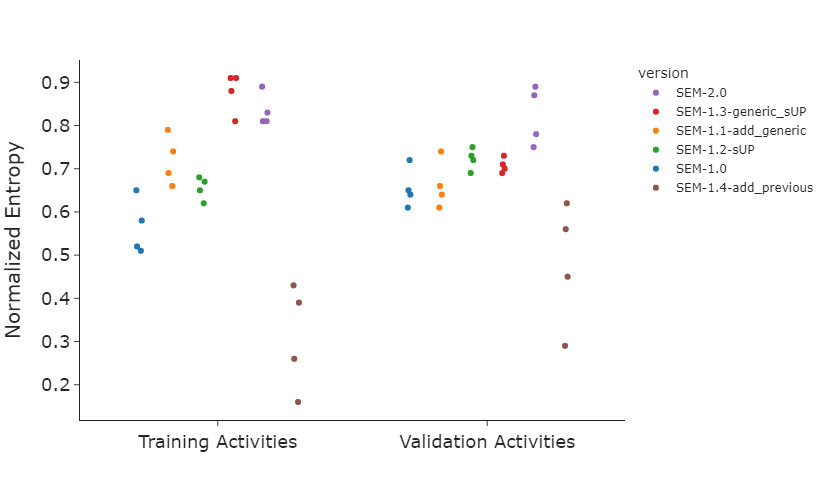

In [89]:
fig = px.strip(df_norm, x='variable', y='value', color='version', hover_name='tag', 
               # category_orders={'version': ['SEM-2.0', 'SEM-1.3-generic-sUP', 'SEM-1.1-add_generic',
                                            # 'SEM-1.0', 'SEM-1.4-add_previous']}
               category_orders={'version': names}
              )
fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(width=800, height=500)
fig.update_xaxes(title_text='')
fig.update_yaxes(title_text='Normalized Entropy')
fig.update_traces(
                  # row=1, col=1,
                  # fillcolor=colors[1], line_color=colors[1], 
                  legendrank=1,
                  # width=100, points=False, scalemode="width", 
                  selector=dict(name="SEM-2.0")
)
fig.update_traces(legendrank=2, selector=dict(name="SEM-1.3-generic_sUP"))
fig.update_traces(legendrank=3, selector=dict(name="SEM-1.1-add_generic"))
fig.update_traces(legendrank=4, selector=dict(name="SEM-1.2-sUP"))
fig.update_traces(legendrank=6, selector=dict(name="SEM-1.0"))
fig.update_traces(legendrank=7, selector=dict(name="SEM-1.4-add_previous"))

fig.show()
# fig.update_layout(title_text='Schema Activation after watching 11 activities')

## Prediction Error (Modifications)

In [68]:
n_rnns

,epoch,tag,mean_pe,training_time
0,1.0,april_04_grid_lr1E-03_alfa1E-01_lmda1E+05,1.092133,11.209184
1,1.0,april_04_grid_lr1E-03_alfa1E-01_lmda1E+06,1.103410,11.209184
2,1.0,april_04_grid_lr1E-03_alfa1E-02_lmda1E+05,1.098921,11.209184
3,1.0,april_04_grid_lr1E-03_alfa1E-02_lmda1E+06,0.954907,11.209184
4,1.0,aug_05_n15_1010_1E-03_1E-01_1E+07,1.348895,11.209184
...,...,...,...,...
7328,176.0,feb_11_cleaned_segmentation_grid_lr1E-03_alfa1...,0.632292,NaN
7329,176.0,feb_11_cleaned_segmentation_grid_lr1E-03_alfa1...,0.627612,NaN
7330,176.0,feb_11_cleaned_segmentation_grid_lr1E-03_alfa1...,0.635430,NaN
7331,176.0,feb_11_cleaned_segmentation_grid_lr1E-03_alfa1...,0.646874,NaN


In [72]:
names = ['SEM-1.0', 'SEM-1.1-add_generic', 'SEM-1.2-sUP', 'SEM-1.3-generic_sUP', 'SEM-2.0', 'SEM-1.4-add_previous']
group_tags = [update_tags_pristine_3m15[:4], update_tags_w_generic_3m15[:4], \
        update_tags_wo_kappa_3m15[:4], update_tags_w_generic_wo_kappa_3m15[:4], \
        update_tags_3m15[:5], update_tags_wo_filler_3m15[:4]]
# list(zip(names, group_tags))
df_pe = deepcopy(n_rnns)
df_pe['version'] = ''
for n, tags in zip(names, group_tags):
    df_pe.loc[df_pe.tag.isin(tags), 'version'] = n

In [74]:
df_pe[df_pe.version == 'SEM-1.0'].head()

,epoch,tag,mean_pe,training_time,version
219,1.0,july_12_pristine_1010_1E-03_1E-01_1E+05,1.213349,11.209184,SEM-1.0
220,1.0,july_12_pristine_1020_1E-03_1E-01_1E+05,1.223623,11.209184,SEM-1.0
221,1.0,july_12_pristine_1030_1E-03_1E-01_1E+05,1.150063,11.209184,SEM-1.0
222,1.0,july_12_pristine_1040_1E-03_1E-01_1E+05,1.166593,11.209184,SEM-1.0
1387,11.0,july_12_pristine_1010_1E-03_1E-01_1E+05,0.855240,112.434764,SEM-1.0


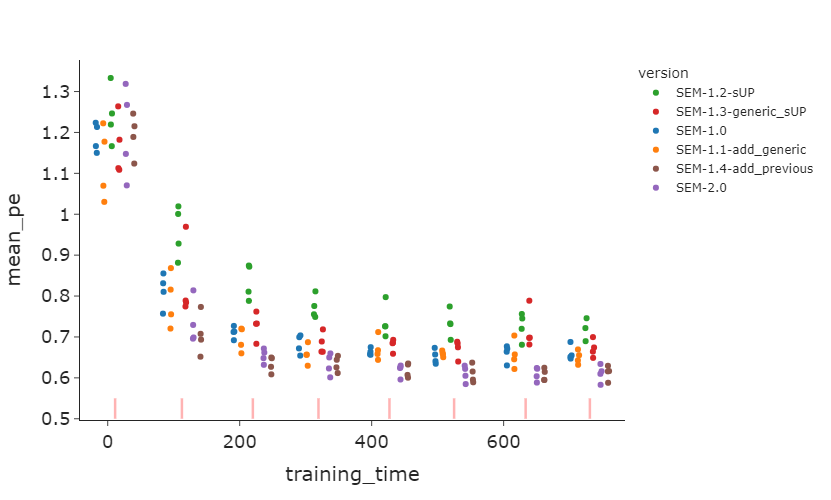

In [90]:
fig = px.strip(df_pe[df_pe.version.isin(names)], x='training_time', y='mean_pe', color='version', hover_name='tag', 
               # category_orders={'version': ['SEM-2.0', 'SEM-1.3-generic-sUP', 'SEM-1.1-add_generic',
                                            # 'SEM-1.0', 'SEM-1.4-add_previous']}
               category_orders={'version': names}
              )
fig.update_layout(layout)
fig.update_xaxes(x_axis)
fig.update_yaxes(y_axis)
fig.update_layout(width=800, height=500)

fig.update_traces(legendrank=7, selector=dict(name="SEM-2.0"))
fig.update_traces(legendrank=2, selector=dict(name="SEM-1.3-generic_sUP"))
fig.update_traces(legendrank=4, selector=dict(name="SEM-1.1-add_generic"))
fig.update_traces(legendrank=1, selector=dict(name="SEM-1.2-sUP"))
fig.update_traces(legendrank=3, selector=dict(name="SEM-1.0"))
fig.update_traces(legendrank=5, selector=dict(name="SEM-1.4-add_previous"))
fig.update_layout(shapes=[{'type': 'line','y0':0.5,'y1': 0.55,'x0': t, 
                           'x1': t,
                           'xref':'x1','yref':'y1',
                           'line': {'color': 'red','width': 2.5}} 
                          for t in df_pe[df_pe.version.isin(names)].training_time.unique()])
fig.show()

In [156]:
matrix_df = pd.read_csv('output/run_sem/results_corpus_entropy.csv')
matrix_df.head(5)

/home/n.tan/.conda/envs/sem-viz-jupyter/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning:

Columns (13) have mixed types.Specify dtype option on import or set low_memory=False.



,run,grain,bicorr,percentile,n_event_models,active_event_models,epoch,number_boundaries,sem_params,tag,mean_pe,std_pe,pearson_r,is_train,switch_old,switch_new,switch_current,entropy
0,2.4.7_kinect,coarse,0.112074,25.000,8.0,0.0,1.0,44.0,"{'lmda': 100000000.0, 'alfa': 0.01, 'kappa': 1...",june_12_pca30_grid_alfa1E-02_lmda1E+08,0.501186,0.317663,0.162784,True,25.0,9.0,10.0,1.562101
1,2.4.7_kinect,coarse,0.177452,31.250,9.0,1.0,1.0,56.0,"{'lmda': 1000000.0, 'alfa': 0.01, 'kappa': 1, ...",june_12_pca30_grid_alfa1E-02_lmda1E+06,0.493089,0.323761,0.244539,True,32.0,10.0,14.0,1.350959
2,2.4.7_kinect,coarse,0.277225,46.875,29.0,0.0,1.0,87.0,"{'lmda': 10000.0, 'alfa': 10000.0, 'kappa': 1,...",june_12_pca30_grid_alfa1E+04_lmda1E+04,0.459794,0.299463,0.381822,True,38.0,30.0,19.0,1.795051
3,2.4.7_kinect,coarse,0.120283,25.000,30.0,0.0,1.0,54.0,"{'lmda': 100000000.0, 'alfa': 1000000.0, 'kapp...",june_12_pca30_grid_alfa1E+06_lmda1E+08,0.459169,0.299777,0.177197,True,19.0,31.0,4.0,2.694854
4,2.4.7_kinect,coarse,0.159717,31.250,19.0,0.0,1.0,56.0,"{'lmda': 100000000.0, 'alfa': 10000.0, 'kappa'...",june_12_pca30_grid_alfa1E+04_lmda1E+08,0.480783,0.327517,0.217606,True,24.0,20.0,12.0,2.302747


In [232]:
small = open('qualified_train.txt', 'r').readlines()
big = open('qualified_train_.8_.8.txt', 'r').readlines()
val = open('qualified_valid_.8_.8.txt', 'r').readlines()

In [245]:
def get_arr(l):
    small_c =[x[2] for x in l]
    small_dict = np.zeros(shape=(5))
    for c in set(small_c):
        small_dict[int(c)] = small_c.count(c)
    return small_dict

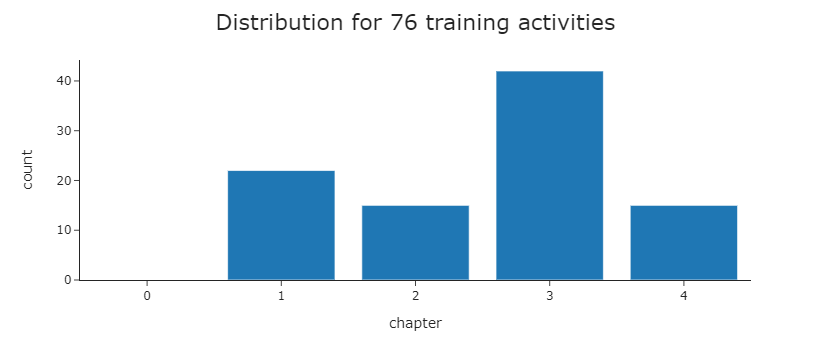

In [263]:
fig = px.bar(get_arr(small))
fig.update_xaxes(title_text='chapter')
fig.update_yaxes(title_text='count')
fig.update_layout(layout, showlegend=False, title_text="Distribution for 76 training activities")

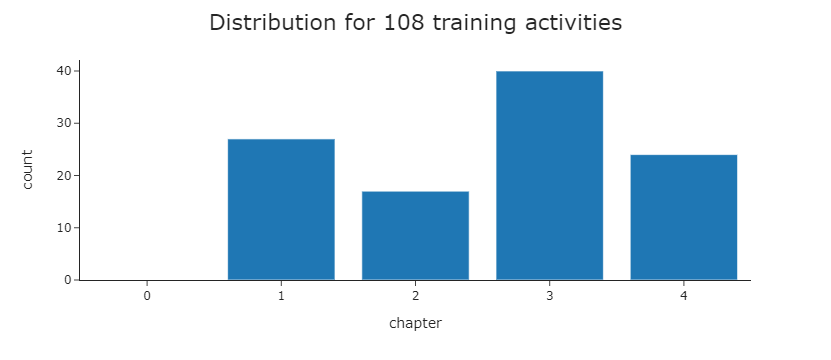

In [264]:
fig = px.bar(get_arr(big))
fig.update_xaxes(title_text='chapter')
fig.update_yaxes(title_text='count')
fig.update_layout(layout, showlegend=False, title_text="Distribution for 108 training activities")
fig

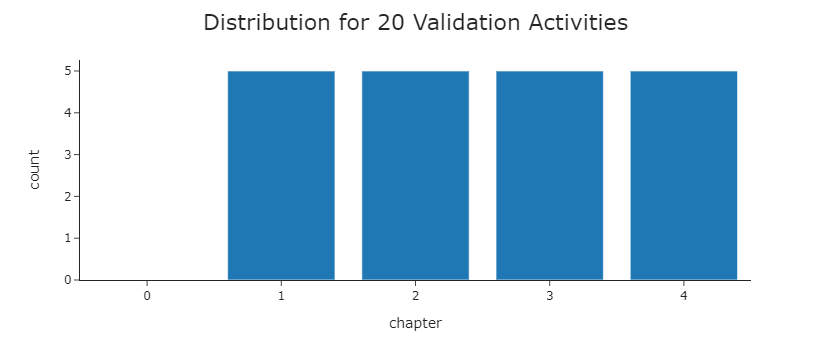

In [265]:
fig = px.bar(get_arr(val))
fig.update_xaxes(title_text='chapter')
fig.update_yaxes(title_text='count')
fig.update_layout(layout, showlegend=False, title_text='Distribution for 20 Validation Activities')
fig